In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import polars as pl
import matplotlib.pyplot as plt
from matplotlib import pyplot

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [3]:
# import all lagged data
df_lagged_added_stats_sa199m2e = pd.read_csv('sa199m2e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa196m2e = pd.read_csv('sa196m2e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa196m1e = pd.read_csv('sa196m1e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa198m2e = pd.read_csv('sa198m2e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa196m3e = pd.read_csv('sa196m3e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa199m3e = pd.read_csv('sa199m3e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa199m1e = pd.read_csv('sa199m1e_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa78m1 = pd.read_csv('sa78m1_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa78m3 = pd.read_csv('sa78m3_new_newest_lagged_added_stats.csv')
df_lagged_added_stats_sa78m5 = pd.read_csv('sa78m5_new_newest_lagged_added_stats.csv')

In [4]:
grouped_lagged_added_stats = pd.concat([df_lagged_added_stats_sa199m2e,df_lagged_added_stats_sa196m2e,
df_lagged_added_stats_sa196m1e,df_lagged_added_stats_sa198m2e,df_lagged_added_stats_sa196m3e,df_lagged_added_stats_sa199m3e,
df_lagged_added_stats_sa199m1e,df_lagged_added_stats_sa78m1,df_lagged_added_stats_sa78m3,df_lagged_added_stats_sa78m5]).iloc[:,1:]

In [5]:
grouped_lagged_added_stats_ri = grouped_lagged_added_stats.reset_index(drop=True)

# Low 127(failed a new 4th - _2, _3) vs High 192 (did a new 4th - 23, _4, _5)
# including lag3

In [4973]:
grouped_lagged_added_stats_ri_low = grouped_lagged_added_stats_ri[(grouped_lagged_added_stats_ri['Choice Output']==2) | ((grouped_lagged_added_stats_ri['Choice Output']==3) & (grouped_lagged_added_stats_ri['lagged_1_choice_ago']>2))]

In [4974]:
grouped_lagged_added_stats_ri_low['Binary'] = 0

C:\Users\Josue Regalado\AppData\Local\Temp\ipykernel_32180\24646402.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grouped_lagged_added_stats_ri_low['Binary'] = 0


In [4975]:
grouped_lagged_added_stats_ri_low

,Middle Duration,lagged_1_mid_duration,lagged_2_mid_duration,lagged_3_mid_duration,lagged_4_mid_duration,Middle Nose Movement,lagged_1_mid_nose_mov,lagged_2_mid_nose_mov,lagged_3_mid_nose_mov,lagged_4_mid_nose_mov,...,mean_2_past_exitmidentry_duration,mean_3_past_exitmidentry_duration,mean_4_past_exitmidentry_duration,mean_5_past_exitmidentry_duration,Choice Output,lagged_1_choice_ago,lagged_2_choice_ago,lagged_3_choice_ago,lagged_4_choice_ago,Binary
0,0.395349,0.279070,0.441860,0.000000,0.000000,0.499066,0.443050,0.375489,0.000000,0.000000,...,0.472222,0.518519,0.496528,0.397222,3,4,3,2,1,0
1,0.302326,0.395349,0.279070,0.441860,0.000000,0.291543,0.499066,0.443050,0.375489,0.000000,...,0.458333,0.462963,0.500000,0.486111,3,3,4,3,2,0
3,0.139535,0.279070,0.302326,0.395349,0.279070,0.226293,0.239721,0.291543,0.499066,0.443050,...,0.465278,0.458333,0.461806,0.463889,3,4,3,3,4,0
4,0.139535,0.139535,0.279070,0.302326,0.395349,0.212414,0.226293,0.239721,0.291543,0.499066,...,0.541667,0.527778,0.506944,0.500000,3,3,4,3,3,0
5,0.255814,0.139535,0.139535,0.279070,0.302326,0.470011,0.212414,0.226293,0.239721,0.291543,...,0.597222,0.541667,0.531250,0.513889,2,3,3,4,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,0.292453,0.485849,0.117925,0.089623,0.000000,0.305776,0.296705,0.183453,0.113333,0.011136,...,0.397106,0.330118,0.284566,0.248875,3,3,2,4,4,0
305,0.084906,0.075472,0.037736,0.014151,0.061321,0.163662,0.134791,0.049044,0.025347,0.113172,...,0.196141,0.161844,0.142283,0.145338,3,5,5,5,5,0
309,0.066038,0.141509,0.037736,0.084906,0.084906,0.096689,0.133200,0.105555,0.121430,0.163662,...,0.147910,0.138264,0.156752,0.160129,3,5,5,4,3,0
310,0.528302,0.066038,0.141509,0.037736,0.084906,0.648750,0.096689,0.133200,0.105555,0.121430,...,0.353698,0.295820,0.251608,0.243730,3,3,5,5,4,0


In [4976]:
grouped_lagged_added_stats_ri_high = grouped_lagged_added_stats_ri[(grouped_lagged_added_stats_ri['Choice Output']>3) | ((grouped_lagged_added_stats_ri['Choice Output']==3) & (grouped_lagged_added_stats_ri['lagged_1_choice_ago']==2))]

In [4977]:
grouped_lagged_added_stats_ri_high['Binary'] = 1

C:\Users\Josue Regalado\AppData\Local\Temp\ipykernel_32180\2828041089.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grouped_lagged_added_stats_ri_high['Binary'] = 1


In [4978]:
grouped_lagged_added_stats_ri_high

,Middle Duration,lagged_1_mid_duration,lagged_2_mid_duration,lagged_3_mid_duration,lagged_4_mid_duration,Middle Nose Movement,lagged_1_mid_nose_mov,lagged_2_mid_nose_mov,lagged_3_mid_nose_mov,lagged_4_mid_nose_mov,...,mean_2_past_exitmidentry_duration,mean_3_past_exitmidentry_duration,mean_4_past_exitmidentry_duration,mean_5_past_exitmidentry_duration,Choice Output,lagged_1_choice_ago,lagged_2_choice_ago,lagged_3_choice_ago,lagged_4_choice_ago,Binary
2,0.279070,0.302326,0.395349,0.279070,0.441860,0.239721,0.291543,0.499066,0.443050,0.375489,...,0.472222,0.472222,0.472222,0.500000,4,3,3,4,3,1
6,0.488372,0.255814,0.139535,0.139535,0.279070,0.516920,0.470011,0.212414,0.226293,0.239721,...,0.555556,0.587963,0.548611,0.538889,3,2,3,3,4,1
8,0.255814,0.279070,0.488372,0.255814,0.139535,0.460563,0.431110,0.516920,0.470011,0.212414,...,0.402778,0.458333,0.479167,0.513889,4,3,3,2,3,1
12,0.139535,0.139535,0.255814,0.116279,0.255814,0.261105,0.320118,0.378745,0.263726,0.460563,...,0.354167,0.356481,0.347222,0.355556,3,2,2,2,4,1
13,0.511628,0.139535,0.139535,0.255814,0.116279,0.493775,0.261105,0.320118,0.378745,0.263726,...,0.506944,0.449074,0.427083,0.405556,4,3,2,2,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,0.070755,0.028302,0.023585,0.891509,0.103774,0.135402,0.059617,0.074648,1.000000,0.161598,...,0.112540,0.108253,0.299839,0.272669,4,4,5,4,4,1
316,0.009434,0.070755,0.028302,0.023585,0.891509,0.029302,0.135402,0.059617,0.074648,1.000000,...,0.114148,0.108253,0.106109,0.259807,5,4,4,5,4,1
317,0.004717,0.009434,0.070755,0.028302,0.023585,0.016390,0.029302,0.135402,0.059617,0.074648,...,0.120579,0.123258,0.116559,0.113183,4,5,4,4,5,1
318,0.150943,0.004717,0.009434,0.070755,0.028302,0.224511,0.016390,0.029302,0.135402,0.059617,...,0.217042,0.177921,0.165595,0.151768,4,4,5,4,4,1


In [4979]:
grouped_lagged_lowhigh_dt = pd.concat([grouped_lagged_added_stats_ri_low, grouped_lagged_added_stats_ri_high])

In [4729]:
grouped_lagged_lowhigh_dt_ri = grouped_lagged_lowhigh_dt.reset_index(drop=True)

In [4730]:
x_lowhigh_main= grouped_lagged_lowhigh_dt_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'Lagged 3 Cur Coeff', 'Lagged 4 Cur Coeff', 
        'New Lagged 3 Cur Coeff', 'New Lagged 4 Cur Coeff',                                          
       'Lagged 3 Cur Coeff Time Proportional',                                               
         'Lagged 4 Cur Coeff Time Proportional',
       'New Lagged 3 Cur Coeff Time Proportional',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional',
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff', 'Lagged 3 Cur Coeff Time Proportional','New Lagged 3 Cur Coeff Time Proportional'                                                      
                                                        ])


In [4731]:
x_lowhigh_main.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'lagged_4_mid_duration',
       'Middle Nose Movement', 'lagged_1_mid_nose_mov',
       'lagged_2_mid_nose_mov', 'lagged_3_mid_nose_mov',
       'lagged_4_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'lagged_4_mid_nose_vel',
       'Middle Tail Movement', 'lagged_1_mid_tail_mov',
       'lagged_2_mid_tail_mov', 'lagged_3_mid_tail_mov',
       'lagged_4_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'lagged_4_mid_tail_vel', 'Middle Tortuosity',
       'lagged_1_mid_tortuosity', 'lagged_2_mid_tortuosity',
       'lagged_3_mid_tortuosity', 'lagged_4_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'lagged_4_current_coeff', 'New Current Coeff',
  

In [4732]:
x_lh = x_lowhigh_main.values

In [4733]:
y_lh = grouped_lagged_lowhigh_dt_ri['Binary'].values

In [4734]:
X_train_lh, X_test_lh, y_train_lh, y_test_lh = train_test_split(x_lh, y_lh, test_size=0.2, random_state=5)

In [4735]:
mod_lh =  GradientBoostingClassifier(n_estimators = 10000, learning_rate = 0.12, n_iter_no_change=20, random_state=57)
mod_lh.fit(X_train_lh, y_train_lh)
y_pred_lh=mod_lh.predict(X_test_lh)

In [4736]:
mod_lh.n_estimators_

31

In [4737]:
target_names = ['0', '1']

In [4738]:
f1_sc_lh = f1_score(y_test_lh, y_pred_lh, average = 'weighted')
f1_sc_lh

0.5563098495212038

In [4739]:
p_sc_lh = precision_score(y_test_lh, y_pred_lh, average = 'weighted')
p_sc_lh

0.5575328535669587

In [4740]:
cf_matrix_lh = confusion_matrix(y_test_lh, y_pred_lh)
cf_matrix_lh

array([[ 8, 18],
       [ 9, 29]], dtype=int64)

In [4741]:
print(classification_report(y_test_lh, y_pred_lh, target_names=target_names))

              precision    recall  f1-score   support

           0       0.47      0.31      0.37        26
           1       0.62      0.76      0.68        38

    accuracy                           0.58        64
   macro avg       0.54      0.54      0.53        64
weighted avg       0.56      0.58      0.56        64



In [4742]:
from sklearn.inspection import permutation_importance

In [4743]:
def plot_permutation_importance(clf, X, y, col, ax):
    result = permutation_importance(clf, X, y, n_repeats=30, random_state=0, n_jobs=2)
    perm_sorted_idx = result.importances_mean.argsort()

    # `labels` argument in boxplot is deprecated in matplotlib 3.9 and has been
    # renamed to `tick_labels`. The following code handles this, but as a
    # scikit-learn user you probably can write simpler code by using `labels=...`
    # (matplotlib < 3.9) or `tick_labels=...` (matplotlib >= 3.9).
    tick_labels_parameter_name = (
        "tick_labels"
        #if parse_version(matplotlib.__version__) >= parse_version("3.9")
        #else "labels"
    )
    tick_labels_dict = {tick_labels_parameter_name: col.columns[perm_sorted_idx]}
    ax.boxplot(result.importances[perm_sorted_idx].T, vert=False)
    ax.set_yticklabels(col.columns[perm_sorted_idx])
    ax.axvline(x=0, color="k", linestyle="--")
    return ax

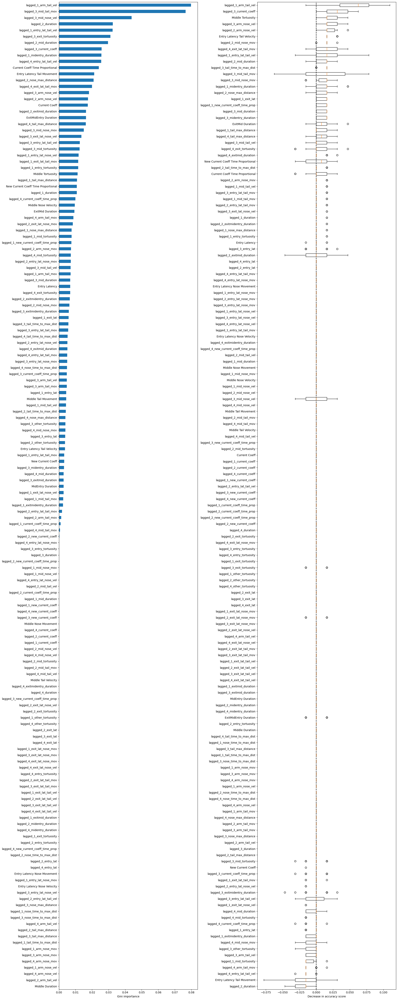

In [4744]:
mdi_importances_bin= pd.Series(mod_lh.feature_importances_, index=x_lowhigh_main.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_lh.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_lh, X_test_lh, y_test_lh, x_lowhigh_main,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [74]:
# try tuning part2

In [387]:
X_train_lhTT2, X_test_lhTT2, y_train_lhTT2, y_test_lhTT2 = train_test_split(x_lh, y_lh, stratify=y_lh, random_state=9)

In [388]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [389]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [390]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [391]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [392]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -5],  # -1 gain for false positives (when a high is classified as low)
            [-8, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [393]:
mod_lhTT2 = GradientBoostingClassifier(n_estimators = 10000, learning_rate = 0.01, n_iter_no_change=100, random_state=57)

In [394]:
mod_lhTT2.fit(X_train_lhTT2, y_train_lhTT2)

GradientBoostingClassifier(learning_rate=0.01, n_estimators=10000,
                           n_iter_no_change=100, random_state=57)

[[42  6]
 [25  7]]


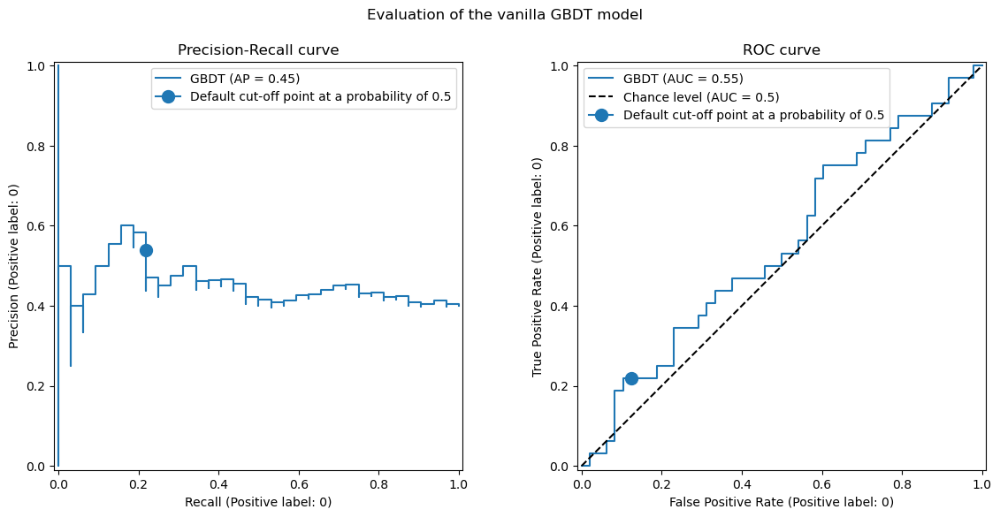

In [395]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_lhTT2, X_test_lhTT2, y_test_lhTT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    scoring["precision"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_lhTT2,
    X_test_lhTT2,
    y_test_lhTT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    scoring["tpr"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [396]:
print(f"Business defined metric: {scoring['credit_gain'](mod_lhTT2, X_test_lhTT2, y_test_lhTT2)}")

[[42  6]
 [25  7]]
Business defined metric: -230


In [397]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [398]:
tuned_model_lhTT2 = TunedThresholdClassifierCV(
    estimator=mod_lhTT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_lhTT2.fit(X_train_lhTT2, y_train_lhTT2)
print(f"{tuned_model_lhTT2.best_threshold_=:0.2f}")

[[ 0 29]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 1 28]
 [ 0 19]]
[[ 2 27]
 [ 0 19]]
[[ 2 27]
 [ 0 19]]
[[ 2 27]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 4 25]
 [ 0 19]]
[[ 4 25]
 [ 1 18]]
[[ 4 25]
 [ 1 18]]
[[ 4 25]
 [ 1 18]]
[[ 4 25]
 [ 1 18]]
[[ 5 24]
 [ 1 18]]
[[ 5 24]
 [ 2 17]]
[[ 6 23]
 [ 2 17]]
[[ 6 23]
 [ 2 17]]
[[ 7 22]
 [ 2 17]]
[[ 9 20]
 [ 2 17]]
[[10 19]
 [ 2 17]]
[[10 19]
 [ 2 17]]
[[10 19]
 [ 2 17]]
[[11 18]
 [ 2 17]]
[[13 16]
 [ 3 16]]
[[13 16]
 [ 3 16]]
[[14 15]
 [ 3 16]]
[[14 15]
 [ 3 16]]
[[15 14]
 [ 4 15]]
[[15 14]
 [ 5 14]]
[[15 14]
 [ 5 14]]
[[16 13]
 [ 5 14]]
[[16 13]
 [ 5 14]]
[[16 13]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[19 10]
 [ 7 12]]
[[19 10]
 [ 7 12]]
[[19 10]
 [ 

In [399]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_lhTT2,
            y_test_lhTT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_lhTT2, y_test_lhTT2),
            scoring["precision"](est, X_test_lhTT2, y_test_lhTT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_lhTT2,
            y_test_lhTT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_lhTT2, y_test_lhTT2),
            scoring["tpr"](est, X_test_lhTT2, y_test_lhTT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[42  6]
 [25  7]]
[[19 29]
 [ 9 23]]


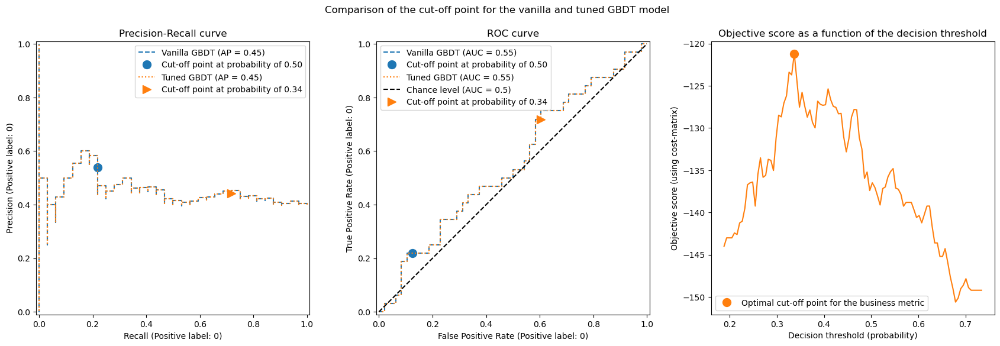

In [400]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_lhTT2, tuned_model_lhTT2, title=title)

In [401]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_lhTT2, X_test_lhTT2, y_test_lhTT2)}")

[[19 29]
 [ 9 23]]
Business defined metric: -217


In [402]:
sum(y_test_lhTT2==0)

32

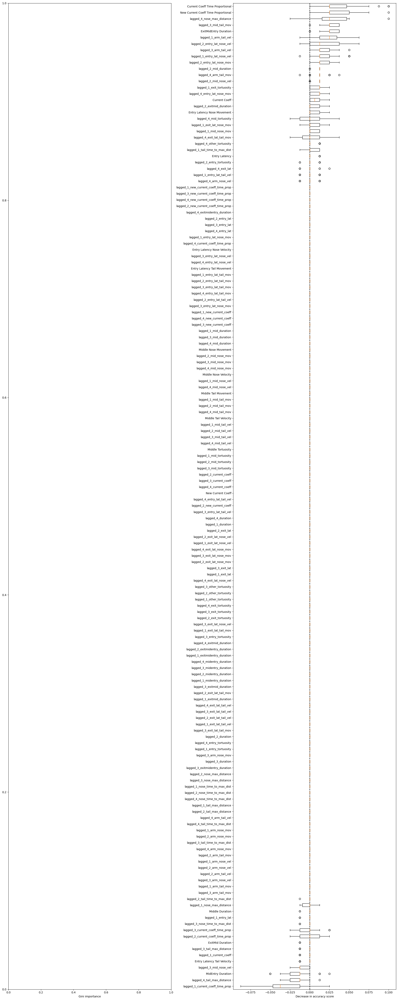

In [403]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_lhTT2, X_test_lhTT2, y_test_lhTT2, x_lowhigh_main,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [4980]:
x_lowhigh_main= grouped_lagged_lowhigh_dt_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       
                                                             
                                                             
                                                             
        'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 
        'lagged_4_new_current_coeff',                                       
        'lagged_4_current_coeff_time_prop',                                         
         
       'lagged_4_new_current_coeff_time_prop',                                            
       
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration',                                                        
                                                          
                                                          
        'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                                          
                                                             
                                                             
        'lagged_3_mid_duration', 
       'lagged_3_mid_nose_mov', 'lagged_3_mid_nose_vel', 
       'lagged_3_mid_tail_mov', 'lagged_3_mid_tail_vel', 'lagged_3_mid_tortuosity',                                              
         'lagged_3_current_coeff', 
        'lagged_3_new_current_coeff',                                       
        'lagged_3_current_coeff_time_prop',                                         
         
       'lagged_3_new_current_coeff_time_prop',                                            
       
       'lagged_3_entry_lat', 'lagged_3_entry_lat_nose_mov',
       'lagged_3_entry_lat_nose_vel', 'lagged_3_entry_lat_tail_mov',
       'lagged_3_entry_lat_tail_vel', 'lagged_3_duration',
       'lagged_3_nose_max_distance', 'lagged_3_nose_time_to_max_dist',
       'lagged_3_tail_max_distance', 'lagged_3_tail_time_to_max_dist',                                         
       'lagged_3_arm_nose_mov', 'lagged_3_arm_nose_vel',                                                 
        'lagged_3_arm_tail_mov', 'lagged_3_arm_tail_vel',
       'lagged_3_entry_tortuosity', 'lagged_3_exit_tortuosity',
       'lagged_3_other_tortuosity', 'lagged_3_exit_lat',
       'lagged_3_exit_lat_nose_mov', 'lagged_3_exit_lat_nose_vel',
       'lagged_3_exit_lat_tail_mov', 'lagged_3_exit_lat_tail_vel',
       'lagged_3_exitmid_duration', 'lagged_3_midentry_duration',
       'lagged_3_exitmidentry_duration',                                                        
                                                          




        'lagged_2_mid_duration', 
       'lagged_2_mid_nose_mov', 'lagged_2_mid_nose_vel', 
       'lagged_2_mid_tail_mov', 'lagged_2_mid_tail_vel', 'lagged_2_mid_tortuosity',                                              
         'lagged_2_current_coeff', 
        'lagged_2_new_current_coeff',                                       
        'lagged_2_current_coeff_time_prop',                                         
         
       'lagged_2_new_current_coeff_time_prop',    

                                                             

                                                             
        'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                                           
                                                             
                                                             
                                                             
                                                             
                                                             
                                                             
                                                             
                                                             
                                                             
                                                             
        'Lagged 3 Cur Coeff', 'Lagged 4 Cur Coeff', 
        'New Lagged 3 Cur Coeff', 'New Lagged 4 Cur Coeff',                                          
       'Lagged 3 Cur Coeff Time Proportional',                                               
         'Lagged 4 Cur Coeff Time Proportional',
       'New Lagged 3 Cur Coeff Time Proportional',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional',
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff', 'Lagged 3 Cur Coeff Time Proportional','New Lagged 3 Cur Coeff Time Proportional'                                                      
                                                        ])


In [4981]:
x_lowhigh_main.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'Middle Tortuosity', 'lagged_1_mid_tortuosity',
       'Current Coeff', 'lagged_1_current_coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'Current Coeff Time Proportional',
       'lagged_1_current_coeff_time_prop',
       'New Current Coeff Time Proportional',
       'lagged_1_new_current_coeff_time_prop', 'Entry Latency',
       'lagged_1_entry_lat', 'lagged_2_entry_lat',
       'Entry Latency Nose Movement', 'lagged_1_entry_lat_nose_mov',
       'lagged_2_entry_lat_nose_mov', 'Entry Latency Nose Velocity',
       'lagged_1_entry_lat_nose_vel', 'lagged_2_entry_lat_nose_vel',
       'Entry Latency Tail Movement', 'lagged_1_entry_lat_tail_mov',
       'lagged_2_entry_lat_tail_mov', 'Entry Latency T

In [4982]:
x_lh = x_lowhigh_main.values

In [4983]:
y_lh = grouped_lagged_lowhigh_dt_ri['Binary'].values

In [4984]:
X_train_lh, X_test_lh, y_train_lh, y_test_lh = train_test_split(x_lh, y_lh, test_size=0.2, stratify = y_lh, random_state=4)

In [4985]:
mod_lh =  GradientBoostingClassifier(n_estimators = 10000, learning_rate = 0.055, n_iter_no_change=5000, random_state=57, max_depth = None)
mod_lh.fit(X_train_lh, y_train_lh)
y_pred_lh=mod_lh.predict(X_test_lh)

In [4986]:
mod_lh.n_estimators_

5324

In [4987]:
target_names = ['0', '1']

In [4988]:
f1_sc_lh = f1_score(y_test_lh, y_pred_lh, average = 'weighted')
f1_sc_lh

0.5724734042553191

In [4989]:
p_sc_lh = precision_score(y_test_lh, y_pred_lh, average = 'weighted')
p_sc_lh

0.5692978896103896

In [4990]:
cf_matrix_lh = confusion_matrix(y_test_lh, y_pred_lh)
cf_matrix_lh

array([[10, 15],
       [12, 27]], dtype=int64)

In [4991]:
print(classification_report(y_test_lh, y_pred_lh, target_names=target_names))

              precision    recall  f1-score   support

           0       0.45      0.40      0.43        25
           1       0.64      0.69      0.67        39

    accuracy                           0.58        64
   macro avg       0.55      0.55      0.55        64
weighted avg       0.57      0.58      0.57        64



In [4992]:
from sklearn.inspection import permutation_importance

In [4993]:
def plot_permutation_importance(clf, X, y, col, ax):
    result = permutation_importance(clf, X, y, n_repeats=30, random_state=0, n_jobs=2)
    perm_sorted_idx = result.importances_mean.argsort()

    # `labels` argument in boxplot is deprecated in matplotlib 3.9 and has been
    # renamed to `tick_labels`. The following code handles this, but as a
    # scikit-learn user you probably can write simpler code by using `labels=...`
    # (matplotlib < 3.9) or `tick_labels=...` (matplotlib >= 3.9).
    tick_labels_parameter_name = (
        "tick_labels"
        #if parse_version(matplotlib.__version__) >= parse_version("3.9")
        #else "labels"
    )
    tick_labels_dict = {tick_labels_parameter_name: col.columns[perm_sorted_idx]}
    ax.boxplot(result.importances[perm_sorted_idx].T, vert=False)
    ax.set_yticklabels(col.columns[perm_sorted_idx])
    ax.axvline(x=0, color="k", linestyle="--")
    return ax

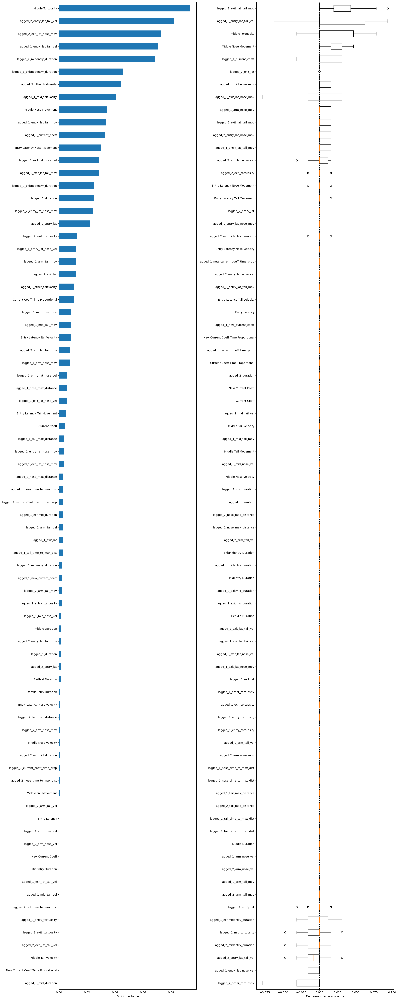

In [4994]:
mdi_importances_bin= pd.Series(mod_lh.feature_importances_, index=x_lowhigh_main.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_lh.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_lh, X_test_lh, y_test_lh, x_lowhigh_main,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [4888]:
# try tuning part2

In [4995]:
X_train_lhTT2, X_test_lhTT2, y_train_lhTT2, y_test_lhTT2 = train_test_split(x_lh, y_lh, stratify=y_lh, random_state=9)

In [4996]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [4997]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [4998]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [4999]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [5022]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -5],  # -1 gain for false positives (when a high is classified as low)
            [-11, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [5023]:
mod_lhTT2 = GradientBoostingClassifier(n_estimators = 10000, learning_rate = 0.02, n_iter_no_change=500, random_state=57, max_depth = 5)

In [5024]:
mod_lhTT2.fit(X_train_lhTT2, y_train_lhTT2)

GradientBoostingClassifier(learning_rate=0.02, max_depth=5, n_estimators=10000,
                           n_iter_no_change=500, random_state=57)

[[39  9]
 [24  8]]


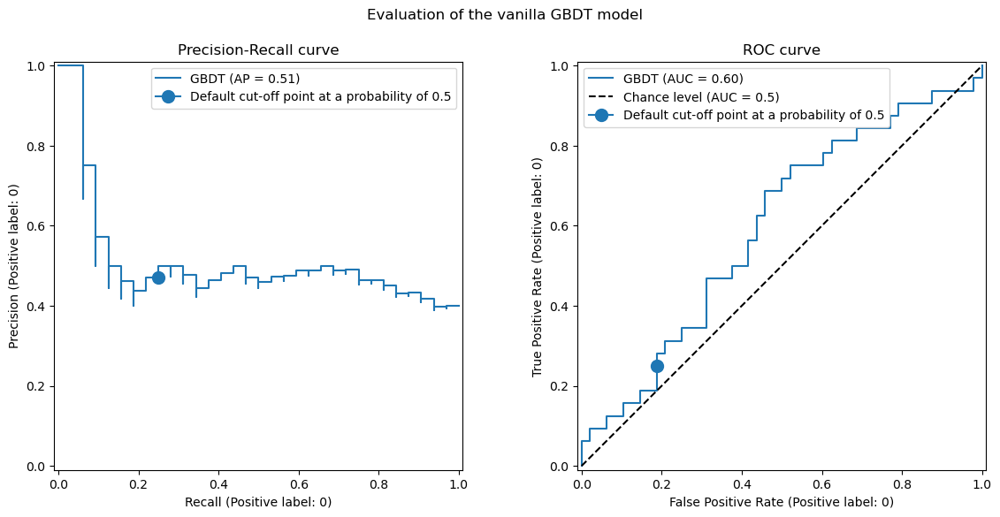

In [5025]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_lhTT2, X_test_lhTT2, y_test_lhTT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    scoring["precision"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_lhTT2,
    X_test_lhTT2,
    y_test_lhTT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    scoring["tpr"](mod_lhTT2, X_test_lhTT2, y_test_lhTT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [5026]:
print(f"Business defined metric: {scoring['credit_gain'](mod_lhTT2, X_test_lhTT2, y_test_lhTT2)}")

[[39  9]
 [24  8]]
Business defined metric: -309


In [5027]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [5028]:
tuned_model_lhTT2 = TunedThresholdClassifierCV(
    estimator=mod_lhTT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_lhTT2.fit(X_train_lhTT2, y_train_lhTT2)
print(f"{tuned_model_lhTT2.best_threshold_=:0.2f}")

[[ 0 29]
 [ 0 19]]
[[ 3 26]
 [ 0 19]]
[[ 5 24]
 [ 1 18]]
[[ 5 24]
 [ 1 18]]
[[ 6 23]
 [ 1 18]]
[[ 8 21]
 [ 1 18]]
[[ 9 20]
 [ 1 18]]
[[10 19]
 [ 1 18]]
[[10 19]
 [ 1 18]]
[[10 19]
 [ 2 17]]
[[10 19]
 [ 2 17]]
[[11 18]
 [ 2 17]]
[[11 18]
 [ 3 16]]
[[11 18]
 [ 5 14]]
[[13 16]
 [ 6 13]]
[[13 16]
 [ 6 13]]
[[13 16]
 [ 6 13]]
[[13 16]
 [ 6 13]]
[[14 15]
 [ 6 13]]
[[15 14]
 [ 6 13]]
[[16 13]
 [ 6 13]]
[[16 13]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 6 13]]
[[17 12]
 [ 8 11]]
[[18 11]
 [ 9 10]]
[[18 11]
 [ 9 10]]
[[18 11]
 [ 9 10]]
[[19 10]
 [ 9 10]]
[[19 10]
 [ 9 10]]
[[19 10]
 [ 9 10]]
[[19 10]
 [ 9 10]]
[[20  9]
 [ 9 10]]
[[20  9]
 [ 9 10]]
[[20  9]
 [10  9]]
[[20  9]
 [10  9]]
[[20  9]
 [11  8]]
[[20  9]
 [11  8]]
[[20  9]
 [12  7]]
[[20  9]
 [12  7]]
[[20  9]
 [12  7]]
[[20  9]
 [12  7]]
[[21  8]
 [12  7]]
[[21  8]
 [12  7]]
[[21  8]
 [12  7]]
[[21  8]
 [12  7]]
[[22  7]
 [12  7]]
[[22  7]
 [1

In [5029]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_lhTT2,
            y_test_lhTT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_lhTT2, y_test_lhTT2),
            scoring["precision"](est, X_test_lhTT2, y_test_lhTT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_lhTT2,
            y_test_lhTT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_lhTT2, y_test_lhTT2),
            scoring["tpr"](est, X_test_lhTT2, y_test_lhTT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[39  9]
 [24  8]]
[[10 38]
 [ 3 29]]


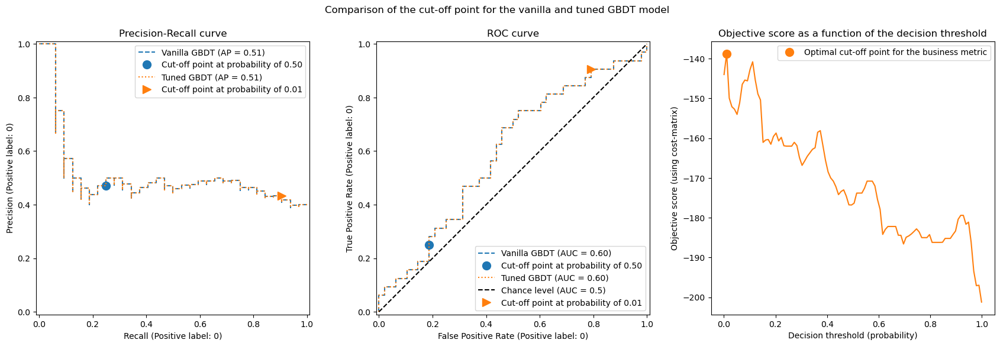

In [5030]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_lhTT2, tuned_model_lhTT2, title=title)

In [4915]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_lhTT2, X_test_lhTT2, y_test_lhTT2)}")

[[18 30]
 [ 6 26]]
Business defined metric: -210


In [4916]:
sum(y_test_lhTT2==0)

32

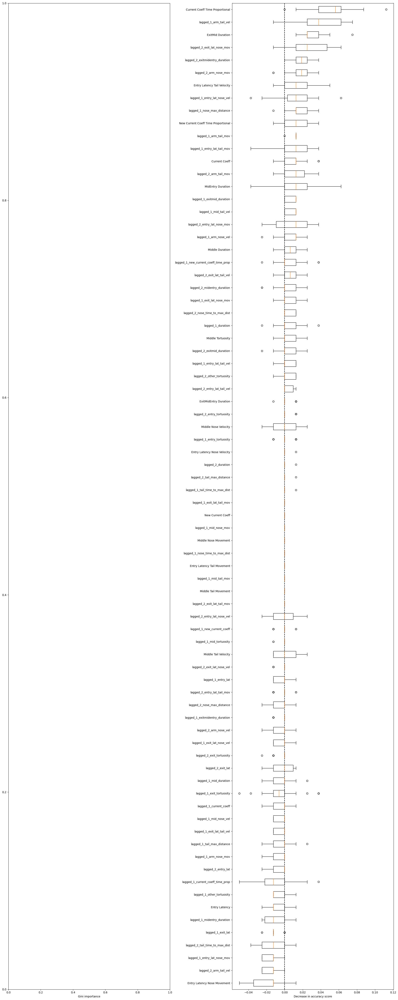

In [4917]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_lhTT2, X_test_lhTT2, y_test_lhTT2, x_lowhigh_main,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _3(111) - are 2s distinguishable from 3s?

In [1291]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [1292]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [1293]:
grouped_lagged_added_stats_ri_3 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==3]

In [1294]:
grouped_lagged_added_stats_ri_3['Binary']=1

In [1295]:
grouped_lagged_binary23 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_3])

In [1296]:
grouped_lagged_binary23_ri = grouped_lagged_binary23.reset_index(drop=True)

In [1297]:
x_main_2v3= grouped_lagged_binary23_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
        'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 3 Cur Coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',  'New Lagged 3 Cur Coeff', 'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop', 'Lagged 3 Cur Coeff Time Proportional',                                               
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop', 'New Lagged 3 Cur Coeff Time Proportional',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional'                                                 
                                                        ])


In [1298]:
x_2v3 = x_main_2v3.values

In [1299]:
y_2v3 = grouped_lagged_binary23_ri['Binary'].values

In [1300]:
X_train_2v3, X_test_2v3, y_train_2v3, y_test_2v3 = train_test_split(x_2v3, y_2v3, test_size=0.2, random_state=5)

In [1301]:
mod_2v3 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.05, validation_fraction=0.1, n_iter_no_change=300, random_state=54)
mod_2v3.fit(X_train_2v3, y_train_2v3)
y_pred_2v3=mod_2v3.predict(X_test_2v3)

In [1302]:
mod_2v3.n_estimators_

301

In [1303]:
target_names = ['0', '1']

In [1304]:
f1_sc_2v3 = f1_score(y_test_2v3, y_pred_2v3, average = 'weighted')
f1_sc_2v3

0.7108886107634542

In [1305]:
p_sc_2v3 = precision_score(y_test_2v3, y_pred_2v3, average = 'weighted')
p_sc_2v3

0.766884531590414

In [1306]:
cf_matrix_2v3 = confusion_matrix(y_test_2v3, y_pred_2v3)
cf_matrix_2v3

array([[ 6,  8],
       [ 1, 19]], dtype=int64)

In [1307]:
print(classification_report(y_test_2v3, y_pred_2v3, target_names=target_names))

              precision    recall  f1-score   support

           0       0.86      0.43      0.57        14
           1       0.70      0.95      0.81        20

    accuracy                           0.74        34
   macro avg       0.78      0.69      0.69        34
weighted avg       0.77      0.74      0.71        34



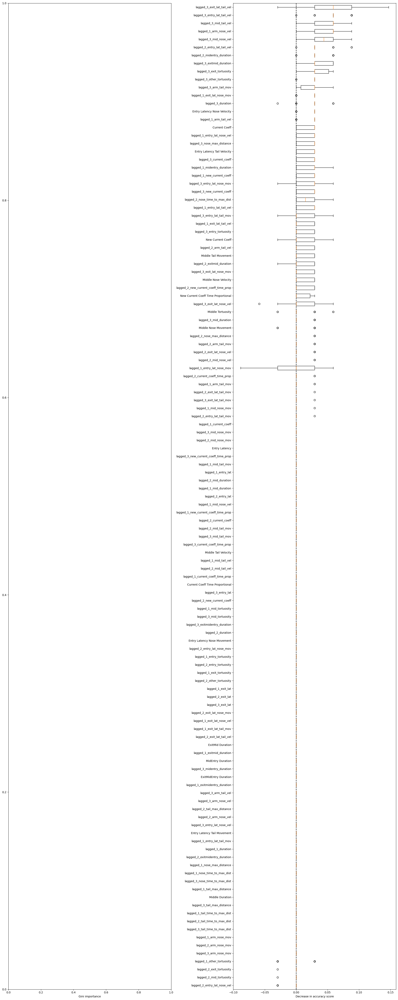

In [1308]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_2v3, X_test_2v3, y_test_2v3, x_main_2v3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [4578]:
from sklearn.linear_model import LogisticRegression

In [4694]:
logr_2v3 =  LogisticRegression(random_state=5, class_weight='balanced', max_iter=10000, penalty = None)
logr_2v3.fit(X_train_2v3, y_train_2v3)
y_pred_logr_2v3=logr_2v3.predict(X_test_2v3)

In [4695]:
y_pred_logr_2v3

array([1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1,
       1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1], dtype=int64)

In [4696]:
target_names = ['2', '3']

In [4697]:
f1_sc_logr_2v3 = f1_score(y_test_2v3, y_pred_logr_2v3, average = 'weighted')
f1_sc_logr_2v3

0.5726381461675579

In [4698]:
p_sc_logr_2v3 = precision_score(y_test_2v3, y_pred_logr_2v3, average = 'weighted')
p_sc_logr_2v3

0.5735294117647058

In [4699]:
cf_matrix_logr_2v3 = confusion_matrix(y_test_2v3, y_pred_logr_2v3)
cf_matrix_logr_2v3

array([[ 5,  9],
       [ 5, 15]], dtype=int64)

In [4693]:
print(classification_report(y_test_2v3, y_pred_logr_2v3, target_names=target_names))

              precision    recall  f1-score   support

           2       0.31      0.29      0.30        14
           3       0.52      0.55      0.54        20

    accuracy                           0.44        34
   macro avg       0.42      0.42      0.42        34
weighted avg       0.43      0.44      0.44        34



In [1309]:
# try tuning part2

In [1310]:
X_train_2v3TT2, X_test_2v3TT2, y_train_2v3TT2, y_test_2v3TT2 = train_test_split(x_2v3, y_2v3, stratify=y_2v3, random_state=55)

In [1311]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [1312]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [1313]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [1314]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [1325]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -4],  # -1 gain for false positives (when a high is classified as low)
            [-9, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [4712]:
mod_2v3TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.005, validation_fraction=0.1, n_iter_no_change=200, random_state=54)

In [4713]:
#mod_2v3TT2 = LogisticRegression(random_state=5, class_weight='balanced', max_iter=10000)

In [4714]:
mod_2v3TT2.fit(X_train_2v3TT2, y_train_2v3TT2)

GradientBoostingClassifier(learning_rate=0.005, n_estimators=1000,
                           n_iter_no_change=200, random_state=54)

[[22  6]
 [ 9  5]]


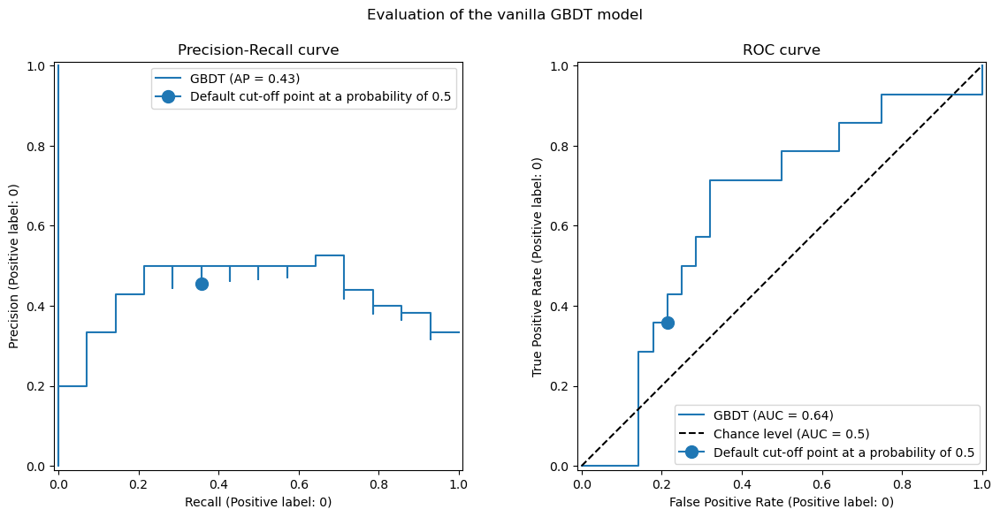

In [4715]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2),
    scoring["precision"](mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_2v3TT2,
    X_test_2v3TT2,
    y_test_2v3TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2),
    scoring["tpr"](mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [4716]:
sum(y_test_2v3TT2==1)

28

In [4717]:
print(f"Business defined metric: {scoring['credit_gain'](mod_2v3TT2, X_test_2v3TT2, y_test_2v3TT2)}")

[[22  6]
 [ 9  5]]
Business defined metric: -639


In [4718]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [4719]:
tuned_model_2v3TT2 = TunedThresholdClassifierCV(
    estimator=mod_2v3TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_2v3TT2.fit(X_train_2v3TT2, y_train_2v3TT2)
print(f"{tuned_model_2v3TT2.best_threshold_=:0.2f}")

[[ 0 17]
 [ 0  9]]
[[ 1 16]
 [ 0  9]]
[[ 1 16]
 [ 0  9]]
[[ 1 16]
 [ 0  9]]
[[ 1 16]
 [ 0  9]]
[[ 1 16]
 [ 0  9]]
[[ 2 15]
 [ 0  9]]
[[ 3 14]
 [ 0  9]]
[[ 3 14]
 [ 0  9]]
[[ 3 14]
 [ 0  9]]
[[ 3 14]
 [ 0  9]]
[[ 4 13]
 [ 0  9]]
[[ 5 12]
 [ 0  9]]
[[ 5 12]
 [ 0  9]]
[[ 5 12]
 [ 0  9]]
[[ 6 11]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[ 7 10]
 [ 0  9]]
[[8 9]
 [0 9]]
[[9 8]
 [0 9]]
[[9 8]
 [0 9]]
[[9 8]
 [0 9]]
[[9 8]
 [0 9]]
[[10  7]
 [ 0  9]]
[[10  7]
 [ 1  8]]
[[10  7]
 [ 1  8]]
[[12  5]
 [ 1  8]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 3  6]]
[[12  5]
 [ 4  5]]
[[12  5]
 [ 4  5]]
[[13  4]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[14  3]
 [ 4  5]]
[[15  2]
 [ 4

In [4720]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_2v3TT2,
            y_test_2v3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_2v3TT2, y_test_2v3TT2),
            scoring["precision"](est, X_test_2v3TT2, y_test_2v3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_2v3TT2,
            y_test_2v3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_2v3TT2, y_test_2v3TT2),
            scoring["tpr"](est, X_test_2v3TT2, y_test_2v3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[22  6]
 [ 9  5]]
[[ 7 21]
 [ 1 13]]


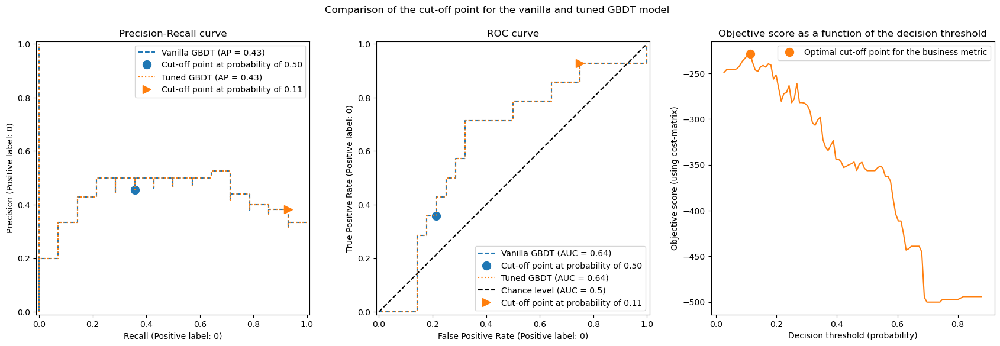

In [4721]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_2v3TT2, tuned_model_2v3TT2, title=title)

In [1335]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_2v3TT2, X_test_2v3TT2, y_test_2v3TT2)}")

[[16 12]
 [ 4 10]]
Business defined metric: -84


In [1336]:
sum(y_test_2v3TT2==0)

14

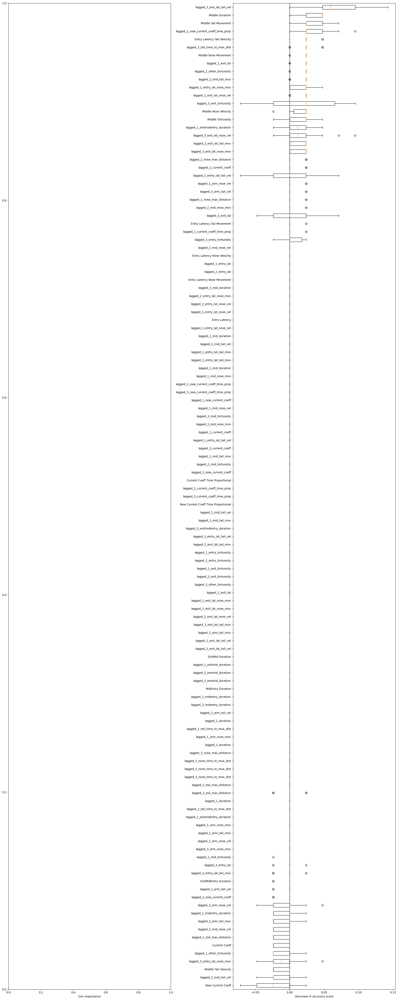

In [1337]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_2v3TT2, X_test_2v3TT2, y_test_2v3TT2, x_main_2v3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _3(70) - are 2s distinguishable from 3s? - excluding 23

In [1338]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [1339]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [1340]:
grouped_lagged_added_stats_ri_e3 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==3)&(grouped_lagged_added_stats_ri['lagged_1_choice_ago']>2)]

In [1341]:
grouped_lagged_added_stats_ri_e3['Binary']=1

In [1342]:
grouped_lagged_binary2e3 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_e3])

In [1343]:
grouped_lagged_binary2e3_ri = grouped_lagged_binary2e3.reset_index(drop=True)

In [1344]:
x_main_2e3= grouped_lagged_binary2e3_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
        'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 3 Cur Coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',  'New Lagged 3 Cur Coeff', 'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop', 'Lagged 3 Cur Coeff Time Proportional',                                               
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop', 'New Lagged 3 Cur Coeff Time Proportional',  'New Lagged 4 Cur Coeff Time Proportional',                                            
      
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
        'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional'                                                
                                                        ])


In [1345]:
x_main_2e3.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'lagged_2_mid_nose_mov',
       'lagged_3_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'lagged_2_mid_tail_mov',
       'lagged_3_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'Middle Tortuosity', 'lagged_1_mid_tortuosity',
       'lagged_2_mid_tortuosity', 'lagged_3_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'lagged_2_new_current_coeff',
       'lagged_3_new_current_coeff', 'Current Coeff Time Proportional',
       'lagged_1_current_coeff_time_prop', 'lagged_2_current_c

In [1346]:
x_2e3 = x_main_2e3.values

In [1347]:
y_2e3 = grouped_lagged_binary2e3_ri['Binary'].values

In [1348]:
X_train_2e3, X_test_2e3, y_train_2e3, y_test_2e3 = train_test_split(x_2e3, y_2e3, test_size=0.2, random_state=5)

In [1375]:
mod_2e3 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.012, validation_fraction=0.1, n_iter_no_change=200, random_state=54)
mod_2e3.fit(X_train_2e3, y_train_2e3)
y_pred_2e3=mod_2e3.predict(X_test_2e3)

In [1376]:
mod_2e3.n_estimators_

222

In [1377]:
target_names = ['0', '1']

In [1378]:
f1_sc_2e3 = f1_score(y_test_2e3, y_pred_2e3, average = 'weighted')
f1_sc_2e3

0.807977207977208

In [1379]:
p_sc_2e3 = precision_score(y_test_2e3, y_pred_2e3, average = 'weighted')
p_sc_2e3

0.8106508875739646

In [1380]:
cf_matrix_2e3 = confusion_matrix(y_test_2e3, y_pred_2e3)
cf_matrix_2e3

array([[11,  3],
       [ 2, 10]], dtype=int64)

In [1381]:
print(classification_report(y_test_2e3, y_pred_2e3, target_names=target_names))

              precision    recall  f1-score   support

           0       0.85      0.79      0.81        14
           1       0.77      0.83      0.80        12

    accuracy                           0.81        26
   macro avg       0.81      0.81      0.81        26
weighted avg       0.81      0.81      0.81        26



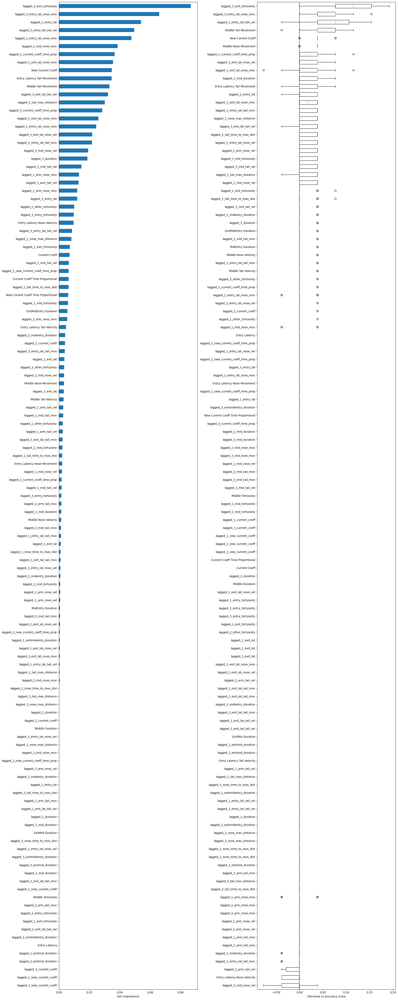

In [1382]:
mdi_importances_bin= pd.Series(mod_2e3.feature_importances_, index=x_main_2e3.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_2e3.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_2e3, X_test_2e3, y_test_2e3, x_main_2e3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [1383]:
# try tuning part2

In [1523]:
X_train_2e3TT2, X_test_2e3TT2, y_train_2e3TT2, y_test_2e3TT2 = train_test_split(x_2e3, y_2e3, stratify=y_2e3, random_state=7)

In [1524]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [1525]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [1526]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [1527]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [1646]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -10],  # -1 gain for false positives (when a high is classified as low)
            [-12, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [1659]:
mod_2e3TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.01, validation_fraction=0.1, n_iter_no_change=300, random_state=54)

In [1660]:
mod_2e3TT2.fit(X_train_2e3TT2, y_train_2e3TT2)

GradientBoostingClassifier(learning_rate=0.01, n_estimators=1000,
                           n_iter_no_change=300, random_state=54)

[[10  8]
 [ 5  9]]


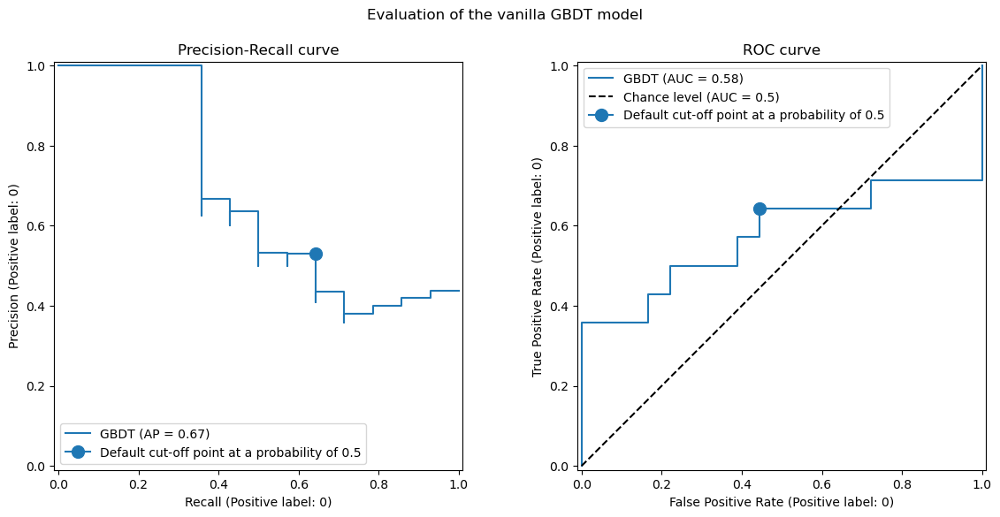

In [1661]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2),
    scoring["precision"](mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_2e3TT2,
    X_test_2e3TT2,
    y_test_2e3TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2),
    scoring["tpr"](mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [1650]:
sum(y_test_2e3TT2==1)

18

In [1651]:
print(f"Business defined metric: {scoring['credit_gain'](mod_2e3TT2, X_test_2e3TT2, y_test_2e3TT2)}")

[[10  8]
 [ 6  8]]
Business defined metric: -152


In [1652]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [1653]:
tuned_model_2e3TT2 = TunedThresholdClassifierCV(
    estimator=mod_2e3TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_2e3TT2.fit(X_train_2e3TT2, y_train_2e3TT2)
print(f"{tuned_model_2e3TT2.best_threshold_=:0.2f}")

[[ 0 11]
 [ 0  8]]
[[ 1 10]
 [ 0  8]]
[[ 1 10]
 [ 0  8]]
[[ 1 10]
 [ 0  8]]
[[ 1 10]
 [ 0  8]]
[[ 1 10]
 [ 0  8]]
[[2 9]
 [0 8]]
[[2 9]
 [0 8]]
[[2 9]
 [0 8]]
[[2 9]
 [0 8]]
[[3 8]
 [0 8]]
[[3 8]
 [0 8]]
[[3 8]
 [0 8]]
[[3 8]
 [0 8]]
[[4 7]
 [0 8]]
[[4 7]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[5 6]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[6 5]
 [0 8]]
[[7 4]
 [0 8]]
[[7 4]
 [0 8]]
[[8 3]
 [0 8]]
[[8 3]
 [1 7]]
[[8 3]
 [1 7]]
[[8 3]
 [1 7]]
[[8 3]
 [2 6]]
[[8 3]
 [2 6]]
[[8 3]
 [2 6]]
[[8 3]
 [2 6]]
[[8 3]
 [2 6]]
[[9 2]
 [2 6]]
[[9 2]
 [2 6]]
[[9 2]
 [2 6]]
[[9 2]
 [2 6]]
[[9 2]
 [2 6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 2  6]]
[[10  1]
 [ 3  5]]
[[10  1]
 [ 3  5]]
[[10  1]
 [ 3  5]]
[[10  1]
 [ 4  4]]
[[10  1]
 [ 4  4]

In [1654]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_2e3TT2,
            y_test_2e3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_2e3TT2, y_test_2e3TT2),
            scoring["precision"](est, X_test_2e3TT2, y_test_2e3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_2e3TT2,
            y_test_2e3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_2e3TT2, y_test_2e3TT2),
            scoring["tpr"](est, X_test_2e3TT2, y_test_2e3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[10  8]
 [ 6  8]]
[[17  1]
 [ 9  5]]


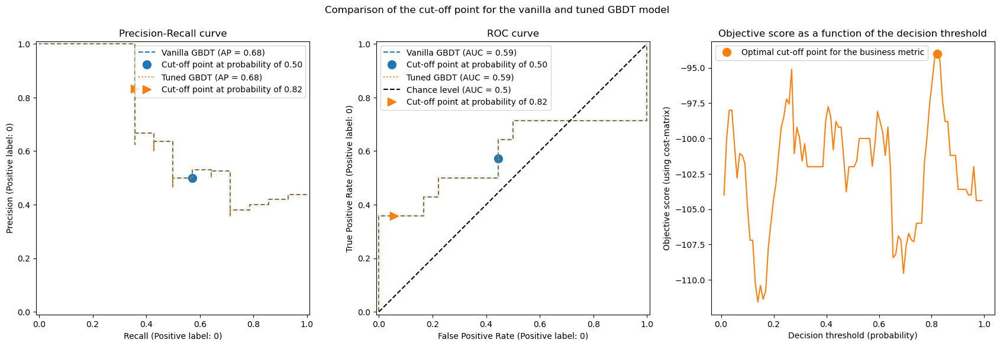

In [1655]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_2e3TT2, tuned_model_2e3TT2, title=title)

In [1656]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_2e3TT2, X_test_2e3TT2, y_test_2e3TT2)}")

[[17  1]
 [ 9  5]]
Business defined metric: -118


In [1657]:
sum(y_test_2e3TT2==0)

14

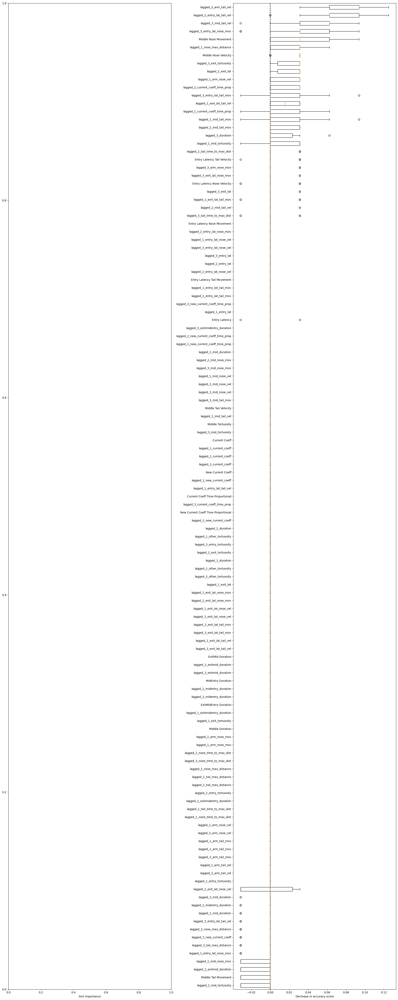

In [1658]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_2e3TT2, X_test_2e3TT2, y_test_2e3TT2, x_main_2e3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# 23(41) vs _3(70) - are 23s distinguishable from other _3s?

In [858]:
grouped_lagged_added_stats_ri_23 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==3)&(grouped_lagged_added_stats_ri['lagged_1_choice_ago']==2)]

In [859]:
grouped_lagged_added_stats_ri_23['Binary']=0

In [860]:
grouped_lagged_added_stats_ri_e3 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==3)&(grouped_lagged_added_stats_ri['lagged_1_choice_ago']>2)]

In [861]:
grouped_lagged_added_stats_ri_e3['Binary']=1

In [862]:
grouped_lagged_binary23e3 = pd.concat([grouped_lagged_added_stats_ri_23, grouped_lagged_added_stats_ri_e3])

In [863]:
grouped_lagged_binary23e3_ri = grouped_lagged_binary23e3.reset_index(drop=True)

In [864]:
x_main_23e3= grouped_lagged_binary23e3_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
        'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 3 Cur Coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',  'New Lagged 3 Cur Coeff', 'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop', 'Lagged 3 Cur Coeff Time Proportional',                                               
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop', 'New Lagged 3 Cur Coeff Time Proportional',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
       'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
        'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional'                                            
                                                        
                                                        ])
#'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional' 

In [865]:
x_23e3 = x_main_23e3.values

In [866]:
y_23e3 = grouped_lagged_binary23e3_ri['Binary'].values

In [867]:
X_train_23e3, X_test_23e3, y_train_23e3, y_test_23e3 = train_test_split(x_23e3, y_23e3, test_size=0.2, random_state=9)

In [891]:
mod_23e3 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.005, validation_fraction=0.1, n_iter_no_change=300, random_state=59)
mod_23e3.fit(X_train_23e3, y_train_23e3)
y_pred_23e3=mod_23e3.predict(X_test_23e3)

In [892]:
mod_23e3.n_estimators_

803

In [893]:
target_names = ['0', '1']

In [894]:
f1_sc_23e3 = f1_score(y_test_23e3, y_pred_23e3, average = 'weighted')
f1_sc_23e3

0.5448464578899361

In [895]:
p_sc_23e3 = precision_score(y_test_23e3, y_pred_23e3, average = 'weighted')
p_sc_23e3

0.6289855072463767

In [896]:
cf_matrix_23e3 = confusion_matrix(y_test_23e3, y_pred_23e3)
cf_matrix_23e3

array([[ 2,  8],
       [ 1, 12]], dtype=int64)

In [897]:
print(classification_report(y_test_23e3, y_pred_23e3, target_names=target_names))

              precision    recall  f1-score   support

           0       0.67      0.20      0.31        10
           1       0.60      0.92      0.73        13

    accuracy                           0.61        23
   macro avg       0.63      0.56      0.52        23
weighted avg       0.63      0.61      0.54        23



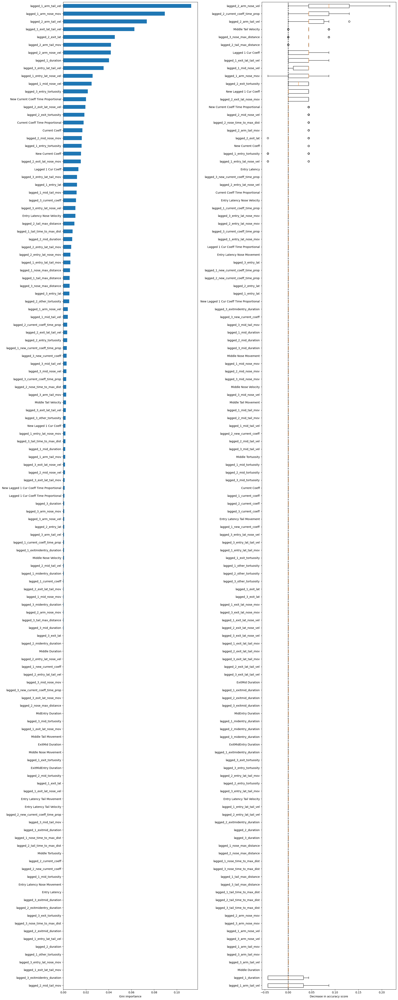

In [898]:
mdi_importances_bin= pd.Series(mod_23e3.feature_importances_, index=x_main_23e3.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_23e3.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_23e3, X_test_23e3, y_test_23e3, x_main_23e3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [6489]:
# try tuning part2

In [899]:
X_train_23e3TT2, X_test_23e3TT2, y_train_23e3TT2, y_test_23e3TT2 = train_test_split(x_23e3, y_23e3, stratify=y_23e3, random_state=55)

In [900]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [901]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [902]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [903]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [1143]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -4],  # -1 gain for false positives (when a high is classified as low)
            [-7, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [1144]:
mod_23e3TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.005, validation_fraction=0.1, n_iter_no_change=300, random_state=59)

In [1145]:
mod_23e3TT2.fit(X_train_23e3TT2, y_train_23e3TT2)

GradientBoostingClassifier(learning_rate=0.005, n_estimators=1000,
                           n_iter_no_change=300, random_state=59)

[[16  2]
 [ 9  1]]


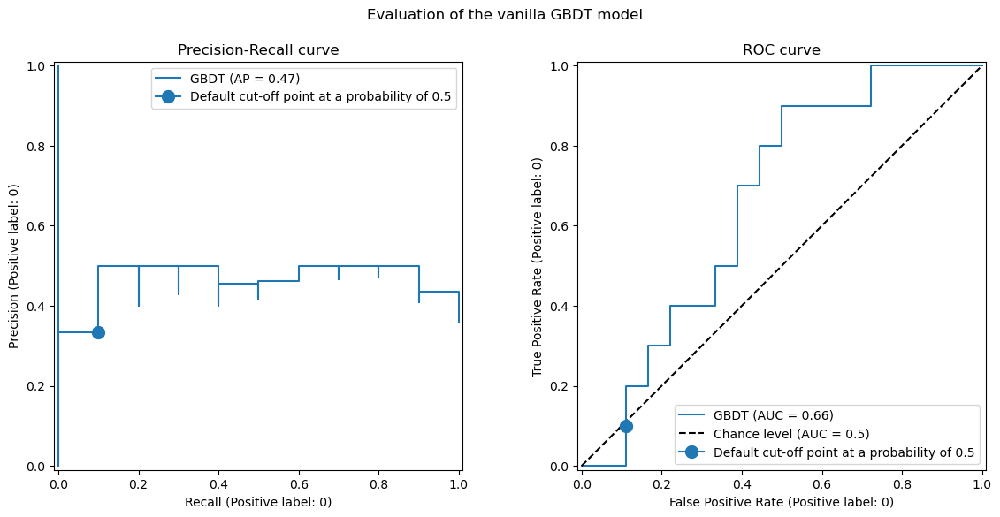

In [1146]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2),
    scoring["precision"](mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_23e3TT2,
    X_test_23e3TT2,
    y_test_23e3TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2),
    scoring["tpr"](mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [1147]:
sum(y_test_23e3TT2==1)

18

In [1148]:
print(f"Business defined metric: {scoring['credit_gain'](mod_23e3TT2, X_test_23e3TT2, y_test_23e3TT2)}")

[[16  2]
 [ 9  1]]
Business defined metric: -71


In [1149]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [1150]:
tuned_model_23e3TT2 = TunedThresholdClassifierCV(
    estimator=mod_23e3TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_23e3TT2.fit(X_train_23e3TT2, y_train_23e3TT2)
print(f"{tuned_model_23e3TT2.best_threshold_=:0.2f}")

[[ 0 11]
 [ 0  6]]
[[3 8]
 [1 5]]
[[3 8]
 [1 5]]
[[5 6]
 [1 5]]
[[5 6]
 [1 5]]
[[5 6]
 [2 4]]
[[5 6]
 [2 4]]
[[5 6]
 [2 4]]
[[5 6]
 [3 3]]
[[5 6]
 [3 3]]
[[5 6]
 [3 3]]
[[5 6]
 [3 3]]
[[5 6]
 [3 3]]
[[5 6]
 [3 3]]
[[6 5]
 [3 3]]
[[6 5]
 [3 3]]
[[6 5]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[7 4]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[8 3]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [3 3]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]
 [4 2]]
[[9 2]

In [1151]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_23e3TT2,
            y_test_23e3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_23e3TT2, y_test_23e3TT2),
            scoring["precision"](est, X_test_23e3TT2, y_test_23e3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_23e3TT2,
            y_test_23e3TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_23e3TT2, y_test_23e3TT2),
            scoring["tpr"](est, X_test_23e3TT2, y_test_23e3TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[16  2]
 [ 9  1]]
[[9 9]
 [2 8]]


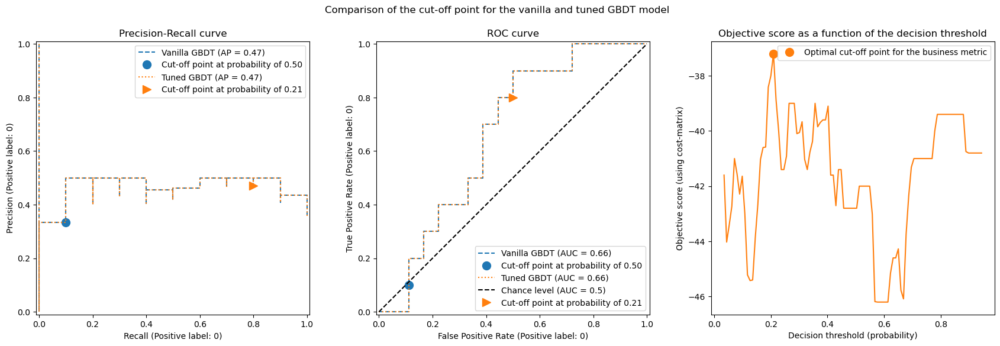

In [1152]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_23e3TT2, tuned_model_23e3TT2, title=title)

In [1153]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_23e3TT2, X_test_23e3TT2, y_test_23e3TT2)}")

[[9 9]
 [2 8]]
Business defined metric: -50


In [1154]:
sum(y_test_23e3TT2==0)

10

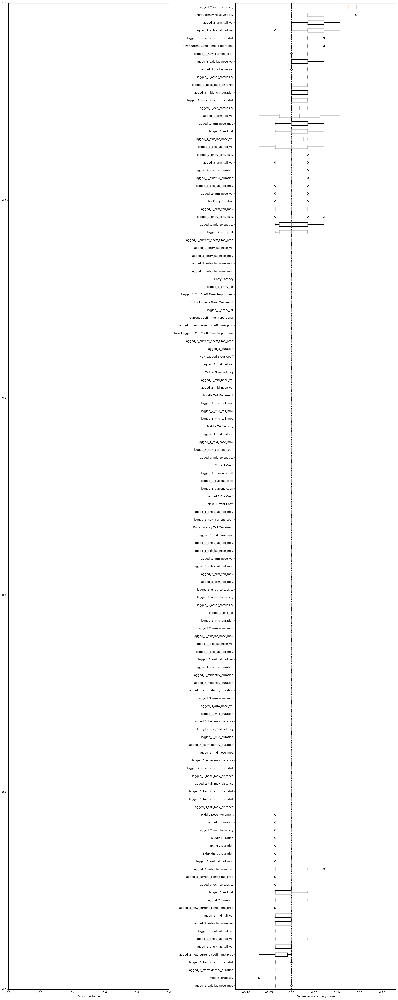

In [1155]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_23e3TT2, X_test_23e3TT2, y_test_23e3TT2, x_main_23e3,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _4(100) - are 2s distinguishable from 4s?

In [1156]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [1157]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [1158]:
grouped_lagged_added_stats_ri_4 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==4]

In [1159]:
grouped_lagged_added_stats_ri_4['Binary']=1

In [1160]:
grouped_lagged_binary24 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_4])

In [1161]:
grouped_lagged_binary24_ri = grouped_lagged_binary24.reset_index(drop=True)

In [1662]:
x_main_24= grouped_lagged_binary24_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'lagged_4_mid_duration',
       'lagged_4_mid_nose_mov','lagged_4_mid_nose_vel',
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',   'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop',                                                
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',

        
                                                      
                                                      
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',
        'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional',
        'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff', 'Lagged 3 Cur Coeff Time Proportional','New Lagged 3 Cur Coeff Time Proportional'
                                                        
                                                        ])

#
# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [1663]:
x_main_24.columns

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'lagged_2_mid_nose_mov',
       'lagged_3_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel',
       ...
       'lagged_2_exitmid_duration', 'lagged_3_exitmid_duration',
       'MidEntry Duration', 'lagged_1_midentry_duration',
       'lagged_2_midentry_duration', 'lagged_3_midentry_duration',
       'ExitMidEntry Duration', 'lagged_1_exitmidentry_duration',
       'lagged_2_exitmidentry_duration', 'lagged_3_exitmidentry_duration'],
      dtype='object', length=123)

In [1664]:
x_24 = x_main_24.values

In [1665]:
y_24 = grouped_lagged_binary24_ri['Binary'].values

In [1666]:
X_train_24, X_test_24, y_train_24, y_test_24 = train_test_split(x_24, y_24, test_size=0.2, random_state=5)

In [1778]:
mod_24 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.07, validation_fraction=0.1, n_iter_no_change=400, random_state=54)
mod_24.fit(X_train_24, y_train_24)
y_pred_24=mod_24.predict(X_test_24)

In [1779]:
mod_24.n_estimators_

405

In [1780]:
target_names = ['0', '1']

In [1781]:
f1_sc_24 = f1_score(y_test_24, y_pred_24, average = 'weighted')
f1_sc_24

0.6529692470837751

In [1782]:
p_sc_24 = precision_score(y_test_24, y_pred_24, average = 'weighted')
p_sc_24

0.650974025974026

In [1783]:
cf_matrix_24 = confusion_matrix(y_test_24, y_pred_24)
cf_matrix_24

array([[ 6,  6],
       [ 5, 15]], dtype=int64)

In [1784]:
print(classification_report(y_test_24, y_pred_24, target_names=target_names))

              precision    recall  f1-score   support

           0       0.55      0.50      0.52        12
           1       0.71      0.75      0.73        20

    accuracy                           0.66        32
   macro avg       0.63      0.62      0.63        32
weighted avg       0.65      0.66      0.65        32



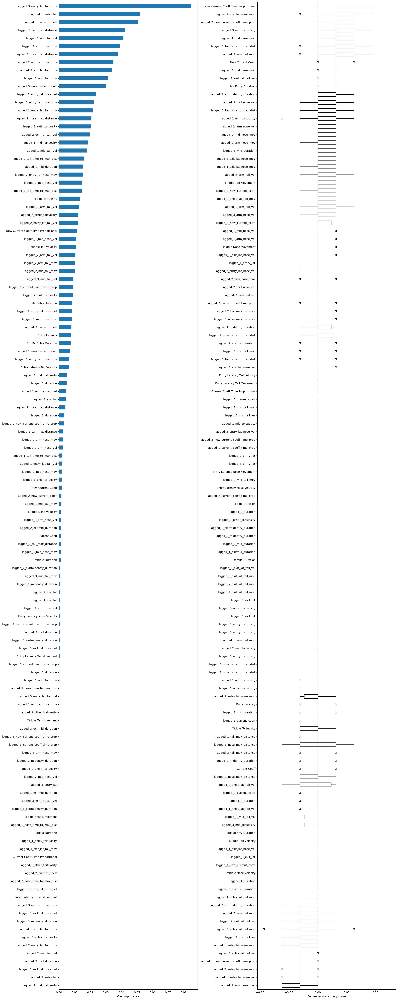

In [1838]:
mdi_importances_bin= pd.Series(mod_24.feature_importances_, index=x_main_24.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_24.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_24, X_test_24, y_test_24, x_main_24,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [1786]:
# try tuning part2

In [1820]:
X_train_24TT2, X_test_24TT2, y_train_24TT2, y_test_24TT2 = train_test_split(x_24, y_24, stratify=y_24, random_state=5)

In [1821]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [1822]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [1823]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [1824]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [1825]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -3],  # -1 gain for false positives (when a high is classified as low)
            [-5, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [1826]:
mod_24TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.05, validation_fraction=0.1, n_iter_no_change=300, random_state=54)

In [1827]:
mod_24TT2.fit(X_train_24TT2, y_train_24TT2)

GradientBoostingClassifier(learning_rate=0.05, n_estimators=1000,
                           n_iter_no_change=300, random_state=54)

[[18  7]
 [10  5]]


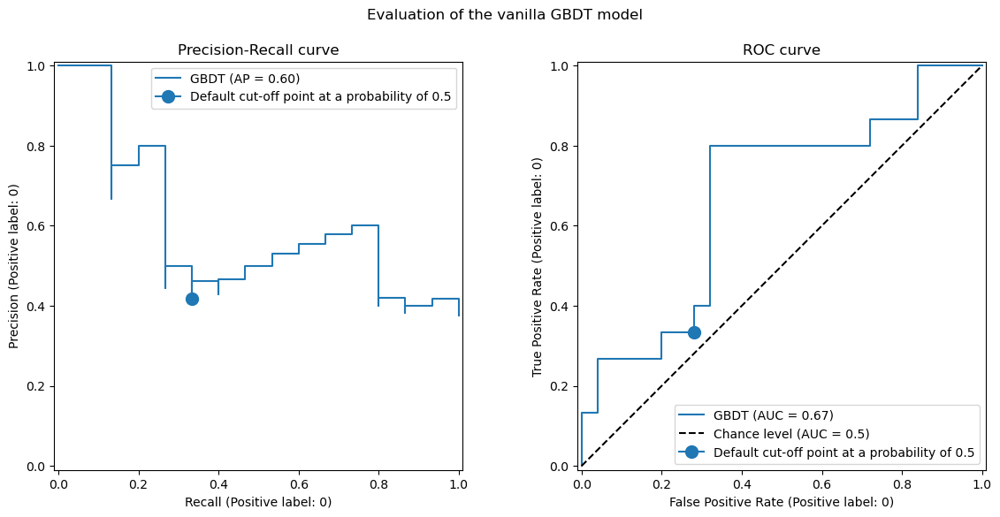

In [1828]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_24TT2, X_test_24TT2, y_test_24TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_24TT2, X_test_24TT2, y_test_24TT2),
    scoring["precision"](mod_24TT2, X_test_24TT2, y_test_24TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_24TT2,
    X_test_24TT2,
    y_test_24TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_24TT2, X_test_24TT2, y_test_24TT2),
    scoring["tpr"](mod_24TT2, X_test_24TT2, y_test_24TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [1829]:
sum(y_test_24TT2==1)

25

In [1830]:
print(f"Business defined metric: {scoring['credit_gain'](mod_24TT2, X_test_24TT2, y_test_24TT2)}")

[[18  7]
 [10  5]]
Business defined metric: -71


In [1831]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [1832]:
tuned_model_24TT2 = TunedThresholdClassifierCV(
    estimator=mod_24TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_24TT2.fit(X_train_24TT2, y_train_24TT2)
print(f"{tuned_model_24TT2.best_threshold_=:0.2f}")

[[ 0 15]
 [ 0  9]]
[[8 7]
 [4 5]]
[[9 6]
 [4 5]]
[[10  5]
 [ 4  5]]
[[10  5]
 [ 4  5]]
[[10  5]
 [ 4  5]]
[[10  5]
 [ 4  5]]
[[11  4]
 [ 4  5]]
[[11  4]
 [ 4  5]]
[[12  3]
 [ 4  5]]
[[12  3]
 [ 4  5]]
[[12  3]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[13  2]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 4  5]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[[14  1]
 [ 5  4]]
[

In [1833]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_24TT2,
            y_test_24TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_24TT2, y_test_24TT2),
            scoring["precision"](est, X_test_24TT2, y_test_24TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_24TT2,
            y_test_24TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_24TT2, y_test_24TT2),
            scoring["tpr"](est, X_test_24TT2, y_test_24TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[18  7]
 [10  5]]
[[17  8]
 [ 3 12]]


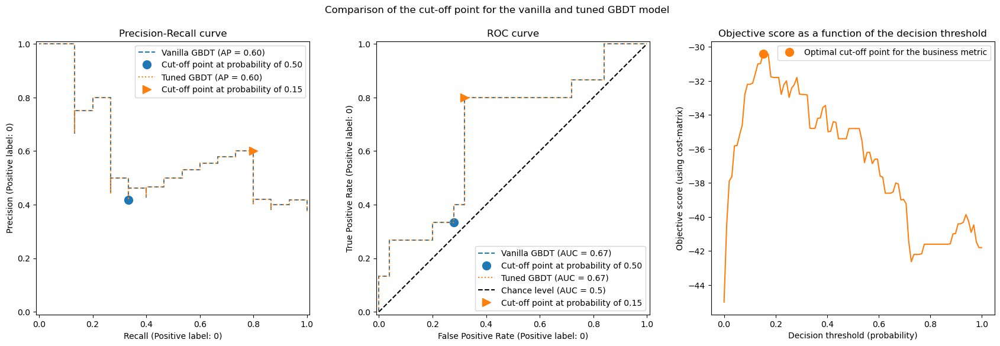

In [1834]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_24TT2, tuned_model_24TT2, title=title)

In [1835]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_24TT2, X_test_24TT2, y_test_24TT2)}")

[[17  8]
 [ 3 12]]
Business defined metric: -39


In [1836]:
sum(y_test_24TT2==0)

15

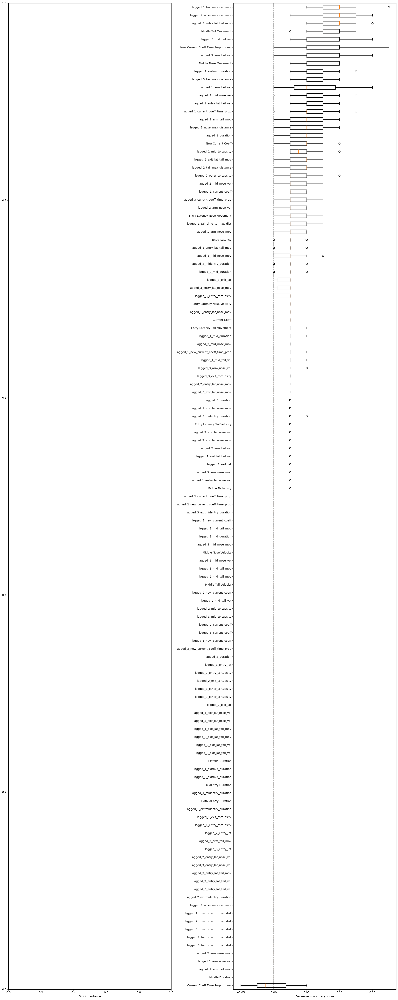

In [1837]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_24TT2, X_test_24TT2, y_test_24TT2, x_main_24,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _4(100), _5(51) - are 2s distinguishable from 4s and 5s?

In [1861]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [1862]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [1863]:
grouped_lagged_added_stats_ri_45 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']>3]

In [1864]:
grouped_lagged_added_stats_ri_45['Binary']=1

In [1865]:
grouped_lagged_binary245 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_45])

In [1866]:
grouped_lagged_binary245_ri = grouped_lagged_binary245.reset_index(drop=True)

In [1867]:
x_main_245= grouped_lagged_binary245_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'lagged_4_mid_duration',
       'lagged_4_mid_nose_mov','lagged_4_mid_nose_vel',
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',   'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop',                                                
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional','New Lagged 1 Cur Coeff Time Proportional',                                                  
        'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff', 'Lagged 3 Cur Coeff Time Proportional','New Lagged 3 Cur Coeff Time Proportional'                                                ])

#
# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [1868]:
x_main_245.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'lagged_2_mid_nose_mov',
       'lagged_3_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'lagged_2_mid_tail_mov',
       'lagged_3_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'Middle Tortuosity', 'lagged_1_mid_tortuosity',
       'lagged_2_mid_tortuosity', 'lagged_3_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'lagged_2_new_current_coeff',
       'lagged_3_new_current_coeff', 'Current Coeff Time Proportional',
       'lagged_1_current_coeff_time_prop', 'lagged_2_current_c

In [1869]:
x_245 = x_main_245.values

In [1870]:
y_245 = grouped_lagged_binary245_ri['Binary'].values

In [1871]:
X_train_245, X_test_245, y_train_245, y_test_245 = train_test_split(x_245, y_245, test_size=0.2, random_state=5)

In [1998]:
mod_245 =  GradientBoostingClassifier(n_estimators = 1000, learning_rate = 0.07, validation_fraction=0.1, n_iter_no_change=400, random_state=54)
mod_245.fit(X_train_245, y_train_245)
y_pred_245=mod_245.predict(X_test_245)

In [1999]:
mod_245.n_estimators_

401

In [2000]:
target_names = ['0', '1']

In [2001]:
f1_sc_245 = f1_score(y_test_245, y_pred_245, average = 'weighted')
f1_sc_245

0.5797619047619048

In [2002]:
p_sc_245 = precision_score(y_test_245, y_pred_245, average = 'weighted')
p_sc_245

0.5619047619047619

In [2003]:
cf_matrix_245 = confusion_matrix(y_test_245, y_pred_245)
cf_matrix_245

array([[ 2, 11],
       [ 5, 24]], dtype=int64)

In [2004]:
print(classification_report(y_test_245, y_pred_245, target_names=target_names))

              precision    recall  f1-score   support

           0       0.29      0.15      0.20        13
           1       0.69      0.83      0.75        29

    accuracy                           0.62        42
   macro avg       0.49      0.49      0.47        42
weighted avg       0.56      0.62      0.58        42



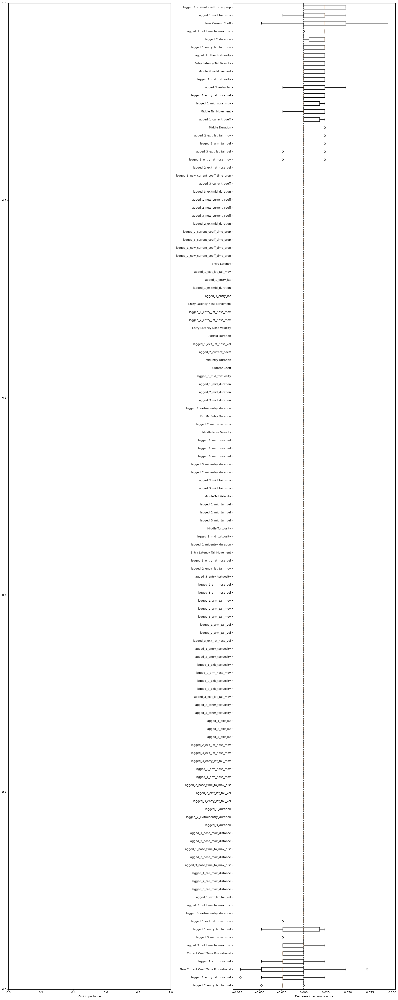

In [2005]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_245, X_test_245, y_test_245, x_main_245,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [4899]:
# try tuning part2

In [2006]:
X_train_245TT2, X_test_245TT2, y_train_245TT2, y_test_245TT2 = train_test_split(x_245, y_245, stratify=y_245, random_state=55)

In [2007]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [2008]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [2009]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [2010]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [2035]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -1],  # -1 gain for false positives (when a high is classified as low)
            [-3, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [2048]:
mod_245TT2 = GradientBoostingClassifier(n_estimators = 1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=500, random_state=54)

In [2049]:
mod_245TT2.fit(X_train_245TT2, y_train_245TT2)

GradientBoostingClassifier(learning_rate=0.015, n_estimators=1000,
                           n_iter_no_change=500, random_state=54)

[[35  3]
 [12  2]]


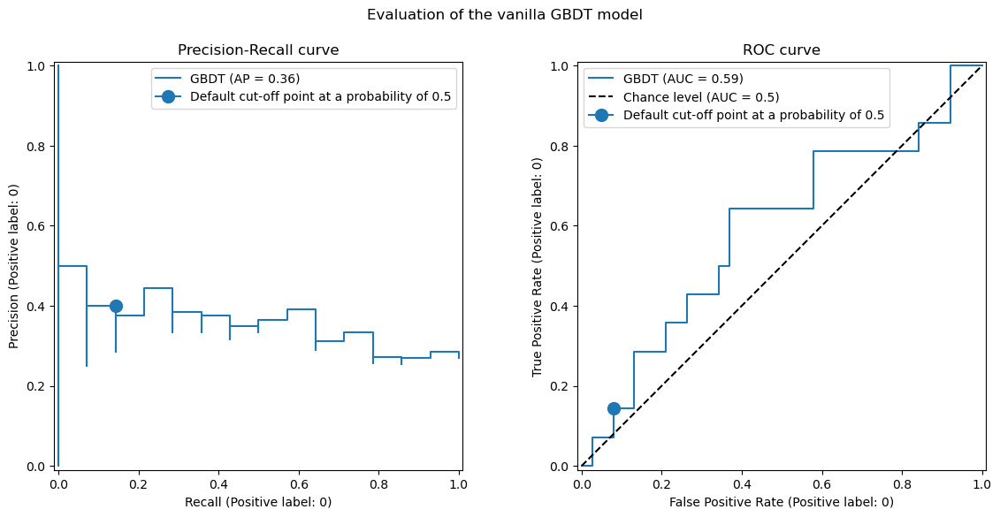

In [2050]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_245TT2, X_test_245TT2, y_test_245TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_245TT2, X_test_245TT2, y_test_245TT2),
    scoring["precision"](mod_245TT2, X_test_245TT2, y_test_245TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_245TT2,
    X_test_245TT2,
    y_test_245TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_245TT2, X_test_245TT2, y_test_245TT2),
    scoring["tpr"](mod_245TT2, X_test_245TT2, y_test_245TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [2051]:
sum(y_test_245TT2==1)

38

In [2052]:
print(f"Business defined metric: {scoring['credit_gain'](mod_245TT2, X_test_245TT2, y_test_245TT2)}")

[[35  3]
 [12  2]]
Business defined metric: -39


In [2053]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [2054]:
tuned_model_245TT2 = TunedThresholdClassifierCV(
    estimator=mod_245TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_245TT2.fit(X_train_245TT2, y_train_245TT2)
print(f"{tuned_model_245TT2.best_threshold_=:0.2f}")

[[ 0 23]
 [ 0  9]]
[[ 7 16]
 [ 3  6]]
[[ 8 15]
 [ 6  3]]
[[ 9 14]
 [ 6  3]]
[[10 13]
 [ 6  3]]
[[10 13]
 [ 6  3]]
[[12 11]
 [ 6  3]]
[[12 11]
 [ 6  3]]
[[12 11]
 [ 6  3]]
[[13 10]
 [ 6  3]]
[[14  9]
 [ 6  3]]
[[16  7]
 [ 6  3]]
[[16  7]
 [ 6  3]]
[[16  7]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[17  6]
 [ 6  3]]
[[19  4]
 [ 6  3]]
[[19  4]
 [ 6  3]]
[[19  4]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[20  3]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[21  2]
 [ 6  3]]
[[22  1]
 [ 6  3]]
[[22  1]
 [ 6  3]]
[[22  1]
 [ 7  2]]
[[22  1]
 [ 7  2]]
[[22  1]
 [ 7  2]]
[[22  1]
 [ 7  2]]
[[22  1]
 [ 

In [2055]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_245TT2,
            y_test_245TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_245TT2, y_test_245TT2),
            scoring["precision"](est, X_test_245TT2, y_test_245TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_245TT2,
            y_test_245TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_245TT2, y_test_245TT2),
            scoring["tpr"](est, X_test_245TT2, y_test_245TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[35  3]
 [12  2]]
[[24 14]
 [ 5  9]]


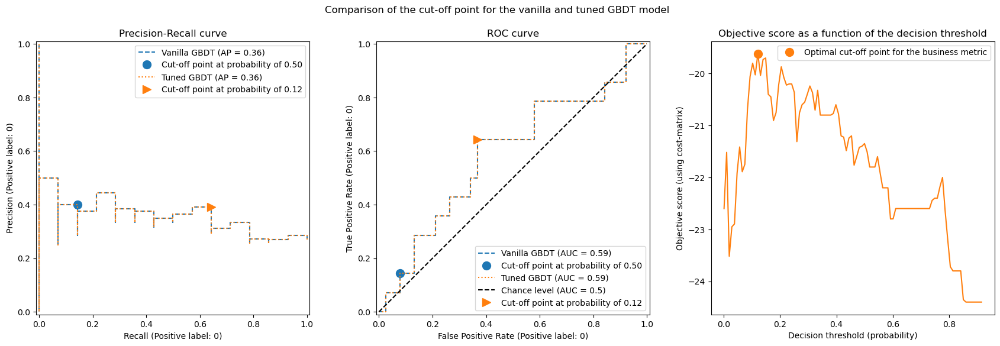

In [2056]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_245TT2, tuned_model_245TT2, title=title)

In [2057]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_245TT2, X_test_245TT2, y_test_245TT2)}")

[[24 14]
 [ 5  9]]
Business defined metric: -29


In [2058]:
sum(y_test_245TT2==0)

14

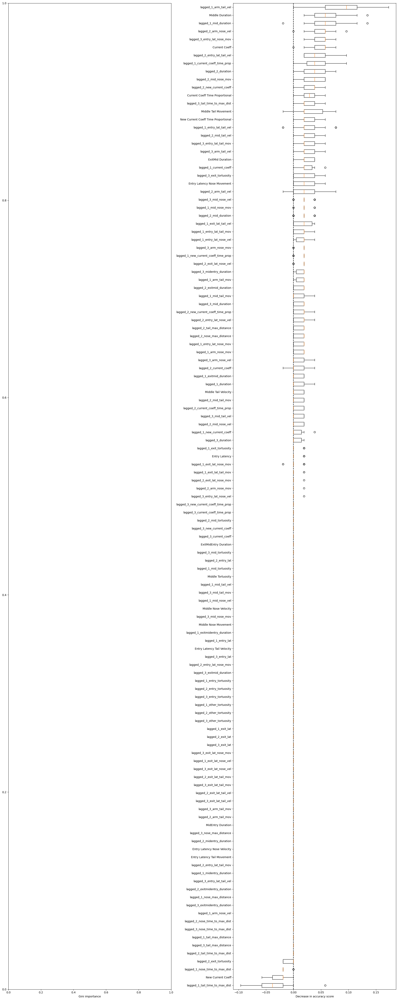

In [2059]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_245TT2, X_test_245TT2, y_test_245TT2, x_main_245,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _4(100) vs _5(51) - are 4s distinguishable from 5s?

In [2060]:
grouped_lagged_added_stats_ri_4 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==4]

In [2061]:
grouped_lagged_added_stats_ri_4['Binary']=0

In [2062]:
grouped_lagged_added_stats_ri_5 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==5]

In [2063]:
grouped_lagged_added_stats_ri_5['Binary']=1

In [2064]:
grouped_lagged_binary45 = pd.concat([grouped_lagged_added_stats_ri_4, grouped_lagged_added_stats_ri_5])

In [2065]:
grouped_lagged_binary45_ri = grouped_lagged_binary45.reset_index(drop=True)

In [2066]:
x_main_45= grouped_lagged_binary45_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',                                            
        'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                                                                 
         'Lagged 4 Cur Coeff Time Proportional',
         'New Lagged 4 Cur Coeff Time Proportional',                                            
       'Binary',
          'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional'                                         
                                                        
                                                        ])
# 

In [2067]:
x_main_45.columns[100:]

Index(['lagged_2_tail_time_to_max_dist', 'lagged_3_tail_time_to_max_dist',
       'lagged_4_tail_time_to_max_dist', 'lagged_1_arm_nose_mov',
       'lagged_2_arm_nose_mov', 'lagged_3_arm_nose_mov',
       'lagged_4_arm_nose_mov', 'lagged_1_arm_nose_vel',
       'lagged_2_arm_nose_vel', 'lagged_3_arm_nose_vel',
       'lagged_4_arm_nose_vel', 'lagged_1_arm_tail_mov',
       'lagged_2_arm_tail_mov', 'lagged_3_arm_tail_mov',
       'lagged_4_arm_tail_mov', 'lagged_1_arm_tail_vel',
       'lagged_2_arm_tail_vel', 'lagged_3_arm_tail_vel',
       'lagged_4_arm_tail_vel', 'lagged_1_entry_tortuosity',
       'lagged_2_entry_tortuosity', 'lagged_3_entry_tortuosity',
       'lagged_4_entry_tortuosity', 'lagged_1_exit_tortuosity',
       'lagged_2_exit_tortuosity', 'lagged_3_exit_tortuosity',
       'lagged_4_exit_tortuosity', 'lagged_1_other_tortuosity',
       'lagged_2_other_tortuosity', 'lagged_3_other_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_1_exit_lat', 'lagged_2_exit_lat',


In [2068]:
x_45 = x_main_45.values

In [2069]:
y_45 = grouped_lagged_binary45_ri['Binary'].values

In [2070]:
X_train_45, X_test_45, y_train_45, y_test_45 = train_test_split(x_45, y_45, test_size=0.2, random_state=4)

In [2089]:
mod_45 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=400, random_state=54)
mod_45.fit(X_train_45, y_train_45)
y_pred_45=mod_45.predict(X_test_45)

In [2090]:
mod_45.n_estimators_

401

In [2091]:
target_names = ['0', '1']

In [2092]:
f1_sc_45 = f1_score(y_test_45, y_pred_45, average = 'weighted')
f1_sc_45

0.6686585304096826

In [2093]:
p_sc_45 = precision_score(y_test_45, y_pred_45, average = 'weighted')
p_sc_45

0.6708482676224611

In [2094]:
cf_matrix_45 = confusion_matrix(y_test_45, y_pred_45)
cf_matrix_45

array([[20,  2],
       [ 7,  2]], dtype=int64)

In [2095]:
print(classification_report(y_test_45, y_pred_45, target_names=target_names))

              precision    recall  f1-score   support

           0       0.74      0.91      0.82        22
           1       0.50      0.22      0.31         9

    accuracy                           0.71        31
   macro avg       0.62      0.57      0.56        31
weighted avg       0.67      0.71      0.67        31



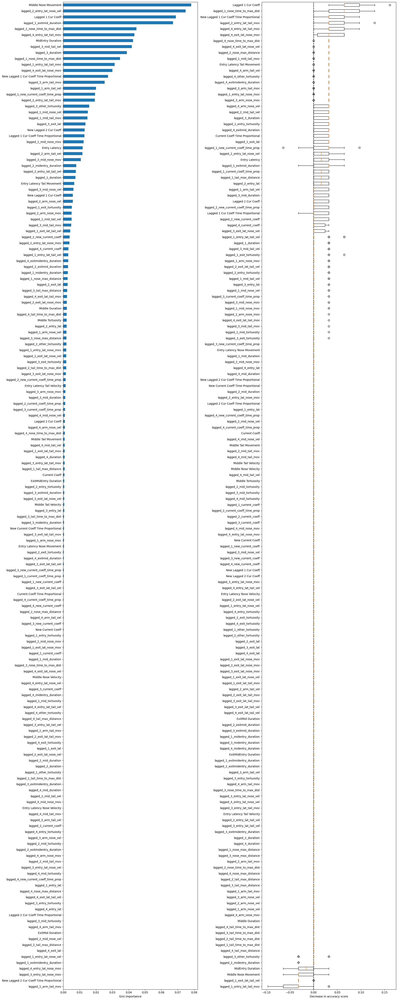

In [2097]:
mdi_importances_bin= pd.Series(mod_45.feature_importances_, index=x_main_45.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_45.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_45, X_test_45, y_test_45, x_main_45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [2098]:
X_train_45TT2, X_test_45TT2, y_train_45TT2, y_test_45TT2 = train_test_split(x_45, y_45, stratify=y_45, random_state=5)

In [2099]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [2100]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [2101]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [2102]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [2103]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -37],  # -1 gain for false positives (when a high is classified as low)
            [-17, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [2146]:
mod_45TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.07, validation_fraction=0.1, n_iter_no_change=500, random_state=54)

In [2147]:
mod_45TT2.fit(X_train_45TT2, y_train_45TT2)

GradientBoostingClassifier(learning_rate=0.07, n_estimators=1000,
                           n_iter_no_change=500, random_state=54)

[[ 5  8]
 [ 6 19]]


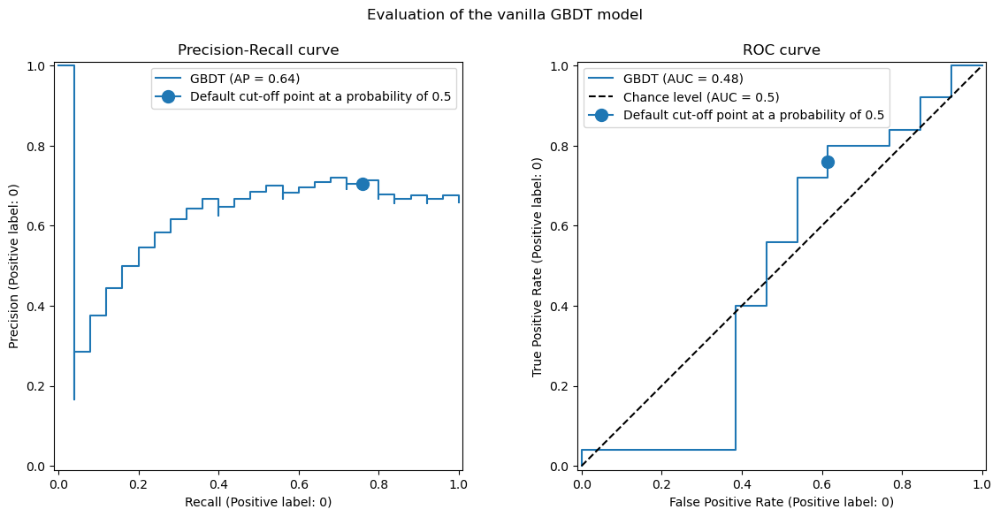

In [2148]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_45TT2, X_test_45TT2, y_test_45TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_45TT2, X_test_45TT2, y_test_45TT2),
    scoring["precision"](mod_45TT2, X_test_45TT2, y_test_45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_45TT2,
    X_test_45TT2,
    y_test_45TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_45TT2, X_test_45TT2, y_test_45TT2),
    scoring["tpr"](mod_45TT2, X_test_45TT2, y_test_45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [2149]:
sum(y_test_45TT2==1)

13

In [2150]:
print(f"Business defined metric: {scoring['credit_gain'](mod_45TT2, X_test_45TT2, y_test_45TT2)}")

[[ 5  8]
 [ 6 19]]
Business defined metric: -398


In [2151]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [2152]:
tuned_model_45TT2 = TunedThresholdClassifierCV(
    estimator=mod_45TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_45TT2.fit(X_train_45TT2, y_train_45TT2)
print(f"{tuned_model_45TT2.best_threshold_=:0.2f}")

[[ 0  8]
 [ 0 15]]
[[ 0  8]
 [ 1 14]]
[[ 0  8]
 [ 1 14]]
[[ 0  8]
 [ 1 14]]
[[ 0  8]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 1 14]]
[[ 1  7]
 [ 2 13]]
[[ 1  7]
 [ 2 13]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 3 12]]
[[ 1  7]
 [ 

In [2153]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_45TT2,
            y_test_45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_45TT2, y_test_45TT2),
            scoring["precision"](est, X_test_45TT2, y_test_45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_45TT2,
            y_test_45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_45TT2, y_test_45TT2),
            scoring["tpr"](est, X_test_45TT2, y_test_45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[ 5  8]
 [ 6 19]]
[[ 6  7]
 [ 7 18]]


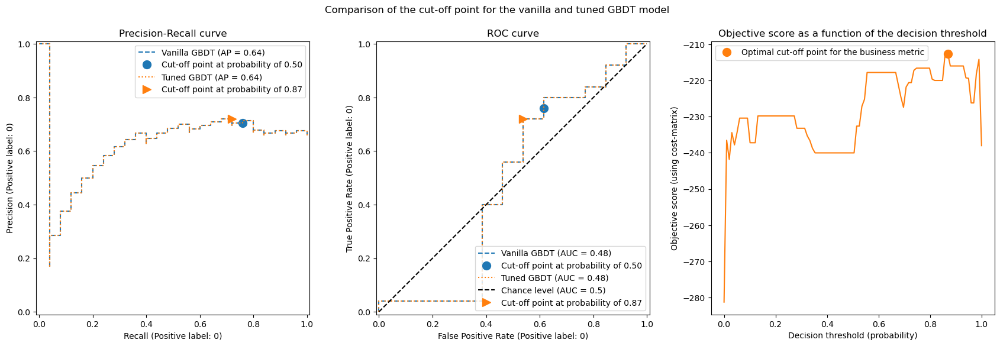

In [2154]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_45TT2, tuned_model_45TT2, title=title)

In [2155]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_45TT2, X_test_45TT2, y_test_45TT2)}")

[[ 6  7]
 [ 7 18]]
Business defined metric: -378


In [2156]:
sum(y_test_45TT2==0)

25

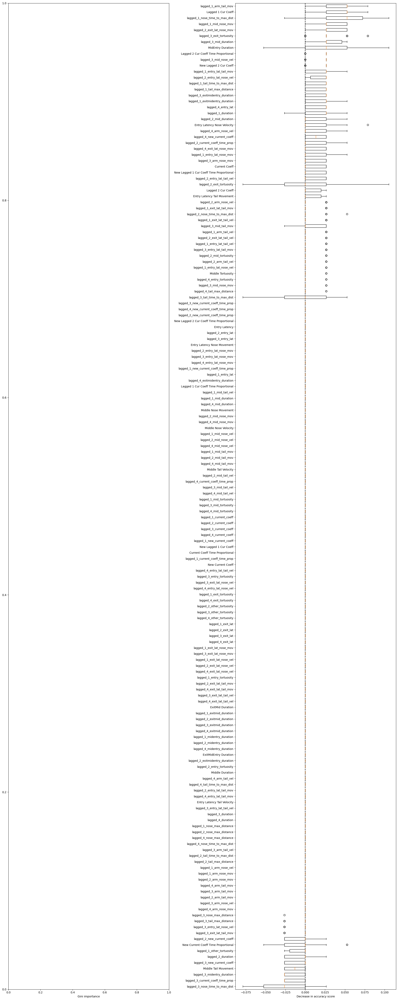

In [2157]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_45TT2, X_test_45TT2, y_test_45TT2, x_main_45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _3(111) vs_4(100) - are 3s distinguishable from 4s?

In [2158]:
grouped_lagged_added_stats_ri_3 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==3]

In [2159]:
grouped_lagged_added_stats_ri_3['Binary']=0

In [2160]:
grouped_lagged_added_stats_ri_4 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==4]

In [2161]:
grouped_lagged_added_stats_ri_4['Binary']=1

In [2162]:
grouped_lagged_binary34 = pd.concat([grouped_lagged_added_stats_ri_3, grouped_lagged_added_stats_ri_4])

In [2163]:
grouped_lagged_binary34_ri = grouped_lagged_binary34.reset_index(drop=True)

In [2164]:
x_main_34= grouped_lagged_binary34_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'lagged_4_mid_duration',
       'lagged_4_mid_nose_mov','lagged_4_mid_nose_vel',
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',   'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop',                                                
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional'                                               
                                                        ])

#

In [2165]:
x_main_34.columns[100:]

Index(['lagged_1_exit_lat', 'lagged_2_exit_lat', 'lagged_3_exit_lat',
       'lagged_1_exit_lat_nose_mov', 'lagged_2_exit_lat_nose_mov',
       'lagged_3_exit_lat_nose_mov', 'lagged_1_exit_lat_nose_vel',
       'lagged_2_exit_lat_nose_vel', 'lagged_3_exit_lat_nose_vel',
       'lagged_1_exit_lat_tail_mov', 'lagged_2_exit_lat_tail_mov',
       'lagged_3_exit_lat_tail_mov', 'lagged_1_exit_lat_tail_vel',
       'lagged_2_exit_lat_tail_vel', 'lagged_3_exit_lat_tail_vel',
       'ExitMid Duration', 'lagged_1_exitmid_duration',
       'lagged_2_exitmid_duration', 'lagged_3_exitmid_duration',
       'MidEntry Duration', 'lagged_1_midentry_duration',
       'lagged_2_midentry_duration', 'lagged_3_midentry_duration',
       'ExitMidEntry Duration', 'lagged_1_exitmidentry_duration',
       'lagged_2_exitmidentry_duration', 'lagged_3_exitmidentry_duration'],
      dtype='object')

In [2166]:
x_34 = x_main_34.values

In [2167]:
y_34 = grouped_lagged_binary34_ri['Binary'].values

In [2168]:
X_train_34, X_test_34, y_train_34, y_test_34 = train_test_split(x_34, y_34, test_size=0.2, random_state=4)

In [2217]:
mod_34 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.005, validation_fraction=0.1, n_iter_no_change=500, random_state=95)
mod_34.fit(X_train_34, y_train_34)
y_pred_34=mod_34.predict(X_test_34)

In [2218]:
mod_34.n_estimators_

503

In [2219]:
target_names = ['0', '1']

In [2220]:
f1_sc_34 = f1_score(y_test_34, y_pred_34, average = 'weighted')
f1_sc_34

0.6025083506649019

In [2221]:
p_sc_34 = precision_score(y_test_34, y_pred_34, average = 'weighted')
p_sc_34

0.6170542635658914

In [2222]:
cf_matrix_34 = confusion_matrix(y_test_34, y_pred_34)
cf_matrix_34

array([[14,  6],
       [11, 12]], dtype=int64)

In [2223]:
print(classification_report(y_test_34, y_pred_34, target_names=target_names))

              precision    recall  f1-score   support

           0       0.56      0.70      0.62        20
           1       0.67      0.52      0.59        23

    accuracy                           0.60        43
   macro avg       0.61      0.61      0.60        43
weighted avg       0.62      0.60      0.60        43



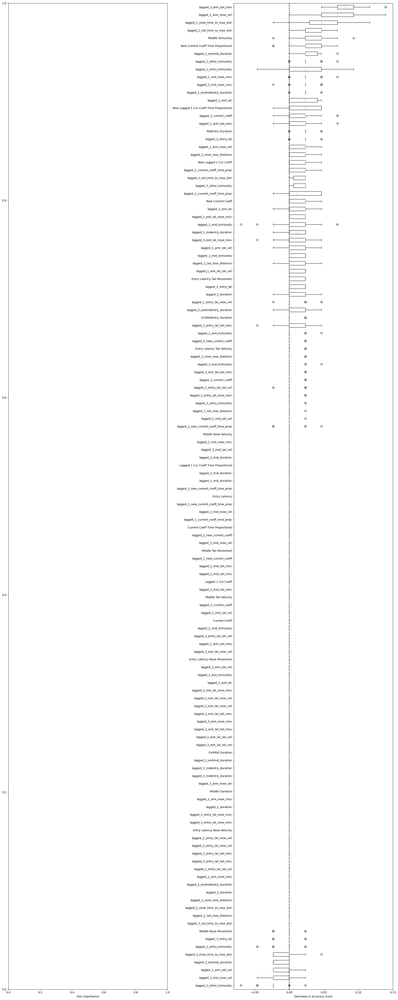

In [2190]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_34, X_test_34, y_test_34, x_main_34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [1586]:
# try tuning part2

In [2411]:
X_train_34TT2, X_test_34TT2, y_train_34TT2, y_test_34TT2 = train_test_split(x_34, y_34, stratify=y_34, random_state=7)

In [2412]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [2413]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [2414]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [2415]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [2416]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -19],  # -1 gain for false positives (when a high is classified as low)
            [-17, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [2423]:
mod_34TT2 = GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=500, random_state=5)

In [2424]:
mod_34TT2.fit(X_train_34TT2, y_train_34TT2)

GradientBoostingClassifier(learning_rate=0.015, n_estimators=1000,
                           n_iter_no_change=500, random_state=5)

[[14 11]
 [11 17]]


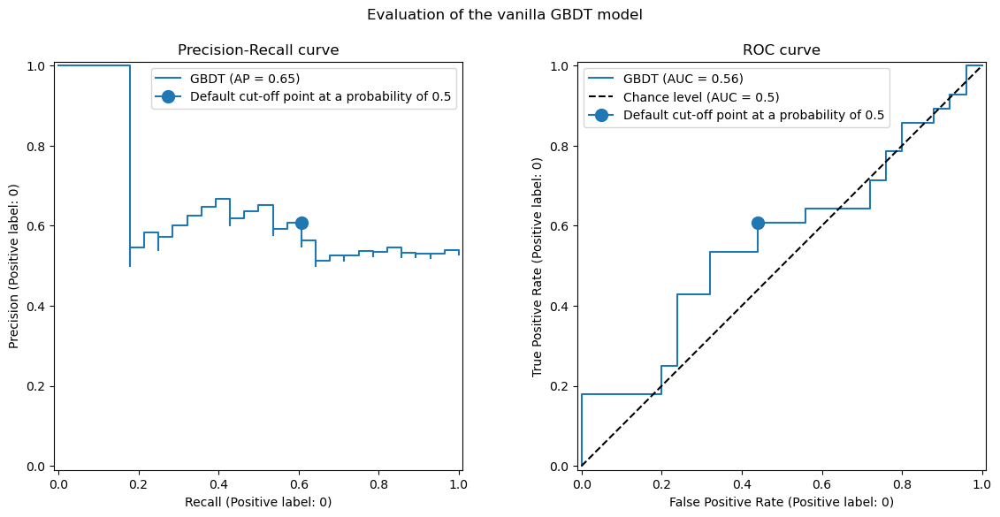

In [2425]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_34TT2, X_test_34TT2, y_test_34TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_34TT2, X_test_34TT2, y_test_34TT2),
    scoring["precision"](mod_34TT2, X_test_34TT2, y_test_34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_34TT2,
    X_test_34TT2,
    y_test_34TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_34TT2, X_test_34TT2, y_test_34TT2),
    scoring["tpr"](mod_34TT2, X_test_34TT2, y_test_34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [2426]:
sum(y_test_34TT2==1)

25

In [2427]:
print(f"Business defined metric: {scoring['credit_gain'](mod_34TT2, X_test_34TT2, y_test_34TT2)}")

[[14 11]
 [11 17]]
Business defined metric: -396


In [2428]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [2429]:
tuned_model_34TT2 = TunedThresholdClassifierCV(
    estimator=mod_34TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_34TT2.fit(X_train_34TT2, y_train_34TT2)
print(f"{tuned_model_34TT2.best_threshold_=:0.2f}")

[[ 0 15]
 [ 0 17]]
[[ 0 15]
 [ 1 16]]
[[ 0 15]
 [ 1 16]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 0 15]
 [ 2 15]]
[[ 1 14]
 [ 3 14]]
[[ 1 14]
 [ 3 14]]
[[ 1 14]
 [ 4 13]]
[[ 2 13]
 [ 4 13]]
[[ 2 13]
 [ 4 13]]
[[ 2 13]
 [ 5 12]]
[[ 2 13]
 [ 5 12]]
[[ 2 13]
 [ 5 12]]
[[ 2 13]
 [ 5 12]]
[[ 2 13]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 5 12]]
[[ 4 11]
 [ 6 11]]
[[ 4 11]
 [ 6 11]]
[[ 4 11]
 [ 6 11]]
[[ 4 11]
 [ 6 11]]
[[ 5 10]
 [ 6 11]]
[[ 5 10]
 [ 6 11]]
[[ 5 10]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 6  9]
 [ 7 10]]
[[ 8  7]
 [ 7 10]]
[[ 8  7]
 [ 7 10]]
[[ 8  7]
 [ 7 10]]
[[ 8  7]
 [ 7 10]]
[[ 9  6]
 [ 7 10]]
[[ 9  6]
 [ 7 10]]
[[ 9  6]
 [ 7 10]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[9 6]
 [8 9]]
[[

In [2430]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_34TT2,
            y_test_34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_34TT2, y_test_34TT2),
            scoring["precision"](est, X_test_34TT2, y_test_34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_34TT2,
            y_test_34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_34TT2, y_test_34TT2),
            scoring["tpr"](est, X_test_34TT2, y_test_34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[14 11]
 [11 17]]
[[14 11]
 [11 17]]


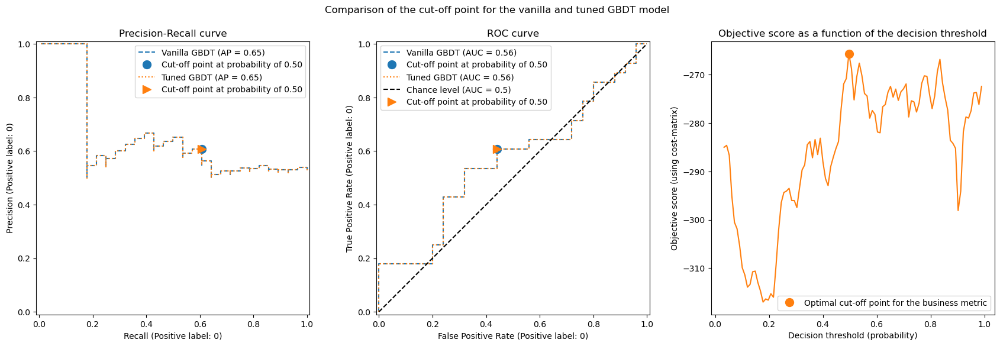

In [2431]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_34TT2, tuned_model_34TT2, title=title)

In [2432]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_34TT2, X_test_34TT2, y_test_34TT2)}")

[[14 11]
 [11 17]]
Business defined metric: -396


In [2433]:
sum(y_test_34TT2==0)

28

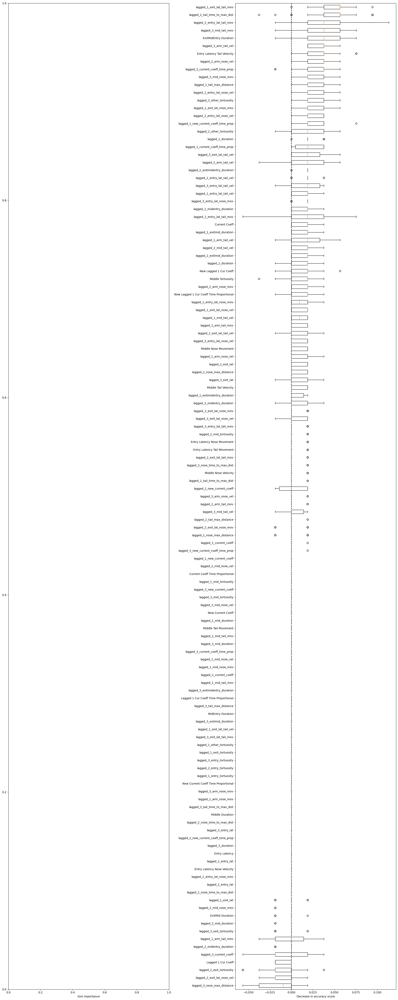

In [2434]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_34TT2, X_test_34TT2, y_test_34TT2, x_main_34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _3(70) vs _4(100) - are 3s distinguishable from 4s? (excluding 23)

In [2435]:
grouped_lagged_added_stats_ri_e3 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==3)&(grouped_lagged_added_stats_ri['lagged_1_choice_ago']>2)]

In [2436]:
grouped_lagged_added_stats_ri_e3['Binary']=0

In [2437]:
grouped_lagged_added_stats_ri_4 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==4]

In [2438]:
grouped_lagged_added_stats_ri_4['Binary']=1

In [2439]:
grouped_lagged_binarye34 = pd.concat([grouped_lagged_added_stats_ri_e3, grouped_lagged_added_stats_ri_4])

In [2440]:
grouped_lagged_binarye34_ri = grouped_lagged_binarye34.reset_index(drop=True)

In [2441]:
x_main_e34= grouped_lagged_binarye34_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'lagged_4_mid_duration',
       'lagged_4_mid_nose_mov','lagged_4_mid_nose_vel',
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 'Lagged 4 Cur Coeff', 
        'lagged_4_new_current_coeff',   'New Lagged 4 Cur Coeff',                                          
        'lagged_4_current_coeff_time_prop',                                                
         'Lagged 4 Cur Coeff Time Proportional',
       'lagged_4_new_current_coeff_time_prop',  'New Lagged 4 Cur Coeff Time Proportional',                                            
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration', 'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',
        'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',
                                                        
                                                        ])


# 


In [2442]:
x_main_e34.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'lagged_2_mid_nose_mov',
       'lagged_3_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'lagged_2_mid_tail_mov',
       'lagged_3_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'Middle Tortuosity', 'lagged_1_mid_tortuosity',
       'lagged_2_mid_tortuosity', 'lagged_3_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'Lagged 1 Cur Coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'lagged_2_new_current_coeff',
       'lagged_3_new_current_coeff', 'New Lagged 1 Cur Coeff',
       'Current Coeff Time Proportional', 'lagged

In [2443]:
x_e34 = x_main_e34.values

In [2444]:
y_e34 = grouped_lagged_binarye34_ri['Binary'].values

In [2445]:
X_train_e34, X_test_e34, y_train_e34, y_test_e34 = train_test_split(x_e34, y_e34, test_size=0.2, random_state=55)

In [2528]:
mod_e34 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.0025, validation_fraction=0.1, n_iter_no_change=600, random_state=5)
mod_e34.fit(X_train_e34, y_train_e34)
y_pred_e34=mod_e34.predict(X_test_e34)

In [2529]:
mod_e34.n_estimators_

769

In [2530]:
target_names = ['0', '1']

In [2531]:
f1_sc_e34 = f1_score(y_test_e34, y_pred_e34, average = 'weighted')
f1_sc_e34

0.5413910244949043

In [2532]:
p_sc_e34 = precision_score(y_test_e34, y_pred_e34, average = 'weighted')
p_sc_e34

0.5317647058823529

In [2533]:
cf_matrix_e34 = confusion_matrix(y_test_e34, y_pred_e34)
cf_matrix_e34

array([[ 3,  9],
       [ 6, 16]], dtype=int64)

In [2534]:
print(classification_report(y_test_e34, y_pred_e34, target_names=target_names))

              precision    recall  f1-score   support

           0       0.33      0.25      0.29        12
           1       0.64      0.73      0.68        22

    accuracy                           0.56        34
   macro avg       0.49      0.49      0.48        34
weighted avg       0.53      0.56      0.54        34



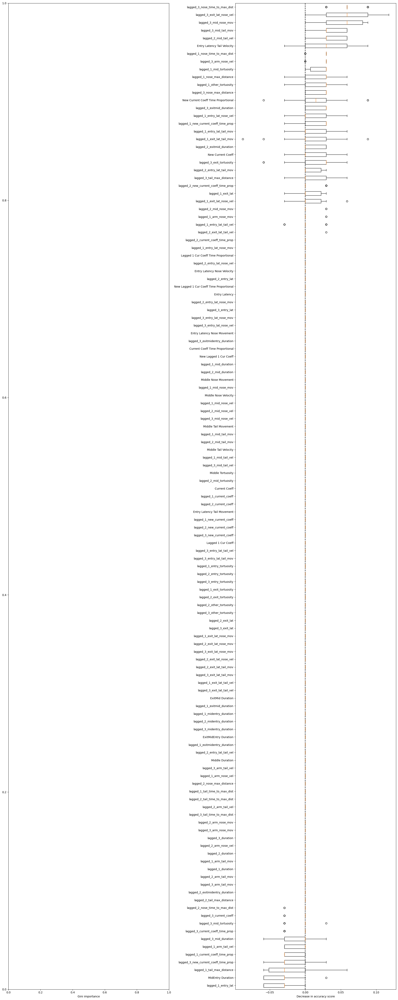

In [2535]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_e34, X_test_e34, y_test_e34, x_main_e34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [3626]:
# try tuning part2

In [2659]:
X_train_e34TT2, X_test_e34TT2, y_train_e34TT2, y_test_e34TT2 = train_test_split(x_e34, y_e34, stratify=y_e34, random_state=5)

In [2660]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [2661]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [2662]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [2663]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [2694]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -18],  # -1 gain for false positives (when a high is classified as low)
            [-26, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [2695]:
mod_e34TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.025, validation_fraction=0.1, n_iter_no_change=400, random_state=5)

In [2696]:
mod_e34TT2.fit(X_train_e34TT2, y_train_e34TT2)

GradientBoostingClassifier(learning_rate=0.025, n_estimators=1000,
                           n_iter_no_change=400, random_state=5)

[[17  8]
 [12  6]]


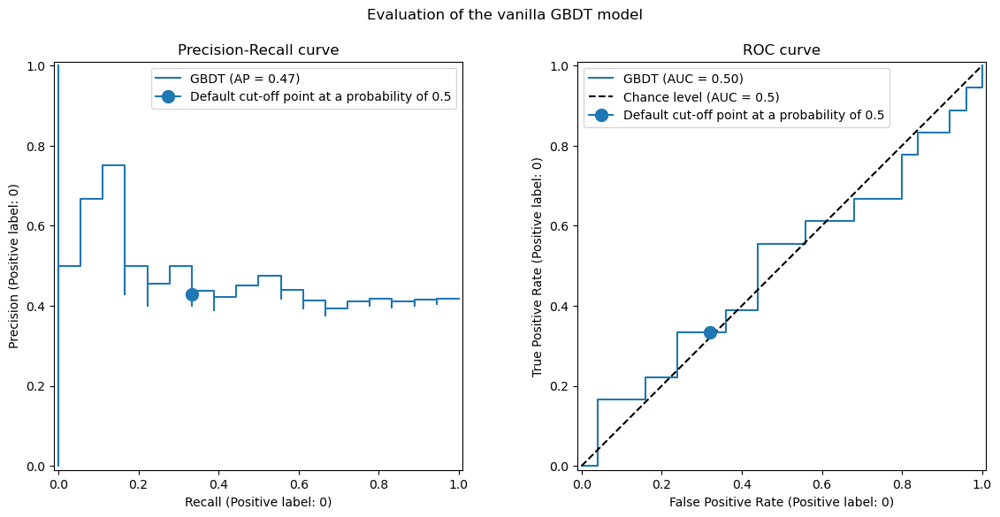

In [2697]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_e34TT2, X_test_e34TT2, y_test_e34TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_e34TT2, X_test_e34TT2, y_test_e34TT2),
    scoring["precision"](mod_e34TT2, X_test_e34TT2, y_test_e34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_e34TT2,
    X_test_e34TT2,
    y_test_e34TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_e34TT2, X_test_e34TT2, y_test_e34TT2),
    scoring["tpr"](mod_e34TT2, X_test_e34TT2, y_test_e34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [2698]:
sum(y_test_e34TT2==1)

25

In [2699]:
print(f"Business defined metric: {scoring['credit_gain'](mod_e34TT2, X_test_e34TT2, y_test_e34TT2)}")

[[17  8]
 [12  6]]
Business defined metric: -456


In [2700]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [2701]:
tuned_model_e34TT2 = TunedThresholdClassifierCV(
    estimator=mod_e34TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_e34TT2.fit(X_train_e34TT2, y_train_e34TT2)
print(f"{tuned_model_e34TT2.best_threshold_=:0.2f}")

[[ 0 15]
 [ 0 11]]
[[ 2 13]
 [ 1 10]]
[[ 3 12]
 [ 1 10]]
[[ 3 12]
 [ 1 10]]
[[ 4 11]
 [ 2  9]]
[[ 4 11]
 [ 2  9]]
[[ 4 11]
 [ 2  9]]
[[6 9]
 [2 9]]
[[6 9]
 [3 8]]
[[6 9]
 [3 8]]
[[6 9]
 [4 7]]
[[6 9]
 [5 6]]
[[6 9]
 [5 6]]
[[6 9]
 [6 5]]
[[6 9]
 [6 5]]
[[6 9]
 [6 5]]
[[7 8]
 [6 5]]
[[7 8]
 [6 5]]
[[7 8]
 [6 5]]
[[7 8]
 [6 5]]
[[8 7]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[9 6]
 [6 5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 6  5]]
[[10  5]
 [ 7  4]]
[[10  5]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7  4]]
[[11  4]
 [ 7

In [2702]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_e34TT2,
            y_test_e34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_e34TT2, y_test_e34TT2),
            scoring["precision"](est, X_test_e34TT2, y_test_e34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_e34TT2,
            y_test_e34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_e34TT2, y_test_e34TT2),
            scoring["tpr"](est, X_test_e34TT2, y_test_e34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[17  8]
 [12  6]]
[[14 11]
 [ 8 10]]


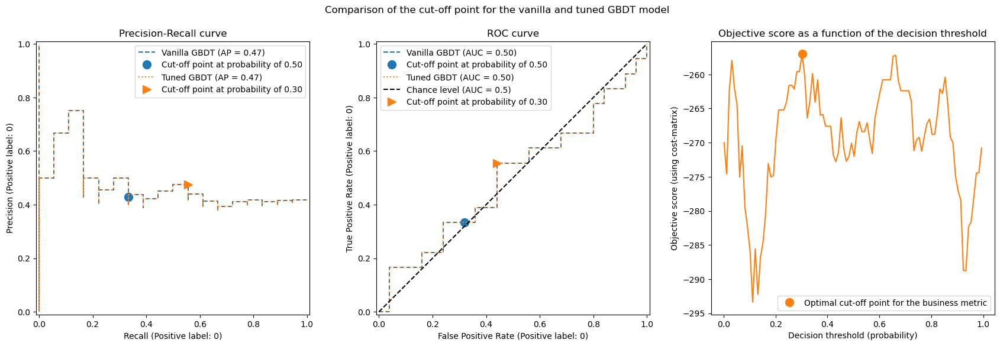

In [2703]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_e34TT2, tuned_model_e34TT2, title=title)

In [2704]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_e34TT2, X_test_e34TT2, y_test_e34TT2)}")

[[14 11]
 [ 8 10]]
Business defined metric: -406


In [2705]:
sum(y_test_e34TT2==0)

18

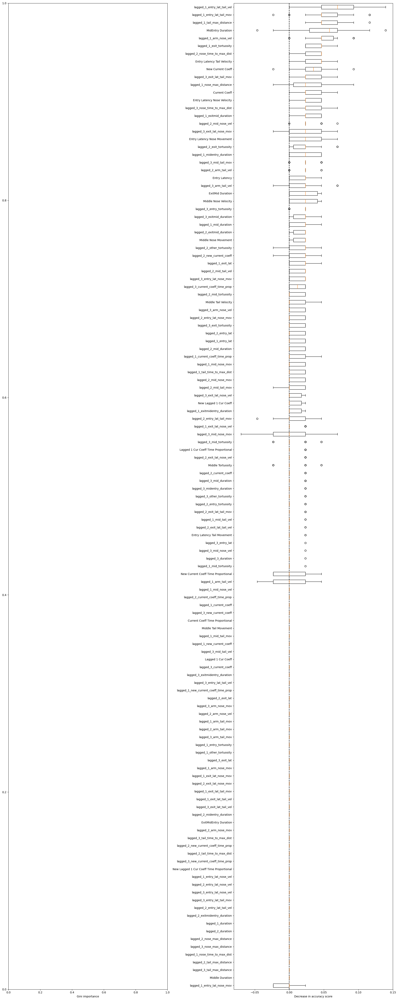

In [2706]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_e34TT2, X_test_e34TT2, y_test_e34TT2, x_main_e34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _3(111) vs _5(51) - are 3s distinguishable from 5s?

In [2714]:
grouped_lagged_added_stats_ri_3 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==3]

In [2715]:
grouped_lagged_added_stats_ri_3['Binary']=0

In [2716]:
grouped_lagged_added_stats_ri_5 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==5]

In [2717]:
grouped_lagged_added_stats_ri_5['Binary']=1

In [2718]:
grouped_lagged_binary35 = pd.concat([grouped_lagged_added_stats_ri_3, grouped_lagged_added_stats_ri_5])

In [2719]:
grouped_lagged_binary35_ri = grouped_lagged_binary35.reset_index(drop=True)

In [2720]:
x_main_35= grouped_lagged_binary35_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                            
          'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                            
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional'                                                
                                                        ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [2721]:
x_main_35.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'lagged_4_mid_duration',
       'Middle Nose Movement', 'lagged_1_mid_nose_mov',
       'lagged_2_mid_nose_mov', 'lagged_3_mid_nose_mov',
       'lagged_4_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'lagged_4_mid_nose_vel',
       'Middle Tail Movement', 'lagged_1_mid_tail_mov',
       'lagged_2_mid_tail_mov', 'lagged_3_mid_tail_mov',
       'lagged_4_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'lagged_4_mid_tail_vel', 'Middle Tortuosity',
       'lagged_1_mid_tortuosity', 'lagged_2_mid_tortuosity',
       'lagged_3_mid_tortuosity', 'lagged_4_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'lagged_4_current_coeff',
       'Lagged 1 Cur Co

In [2722]:
x_35 = x_main_35.values

In [2723]:
y_35 = grouped_lagged_binary35_ri['Binary'].values

In [2724]:
X_train_35, X_test_35, y_train_35, y_test_35 = train_test_split(x_35, y_35, test_size=0.2, random_state=4)

In [2775]:
mod_35 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=500, random_state=59)
mod_35.fit(X_train_35, y_train_35)
y_pred_35=mod_35.predict(X_test_35)

In [2776]:
mod_35.n_estimators_

515

In [2777]:
target_names = ['0', '1']

In [2778]:
f1_sc_35 = f1_score(y_test_35, y_pred_35, average = 'weighted')
f1_sc_35

0.8264942604565247

In [2779]:
p_sc_35 = precision_score(y_test_35, y_pred_35, average = 'weighted')
p_sc_35

0.8746081504702194

In [2780]:
cf_matrix_35 = confusion_matrix(y_test_35, y_pred_35)
cf_matrix_35

array([[24,  0],
       [ 5,  4]], dtype=int64)

In [2781]:
print(classification_report(y_test_35, y_pred_35, target_names=target_names))

              precision    recall  f1-score   support

           0       0.83      1.00      0.91        24
           1       1.00      0.44      0.62         9

    accuracy                           0.85        33
   macro avg       0.91      0.72      0.76        33
weighted avg       0.87      0.85      0.83        33



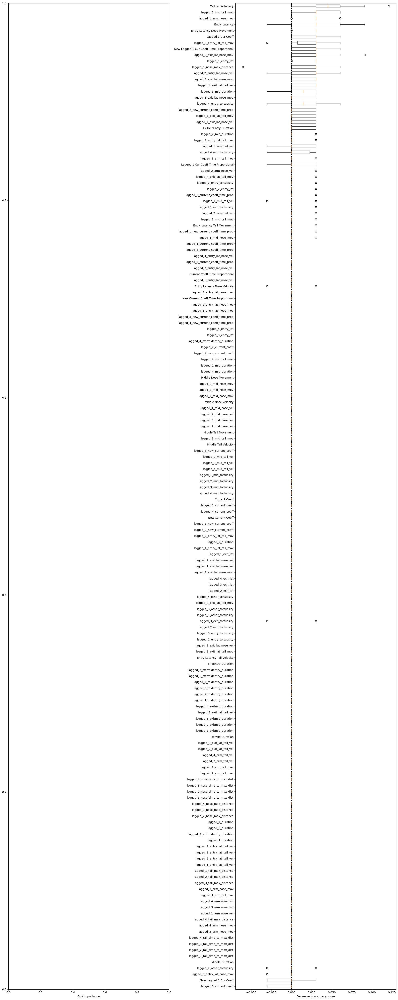

In [2782]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_35, X_test_35, y_test_35, x_main_35,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [2783]:
X_train_35TT2, X_test_35TT2, y_train_35TT2, y_test_35TT2 = train_test_split(x_35, y_35, stratify=y_35, random_state=54)

In [2784]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [2785]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [2786]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [2787]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [2788]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -14],  # -1 gain for false positives (when a high is classified as low)
            [-7, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [2789]:
mod_35TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.00715, validation_fraction=0.1, n_iter_no_change=500, random_state=59)

In [2790]:
mod_35TT2.fit(X_train_35TT2, y_train_35TT2)

GradientBoostingClassifier(learning_rate=0.00715, n_estimators=1000,
                           n_iter_no_change=500, random_state=59)

[[ 7  6]
 [ 2 26]]


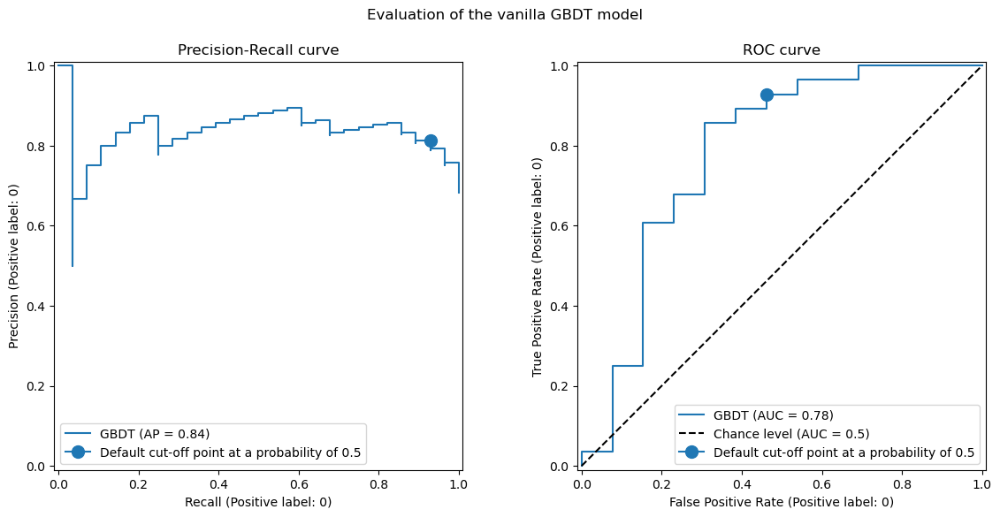

In [2791]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_35TT2, X_test_35TT2, y_test_35TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_35TT2, X_test_35TT2, y_test_35TT2),
    scoring["precision"](mod_35TT2, X_test_35TT2, y_test_35TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_35TT2,
    X_test_35TT2,
    y_test_35TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_35TT2, X_test_35TT2, y_test_35TT2),
    scoring["tpr"](mod_35TT2, X_test_35TT2, y_test_35TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [2792]:
sum(y_test_35TT2==1)

13

In [2793]:
print(f"Business defined metric: {scoring['credit_gain'](mod_35TT2, X_test_35TT2, y_test_35TT2)}")

[[ 7  6]
 [ 2 26]]
Business defined metric: -98


In [2794]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [2795]:
tuned_model_35TT2 = TunedThresholdClassifierCV(
    estimator=mod_35TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_35TT2.fit(X_train_35TT2, y_train_35TT2)
print(f"{tuned_model_35TT2.best_threshold_=:0.2f}")

[[ 0  8]
 [ 0 17]]
[[ 1  7]
 [ 0 17]]
[[ 1  7]
 [ 0 17]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 1  7]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 1 16]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 2  6]
 [ 3 14]]
[[ 3  5]
 [ 3 14]]
[[ 3  5]
 [ 3 14]]
[[ 3  5]
 [ 3 14]]
[[ 3  5]
 [ 3 14]]
[[ 3  5]
 [ 3 14]]
[[ 3  5]
 [ 

In [2796]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_35TT2,
            y_test_35TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_35TT2, y_test_35TT2),
            scoring["precision"](est, X_test_35TT2, y_test_35TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_35TT2,
            y_test_35TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_35TT2, y_test_35TT2),
            scoring["tpr"](est, X_test_35TT2, y_test_35TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[ 7  6]
 [ 2 26]]
[[ 9  4]
 [ 5 23]]


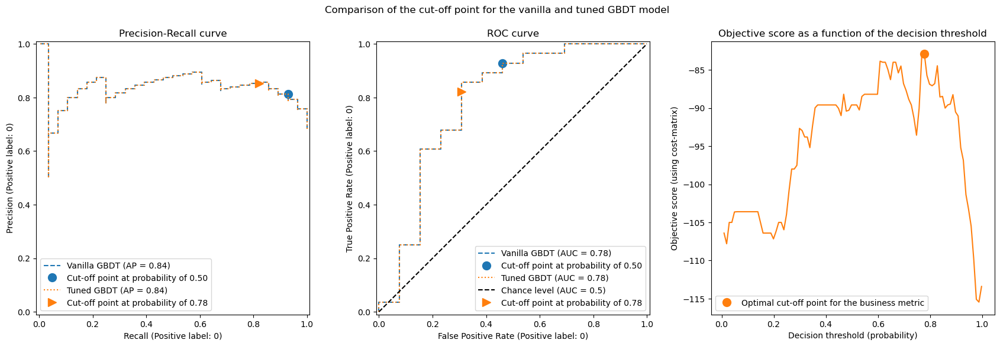

In [2797]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_35TT2, tuned_model_35TT2, title=title)

In [2798]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_35TT2, X_test_35TT2, y_test_35TT2)}")

[[ 9  4]
 [ 5 23]]
Business defined metric: -91


In [2799]:
sum(y_test_35TT2==0)

28

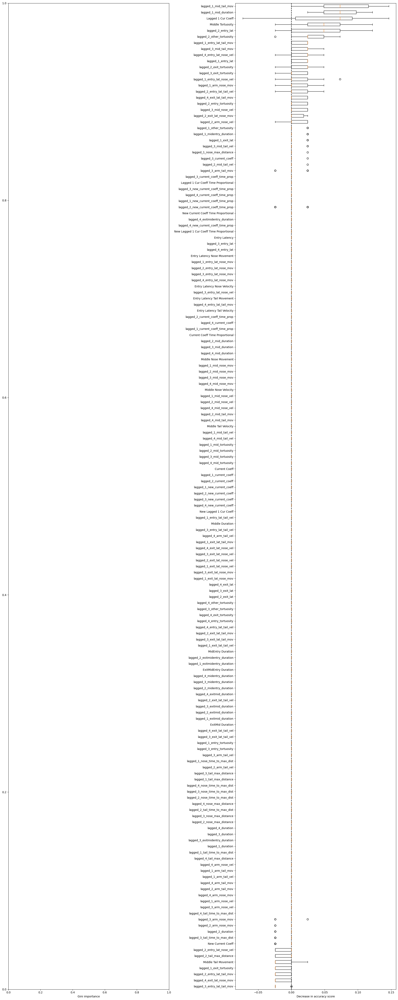

In [2800]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_35TT2, X_test_35TT2, y_test_35TT2, x_main_35,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57), _3(111) vs _4(100), _5(51) - are 2+3 different than 4+5?

In [404]:
grouped_lagged_added_stats_ri_23 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==2)|(grouped_lagged_added_stats_ri['Choice Output']==3)]

In [405]:
grouped_lagged_added_stats_ri_23['Binary']=0

In [406]:
grouped_lagged_added_stats_ri_45 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==4)|(grouped_lagged_added_stats_ri['Choice Output']==5)]

In [407]:
grouped_lagged_added_stats_ri_45['Binary']=1

In [408]:
grouped_lagged_binary23v45 = pd.concat([grouped_lagged_added_stats_ri_23, grouped_lagged_added_stats_ri_45])

In [409]:
grouped_lagged_binary23v45_ri = grouped_lagged_binary23v45.reset_index(drop=True)

In [410]:
x_main_23v45= grouped_lagged_binary23v45_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
    
      'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                                     
         'Lagged 4 Cur Coeff Time Proportional',
       'New Lagged 4 Cur Coeff Time Proportional',                                            
      'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                             
       'Lagged 3 Cur Coeff',  'New Lagged 3 Cur Coeff', 'Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',                                                 
       'Lagged 1 Cur Coeff',  'New Lagged 1 Cur Coeff', 'Lagged 1 Cur Coeff Time Proportional', 'New Lagged 1 Cur Coeff Time Proportional',                                                 ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [411]:
x_main_23v45.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'lagged_4_mid_duration',
       'Middle Nose Movement', 'lagged_1_mid_nose_mov',
       'lagged_2_mid_nose_mov', 'lagged_3_mid_nose_mov',
       'lagged_4_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'lagged_4_mid_nose_vel',
       'Middle Tail Movement', 'lagged_1_mid_tail_mov',
       'lagged_2_mid_tail_mov', 'lagged_3_mid_tail_mov',
       'lagged_4_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'lagged_4_mid_tail_vel', 'Middle Tortuosity',
       'lagged_1_mid_tortuosity', 'lagged_2_mid_tortuosity',
       'lagged_3_mid_tortuosity', 'lagged_4_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'lagged_4_current_coeff', 'New Current Coeff',
  

In [412]:
x_23v45 = x_main_23v45.values

In [413]:
y_23v45 = grouped_lagged_binary23v45_ri['Binary'].values

In [414]:
X_train_23v45, X_test_23v45, y_train_23v45, y_test_23v45 = train_test_split(x_23v45, y_23v45, test_size=0.2, random_state=5)

In [443]:
mod_23v45 =  GradientBoostingClassifier(n_estimators = 1000, learning_rate = 0.007, validation_fraction=0.1, n_iter_no_change=100, random_state=54)
mod_23v45.fit(X_train_23v45, y_train_23v45)
y_pred_23v45=mod_23v45.predict(X_test_23v45)

In [444]:
mod_23v45.n_estimators_

357

In [445]:
target_names = ['0', '1']

In [446]:
f1_sc_23v45 = f1_score(y_test_23v45, y_pred_23v45, average = 'weighted')
f1_sc_23v45

0.6227832512315271

In [447]:
p_sc_23v45 = precision_score(y_test_23v45, y_pred_23v45, average = 'weighted')
p_sc_23v45

0.6255005005005005

In [448]:
cf_matrix_23v45 = confusion_matrix(y_test_23v45, y_pred_23v45)
cf_matrix_23v45

array([[23, 10],
       [14, 17]], dtype=int64)

In [449]:
print(classification_report(y_test_23v45, y_pred_23v45, target_names=target_names))

              precision    recall  f1-score   support

           0       0.62      0.70      0.66        33
           1       0.63      0.55      0.59        31

    accuracy                           0.62        64
   macro avg       0.63      0.62      0.62        64
weighted avg       0.63      0.62      0.62        64



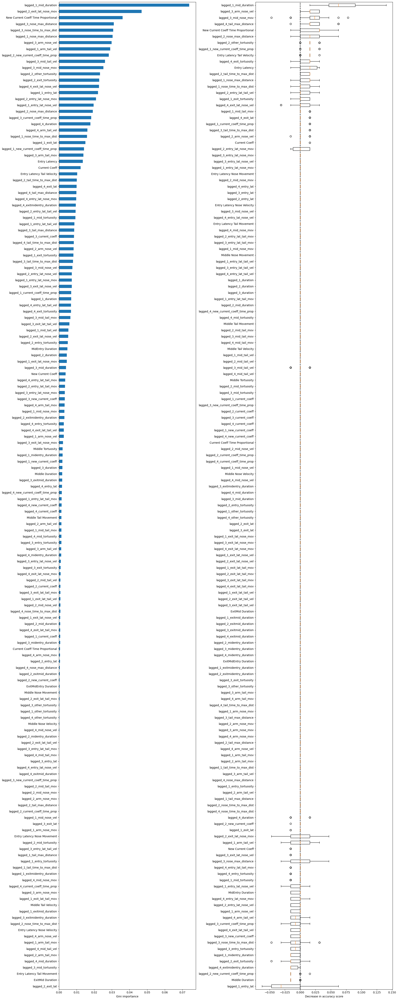

In [451]:
mdi_importances_bin= pd.Series(mod_23v45.feature_importances_, index=x_main_23v45.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_23v45.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_23v45, X_test_23v45, y_test_23v45, x_main_23v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [452]:
# try tuning part2

In [453]:
X_train_23v45TT2, X_test_23v45TT2, y_train_23v45TT2, y_test_23v45TT2 = train_test_split(x_23v45, y_23v45, stratify=y_23v45, random_state=7)

In [454]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [455]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [456]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [457]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [473]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -2.5],  # -1 gain for false positives (when a high is classified as low)
            [-2, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [507]:
mod_23v45TT2 = GradientBoostingClassifier(n_estimators = 1000, learning_rate = 0.007, validation_fraction=0.1, n_iter_no_change=100, random_state=54)

In [508]:
mod_23v45TT2.fit(X_train_23v45TT2, y_train_23v45TT2)

GradientBoostingClassifier(learning_rate=0.007, n_estimators=1000,
                           n_iter_no_change=100, random_state=54)

[[17 21]
 [11 31]]


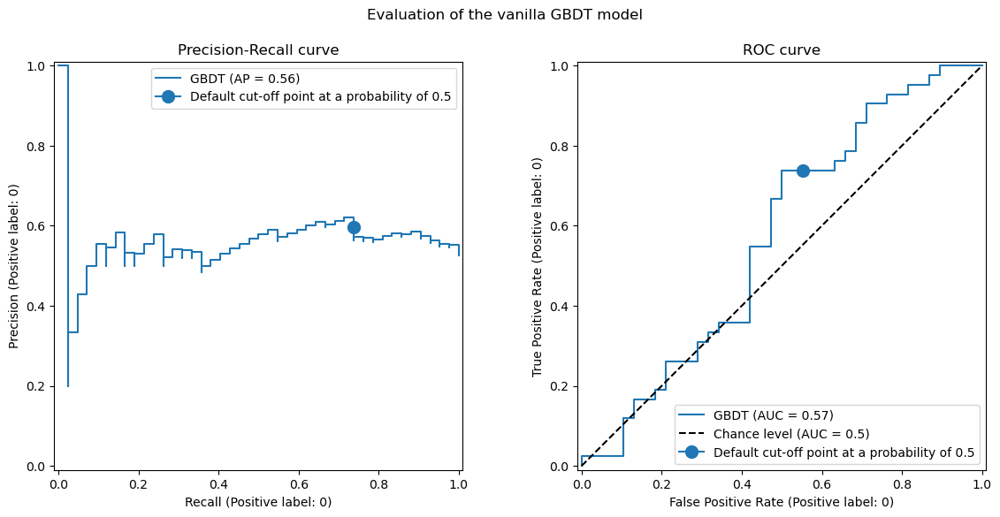

In [509]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2),
    scoring["precision"](mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_23v45TT2,
    X_test_23v45TT2,
    y_test_23v45TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2),
    scoring["tpr"](mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [510]:
sum(y_test_23v45TT2==1)

38

In [511]:
print(f"Business defined metric: {scoring['credit_gain'](mod_23v45TT2, X_test_23v45TT2, y_test_23v45TT2)}")

[[17 21]
 [11 31]]
Business defined metric: -74.5


In [512]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [513]:
tuned_model_23v45TT2 = TunedThresholdClassifierCV(
    estimator=mod_23v45TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_23v45TT2.fit(X_train_23v45TT2, y_train_23v45TT2)
print(f"{tuned_model_23v45TT2.best_threshold_=:0.2f}")

[[ 0 23]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 1 22]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 0 25]]
[[ 2 21]
 [ 1 24]]
[[ 2 21]
 [ 2 23]]
[[ 3 20]
 [ 2 23]]
[[ 3 20]
 [ 2 23]]
[[ 3 20]
 [ 2 23]]
[[ 3 20]
 [ 2 23]]
[[ 3 20]
 [ 2 23]]
[[ 4 19]
 [ 2 23]]
[[ 5 18]
 [ 2 23]]
[[ 5 18]
 [ 2 23]]
[[ 5 18]
 [ 2 23]]
[[ 5 18]
 [ 2 23]]
[[ 5 18]
 [ 2 23]]
[[ 6 17]
 [ 2 23]]
[[ 6 17]
 [ 3 22]]
[[ 7 16]
 [ 3 22]]
[[ 7 16]
 [ 3 22]]
[[ 7 16]
 [ 3 22]]
[[ 7 16]
 [ 3 22]]
[[ 7 16]
 [ 3 22]]
[[ 9 14]
 [ 3 22]]
[[ 9 14]
 [ 3 22]]
[[ 9 14]
 [ 3 22]]
[[ 9 14]
 [ 5 20]]
[[ 9 14]
 [ 5 20]]
[[ 9 14]
 [ 5 20]]
[[ 9 14]
 [ 5 20]]
[[ 9 14]
 [ 6 19]]
[[ 9 14]
 [ 6 19]]
[[ 9 14]
 [ 6 19]]
[[10 13]
 [ 6 19]]
[[10 13]
 [ 

In [514]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_23v45TT2,
            y_test_23v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_23v45TT2, y_test_23v45TT2),
            scoring["precision"](est, X_test_23v45TT2, y_test_23v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_23v45TT2,
            y_test_23v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_23v45TT2, y_test_23v45TT2),
            scoring["tpr"](est, X_test_23v45TT2, y_test_23v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[17 21]
 [11 31]]
[[20 18]
 [15 27]]


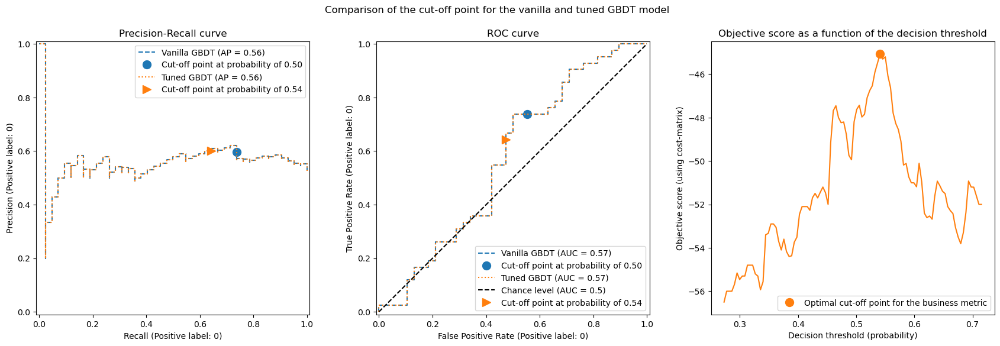

In [515]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_23v45TT2, tuned_model_23v45TT2, title=title)

In [516]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_23v45TT2, X_test_23v45TT2, y_test_23v45TT2)}")

[[20 18]
 [15 27]]
Business defined metric: -75.0


In [517]:
sum(y_test_23v45TT2==0)

42

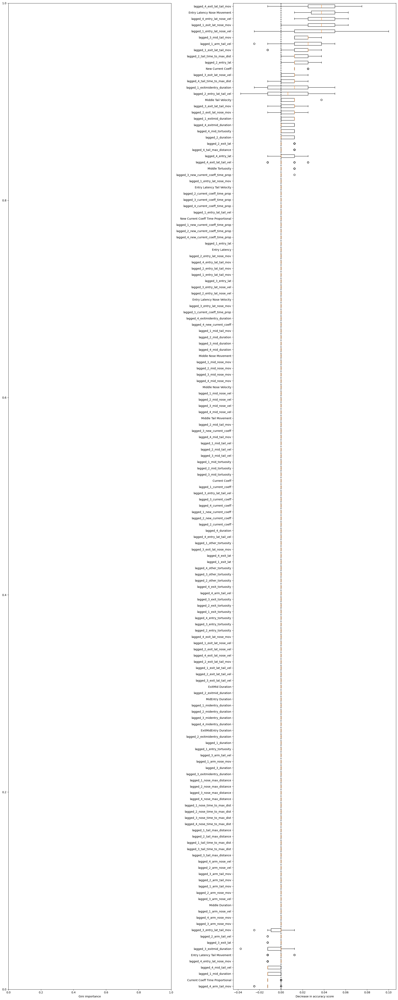

In [518]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_23v45TT2, X_test_23v45TT2, y_test_23v45TT2, x_main_23v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _3(111) vs _4(100), _5(51) - are 3s distinguishable from 4s and 5s?

In [2810]:
grouped_lagged_added_stats_ri_3 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==3]

In [2811]:
grouped_lagged_added_stats_ri_3['Binary']=0

In [2812]:
grouped_lagged_added_stats_ri_45 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==5)|(grouped_lagged_added_stats_ri['Choice Output']==4)]

In [2813]:
grouped_lagged_added_stats_ri_45['Binary']=1

In [2814]:
grouped_lagged_binary3v45 = pd.concat([grouped_lagged_added_stats_ri_3, grouped_lagged_added_stats_ri_45])

In [2815]:
grouped_lagged_binary3v45_ri = grouped_lagged_binary3v45.reset_index(drop=True)

In [2816]:
x_main_3v45= grouped_lagged_binary3v45_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                            
          'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                            
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional'                                                
                                                        ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [2817]:
x_main_3v45.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'lagged_4_mid_duration',
       'Middle Nose Movement', 'lagged_1_mid_nose_mov',
       'lagged_2_mid_nose_mov', 'lagged_3_mid_nose_mov',
       'lagged_4_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'lagged_4_mid_nose_vel',
       'Middle Tail Movement', 'lagged_1_mid_tail_mov',
       'lagged_2_mid_tail_mov', 'lagged_3_mid_tail_mov',
       'lagged_4_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'lagged_4_mid_tail_vel', 'Middle Tortuosity',
       'lagged_1_mid_tortuosity', 'lagged_2_mid_tortuosity',
       'lagged_3_mid_tortuosity', 'lagged_4_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'lagged_4_current_coeff',
       'Lagged 1 Cur Co

In [2818]:
x_3v45 = x_main_3v45.values

In [2819]:
y_3v45 = grouped_lagged_binary3v45_ri['Binary'].values

In [2820]:
X_train_3v45, X_test_3v45, y_train_3v45, y_test_3v45 = train_test_split(x_3v45, y_3v45, test_size=0.2, random_state=4)

In [3083]:
mod_3v45 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=300, random_state=5)
mod_3v45.fit(X_train_3v45, y_train_3v45)
y_pred_3v45=mod_3v45.predict(X_test_3v45)

In [3084]:
mod_3v45.n_estimators_

314

In [3085]:
target_names = ['0', '1']

In [3086]:
f1_sc_3v45 = f1_score(y_test_3v45, y_pred_3v45, average = 'weighted')
f1_sc_3v45

0.5964604358636829

In [3087]:
p_sc_3v45 = precision_score(y_test_3v45, y_pred_3v45, average = 'weighted')
p_sc_3v45

0.6001226707167475

In [3088]:
cf_matrix_3v45 = confusion_matrix(y_test_3v45, y_pred_3v45)
cf_matrix_3v45

array([[11, 13],
       [ 8, 21]], dtype=int64)

In [3089]:
print(classification_report(y_test_3v45, y_pred_3v45, target_names=target_names))

              precision    recall  f1-score   support

           0       0.58      0.46      0.51        24
           1       0.62      0.72      0.67        29

    accuracy                           0.60        53
   macro avg       0.60      0.59      0.59        53
weighted avg       0.60      0.60      0.60        53



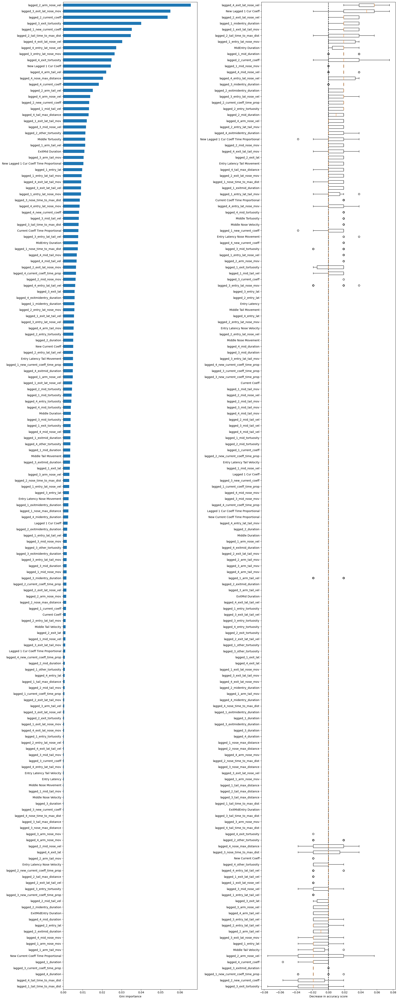

In [2895]:
mdi_importances_bin= pd.Series(mod_3v45.feature_importances_, index=x_main_3v45.columns)
tree_importance_sorted_idx_bin = np.argsort(mod_3v45.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_3v45, X_test_3v45, y_test_3v45, x_main_3v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [3301]:
X_train_3v45TT2, X_test_3v45TT2, y_train_3v45TT2, y_test_3v45TT2 = train_test_split(x_3v45, y_3v45, stratify=y_3v45, random_state=7)

In [3302]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [3303]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [3304]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [3305]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [3337]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -30],  # -1 gain for false positives (when a high is classified as low)
            [-38, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [3338]:
mod_3v45TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=600, random_state=59)

In [3339]:
mod_3v45TT2.fit(X_train_3v45TT2, y_train_3v45TT2)

GradientBoostingClassifier(learning_rate=0.015, n_estimators=1000,
                           n_iter_no_change=600, random_state=59)

[[28 10]
 [12 16]]


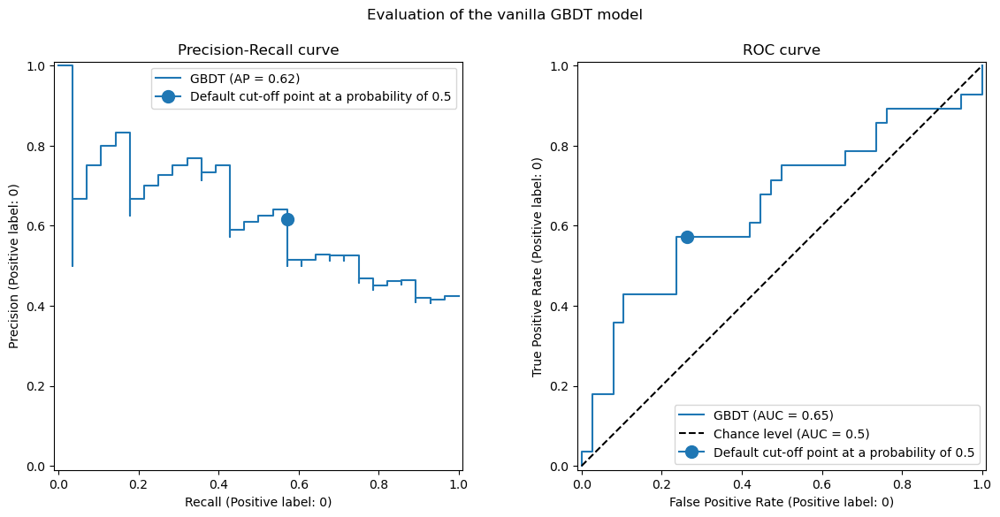

In [3340]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    scoring["precision"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_3v45TT2,
    X_test_3v45TT2,
    y_test_3v45TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    scoring["tpr"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [3341]:
sum(y_test_3v45TT2==1)

38

In [3342]:
print(f"Business defined metric: {scoring['credit_gain'](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2)}")

[[28 10]
 [12 16]]
Business defined metric: -756


In [3343]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [3344]:
tuned_model_3v45TT2 = TunedThresholdClassifierCV(
    estimator=mod_3v45TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_3v45TT2.fit(X_train_3v45TT2, y_train_3v45TT2)
print(f"{tuned_model_3v45TT2.best_threshold_=:0.2f}")

[[ 0 23]
 [ 0 17]]
[[ 2 21]
 [ 2 15]]
[[ 2 21]
 [ 3 14]]
[[ 2 21]
 [ 3 14]]
[[ 2 21]
 [ 3 14]]
[[ 2 21]
 [ 3 14]]
[[ 5 18]
 [ 5 12]]
[[ 5 18]
 [ 5 12]]
[[ 5 18]
 [ 5 12]]
[[ 6 17]
 [ 5 12]]
[[ 6 17]
 [ 5 12]]
[[ 8 15]
 [ 5 12]]
[[ 8 15]
 [ 5 12]]
[[ 8 15]
 [ 6 11]]
[[ 9 14]
 [ 6 11]]
[[ 9 14]
 [ 6 11]]
[[10 13]
 [ 7 10]]
[[10 13]
 [ 7 10]]
[[10 13]
 [ 7 10]]
[[10 13]
 [ 7 10]]
[[10 13]
 [ 7 10]]
[[11 12]
 [ 8  9]]
[[11 12]
 [ 8  9]]
[[11 12]
 [ 9  8]]
[[11 12]
 [ 9  8]]
[[12 11]
 [ 9  8]]
[[13 10]
 [ 9  8]]
[[13 10]
 [ 9  8]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [10  7]]
[[14  9]
 [11  6]]
[[14  9]
 [12  5]]
[[14  9]
 [12  5]]
[[14  9]
 [12  5]]
[[15  8]
 [12  5]]
[[15  8]
 [12  5]]
[[16  7]
 [12  5]]
[[16  7]
 [12  5]]
[[16  7]
 [12  5]]
[[16  7]
 [12  5]]
[[16  7]
 [12  5]]
[[16  7]
 [13  4]]
[[16  7]
 [13  4]]
[[16  7]
 [13  4]]
[[16  7]
 [13  4]]
[[16  7]
 [1

In [3345]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_3v45TT2,
            y_test_3v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_3v45TT2, y_test_3v45TT2),
            scoring["precision"](est, X_test_3v45TT2, y_test_3v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_3v45TT2,
            y_test_3v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_3v45TT2, y_test_3v45TT2),
            scoring["tpr"](est, X_test_3v45TT2, y_test_3v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[28 10]
 [12 16]]
[[27 11]
 [12 16]]


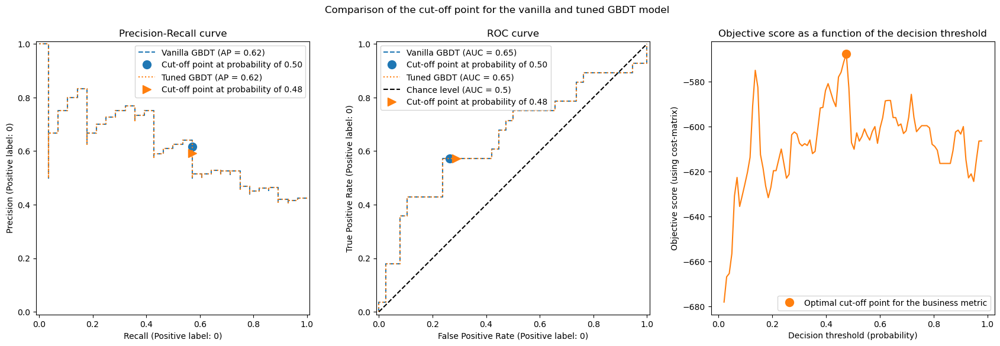

In [3346]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_3v45TT2, tuned_model_3v45TT2, title=title)

In [3347]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_3v45TT2, X_test_3v45TT2, y_test_3v45TT2)}")

[[27 11]
 [12 16]]
Business defined metric: -786


In [3348]:
sum(y_test_3v45TT2==0)

28

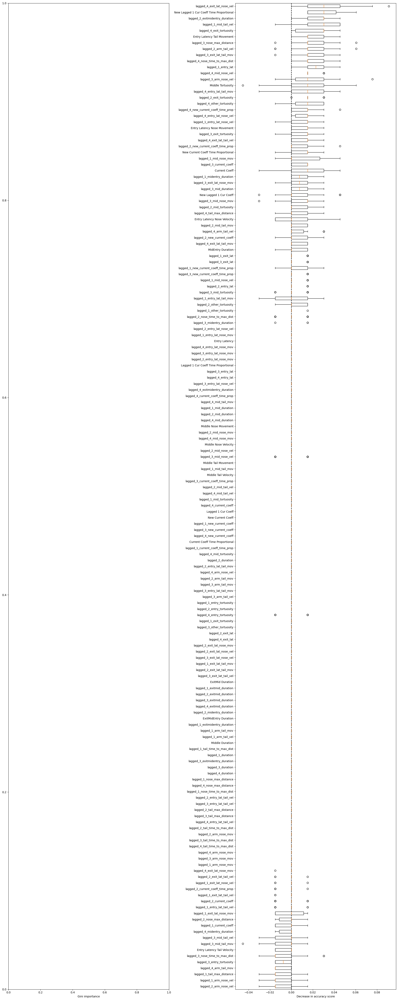

In [3349]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_3v45TT2, X_test_3v45TT2, y_test_3v45TT2, x_main_3v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _3(111), _4(100) - are 2s distinguishable from 3s and 4s?

In [3358]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [3359]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [3360]:
grouped_lagged_added_stats_ri_34 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==3)|(grouped_lagged_added_stats_ri['Choice Output']==4)]

In [3361]:
grouped_lagged_added_stats_ri_34['Binary']=1

In [3362]:
grouped_lagged_binary2v34 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_34])

In [3363]:
grouped_lagged_binary2v34_ri = grouped_lagged_binary2v34.reset_index(drop=True)

In [3366]:
x_main_2v34= grouped_lagged_binary2v34_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',

                                                          
      'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 
        'lagged_4_new_current_coeff',                                       
        'lagged_4_current_coeff_time_prop',                                         
         
       'lagged_4_new_current_coeff_time_prop',                                            
       
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration',                                                        
                                                          
                                                          
        'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                            
          'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                            
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',                                                
          'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff','Lagged 1 Cur Coeff Time Proportional', 'New Lagged 1 Cur Coeff Time Proportional'                                                ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [3367]:
x_main_2v34.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'lagged_3_mid_duration', 'Middle Nose Movement',
       'lagged_1_mid_nose_mov', 'lagged_2_mid_nose_mov',
       'lagged_3_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'lagged_2_mid_tail_mov',
       'lagged_3_mid_tail_mov', 'Middle Tail Velocity',
       'lagged_1_mid_tail_vel', 'lagged_2_mid_tail_vel',
       'lagged_3_mid_tail_vel', 'Middle Tortuosity', 'lagged_1_mid_tortuosity',
       'lagged_2_mid_tortuosity', 'lagged_3_mid_tortuosity', 'Current Coeff',
       'lagged_1_current_coeff', 'lagged_2_current_coeff',
       'lagged_3_current_coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'lagged_2_new_current_coeff',
       'lagged_3_new_current_coeff', 'Current Coeff Time Proportional',
       'lagged_1_current_coeff_time_prop', 'lagged_2_current_c

In [3368]:
x_2v34 = x_main_2v34.values

In [3369]:
y_2v34 = grouped_lagged_binary2v34_ri['Binary'].values

In [3370]:
X_train_2v34, X_test_2v34, y_train_2v34, y_test_2v34 = train_test_split(x_2v34, y_2v34, test_size=0.2, random_state=4)

In [3395]:
mod_2v34 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.1, validation_fraction=0.1, n_iter_no_change=700, random_state=59)
mod_2v34.fit(X_train_2v34, y_train_2v34)
y_pred_2v34=mod_2v34.predict(X_test_2v34)

In [3396]:
mod_2v34.n_estimators_

701

In [3397]:
target_names = ['0', '1']

In [3398]:
f1_sc_2v34 = f1_score(y_test_2v34, y_pred_2v34, average = 'weighted')
f1_sc_2v34

0.7005837359098229

In [3399]:
p_sc_2v34 = precision_score(y_test_2v34, y_pred_2v34, average = 'weighted')
p_sc_2v34

0.6745275888133031

In [3400]:
cf_matrix_2v34 = confusion_matrix(y_test_2v34, y_pred_2v34)
cf_matrix_2v34

array([[ 1, 10],
       [ 4, 39]], dtype=int64)

In [ ]:
print(classification_report(y_test_2v34, y_pred_2v34, target_names=target_names))

In [ ]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_2v34, X_test_2v34, y_test_2v34, x_main_2v34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [3429]:
X_train_2v34TT2, X_test_2v34TT2, y_train_2v34TT2, y_test_2v34TT2 = train_test_split(x_2v34, y_2v34, stratify=y_2v34, random_state=5)

In [3430]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [3431]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [3432]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [3433]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [3478]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -1],  # -1 gain for false positives (when a high is classified as low)
            [-4, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [3503]:
mod_2v34TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.055, validation_fraction=0.1, n_iter_no_change=600, random_state=5)

In [3504]:
mod_2v34TT2.fit(X_train_2v34TT2, y_train_2v34TT2)

GradientBoostingClassifier(learning_rate=0.055, n_estimators=1000,
                           n_iter_no_change=600, random_state=5)

[[50  3]
 [14  0]]


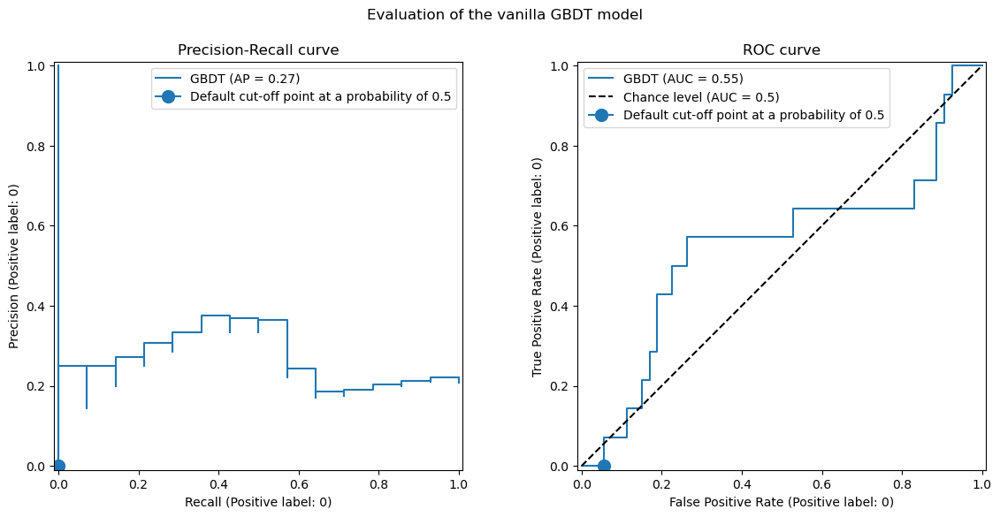

In [3505]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2),
    scoring["precision"](mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_2v34TT2,
    X_test_2v34TT2,
    y_test_2v34TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2),
    scoring["tpr"](mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [3506]:
sum(y_test_2v34TT2==1)

53

In [3507]:
print(f"Business defined metric: {scoring['credit_gain'](mod_2v34TT2, X_test_2v34TT2, y_test_2v34TT2)}")

[[50  3]
 [14  0]]
Business defined metric: -59


In [3508]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [3509]:
tuned_model_2v34TT2 = TunedThresholdClassifierCV(
    estimator=mod_2v34TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_2v34TT2.fit(X_train_2v34TT2, y_train_2v34TT2)
print(f"{tuned_model_2v34TT2.best_threshold_=:0.2f}")

[[ 0 32]
 [ 0  9]]
[[15 17]
 [ 4  5]]
[[22 10]
 [ 5  4]]
[[22 10]
 [ 5  4]]
[[22 10]
 [ 5  4]]
[[22 10]
 [ 6  3]]
[[23  9]
 [ 6  3]]
[[23  9]
 [ 6  3]]
[[23  9]
 [ 6  3]]
[[23  9]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[24  8]
 [ 6  3]]
[[25  7]
 [ 6  3]]
[[25  7]
 [ 6  3]]
[[25  7]
 [ 6  3]]
[[27  5]
 [ 6  3]]
[[27  5]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[28  4]
 [ 7  2]]
[[29  3]
 [ 7  2]]
[[29  3]
 [ 7  2]]
[[29  3]
 [ 7  2]]
[[29  3]
 [ 7  2]]
[[29  3]
 [ 7  2]]
[[29  3]
 [ 8  1]]
[[29  3]
 [ 8  1]]
[[29  3]
 [ 

In [3510]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_2v34TT2,
            y_test_2v34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_2v34TT2, y_test_2v34TT2),
            scoring["precision"](est, X_test_2v34TT2, y_test_2v34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_2v34TT2,
            y_test_2v34TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_2v34TT2, y_test_2v34TT2),
            scoring["tpr"](est, X_test_2v34TT2, y_test_2v34TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[50  3]
 [14  0]]
[[37 16]
 [ 6  8]]


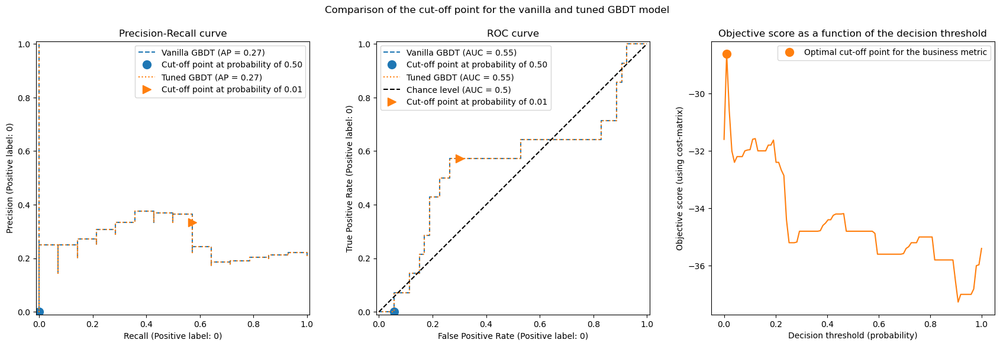

In [3511]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_2v34TT2, tuned_model_2v34TT2, title=title)

In [3512]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_2v34TT2, X_test_2v34TT2, y_test_2v34TT2)}")

[[37 16]
 [ 6  8]]
Business defined metric: -40


In [3513]:
sum(y_test_2v34TT2==0)

14

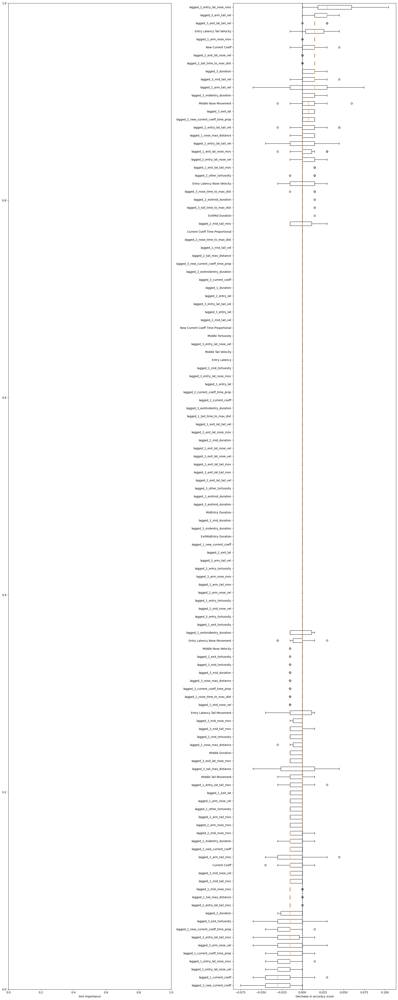

In [3514]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_2v34TT2, X_test_2v34TT2, y_test_2v34TT2, x_main_2v34,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

# _2(57) vs _3(111) _4(100), _5(51) - are 2s distinguishable from 3s, 4s and 5s?

In [5074]:
grouped_lagged_added_stats_ri_2 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==2]

In [5075]:
grouped_lagged_added_stats_ri_2['Binary']=0

In [5076]:
grouped_lagged_added_stats_ri_345 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']>2]

In [5077]:
grouped_lagged_added_stats_ri_345['Binary']=1

In [5078]:
grouped_lagged_binary2v345 = pd.concat([grouped_lagged_added_stats_ri_2, grouped_lagged_added_stats_ri_345])

In [5079]:
grouped_lagged_binary2v345_ri = grouped_lagged_binary2v345.reset_index(drop=True)

In [5080]:
x_main_2v345= grouped_lagged_binary2v345_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',     

           'lagged_4_mid_duration', 
       'lagged_4_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_4_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_4_current_coeff', 
        'lagged_4_new_current_coeff',                                       
        'lagged_4_current_coeff_time_prop',                                         
         
       'lagged_4_new_current_coeff_time_prop',                                            
       
       'lagged_4_entry_lat', 'lagged_4_entry_lat_nose_mov',
       'lagged_4_entry_lat_nose_vel', 'lagged_4_entry_lat_tail_mov',
       'lagged_4_entry_lat_tail_vel', 'lagged_4_duration',
       'lagged_4_nose_max_distance', 'lagged_4_nose_time_to_max_dist',
       'lagged_4_tail_max_distance', 'lagged_4_tail_time_to_max_dist',                                         
       'lagged_4_arm_nose_mov', 'lagged_4_arm_nose_vel',                                                 
        'lagged_4_arm_tail_mov', 'lagged_4_arm_tail_vel',
       'lagged_4_entry_tortuosity', 'lagged_4_exit_tortuosity',
       'lagged_4_other_tortuosity', 'lagged_4_exit_lat',
       'lagged_4_exit_lat_nose_mov', 'lagged_4_exit_lat_nose_vel',
       'lagged_4_exit_lat_tail_mov', 'lagged_4_exit_lat_tail_vel',
       'lagged_4_exitmid_duration', 'lagged_4_midentry_duration',
       'lagged_4_exitmidentry_duration',                                           

           'lagged_3_mid_duration', 
       'lagged_3_mid_nose_mov', 'lagged_4_mid_nose_vel', 
       'lagged_3_mid_tail_mov', 'lagged_4_mid_tail_vel', 'lagged_4_mid_tortuosity',                                              
         'lagged_3_current_coeff', 
        'lagged_3_new_current_coeff',                                       
        'lagged_3_current_coeff_time_prop',                                         
         
       'lagged_3_new_current_coeff_time_prop',                                            
       
       'lagged_3_entry_lat', 'lagged_3_entry_lat_nose_mov',
       'lagged_3_entry_lat_nose_vel', 'lagged_3_entry_lat_tail_mov',
       'lagged_3_entry_lat_tail_vel', 'lagged_3_duration',
       'lagged_3_nose_max_distance', 'lagged_3_nose_time_to_max_dist',
       'lagged_3_tail_max_distance', 'lagged_3_tail_time_to_max_dist',                                         
       'lagged_3_arm_nose_mov', 'lagged_3_arm_nose_vel',                                                 
        'lagged_3_arm_tail_mov', 'lagged_3_arm_tail_vel',
       'lagged_3_entry_tortuosity', 'lagged_3_exit_tortuosity',
       'lagged_3_other_tortuosity', 'lagged_3_exit_lat',
       'lagged_3_exit_lat_nose_mov', 'lagged_3_exit_lat_nose_vel',
       'lagged_3_exit_lat_tail_mov', 'lagged_3_exit_lat_tail_vel',
       'lagged_3_exitmid_duration', 'lagged_3_midentry_duration',
       'lagged_3_exitmidentry_duration',                                                              
          'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                            
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',                                                
       'Lagged 1 Cur Coeff','New Lagged 1 Cur Coeff','Lagged 1 Cur Coeff Time Proportional', 'New Lagged 1 Cur Coeff Time Proportional' ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [5081]:
x_main_2v345.columns[:100]

Index(['Middle Duration', 'lagged_1_mid_duration', 'lagged_2_mid_duration',
       'Middle Nose Movement', 'lagged_1_mid_nose_mov',
       'lagged_2_mid_nose_mov', 'Middle Nose Velocity',
       'lagged_1_mid_nose_vel', 'lagged_2_mid_nose_vel',
       'lagged_3_mid_nose_vel', 'Middle Tail Movement',
       'lagged_1_mid_tail_mov', 'lagged_2_mid_tail_mov',
       'Middle Tail Velocity', 'lagged_1_mid_tail_vel',
       'lagged_2_mid_tail_vel', 'lagged_3_mid_tail_vel', 'Middle Tortuosity',
       'lagged_1_mid_tortuosity', 'lagged_2_mid_tortuosity',
       'lagged_3_mid_tortuosity', 'Current Coeff', 'lagged_1_current_coeff',
       'lagged_2_current_coeff', 'New Current Coeff',
       'lagged_1_new_current_coeff', 'lagged_2_new_current_coeff',
       'Current Coeff Time Proportional', 'lagged_1_current_coeff_time_prop',
       'lagged_2_current_coeff_time_prop',
       'New Current Coeff Time Proportional',
       'lagged_1_new_current_coeff_time_prop',
       'lagged_2_new_current_coeff_

In [5082]:
x_2v345 = x_main_2v345.values

In [5083]:
y_2v345 = grouped_lagged_binary2v345_ri['Binary'].values

In [5084]:
X_train_2v345, X_test_2v345, y_train_2v345, y_test_2v345 = train_test_split(x_2v345, y_2v345, test_size=0.2, random_state=4)

In [5091]:
mod_2v345 =  GradientBoostingClassifier(n_estimators=10000, learning_rate = 0.01515, validation_fraction=0.1, n_iter_no_change=5000, random_state=5, max_depth = None)
mod_2v345.fit(X_train_2v345, y_train_2v345)
y_pred_2v345=mod_2v345.predict(X_test_2v345)

In [5092]:
mod_2v345.n_estimators_

5001

In [5093]:
target_names = ['0', '1']

In [5094]:
f1_sc_2v345 = f1_score(y_test_2v345, y_pred_2v345, average = 'weighted')
f1_sc_2v345

0.61413706025775

In [5095]:
p_sc_2v345 = precision_score(y_test_2v345, y_pred_2v345, average = 'weighted')
p_sc_2v345

0.6190901360544218

In [5096]:
cf_matrix_2v345 = confusion_matrix(y_test_2v345, y_pred_2v345)
cf_matrix_2v345

array([[ 2, 12],
       [13, 37]], dtype=int64)

In [5056]:
print(classification_report(y_test_2v345, y_pred_2v345, target_names=target_names))

              precision    recall  f1-score   support

           0       0.30      0.21      0.25        14
           1       0.80      0.86      0.83        50

    accuracy                           0.72        64
   macro avg       0.55      0.54      0.54        64
weighted avg       0.69      0.72      0.70        64



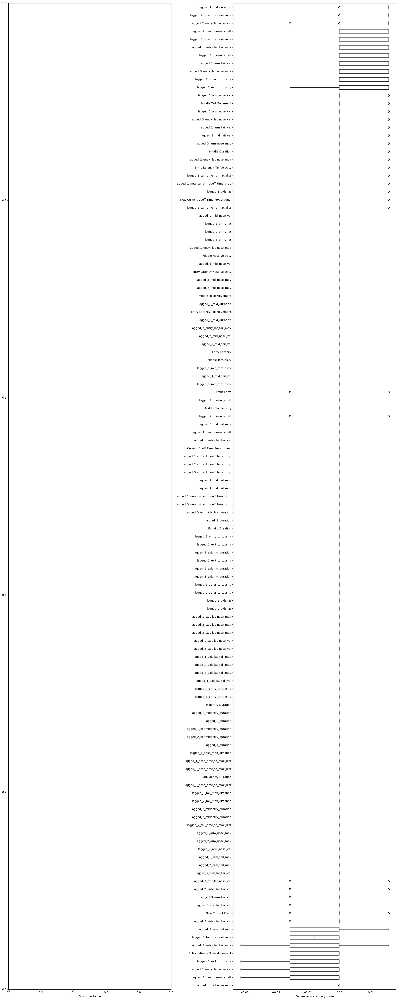

In [5049]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_2v345, X_test_2v345, y_test_2v345, x_main_2v345,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [5097]:
X_train_2v345TT2, X_test_2v345TT2, y_train_2v345TT2, y_test_2v345TT2 = train_test_split(x_2v345, y_2v345, stratify=y_2v345, random_state=5)

In [5098]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [5099]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [5100]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [5101]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [5102]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -15],  # -1 gain for false positives (when a high is classified as low)
            [-61, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [5110]:
mod_2v345TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.005, validation_fraction=0.1, n_iter_no_change=500, random_state=11, max_depth=5)

In [5111]:
mod_2v345TT2.fit(X_train_2v345TT2, y_train_2v345TT2)

GradientBoostingClassifier(learning_rate=0.005, max_depth=5, n_estimators=1000,
                           n_iter_no_change=500, random_state=11)

[[64  2]
 [14  0]]


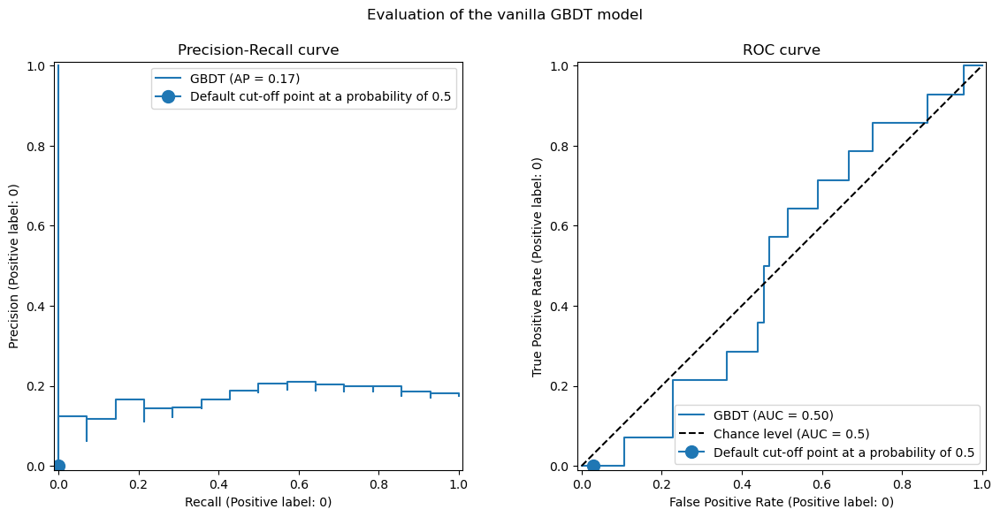

In [5112]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2),
    scoring["precision"](mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_2v345TT2,
    X_test_2v345TT2,
    y_test_2v345TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2),
    scoring["tpr"](mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [4571]:
sum(y_test_2v345TT2==1)

66

In [4572]:
print(f"Business defined metric: {scoring['credit_gain'](mod_2v345TT2, X_test_2v345TT2, y_test_2v345TT2)}")

[[66  0]
 [14  0]]
Business defined metric: -854


In [4573]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [4574]:
tuned_model_2v345TT2 = TunedThresholdClassifierCV(
    estimator=mod_2v345TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_2v345TT2.fit(X_train_2v345TT2, y_train_2v345TT2)
print(f"{tuned_model_2v345TT2.best_threshold_=:0.2f}")

[[ 0 40]
 [ 0  8]]
[[ 2 38]
 [ 1  7]]
[[ 6 34]
 [ 1  7]]
[[11 29]
 [ 1  7]]
[[14 26]
 [ 1  7]]
[[15 25]
 [ 4  4]]
[[18 22]
 [ 5  3]]
[[18 22]
 [ 5  3]]
[[22 18]
 [ 6  2]]
[[23 17]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[24 16]
 [ 6  2]]
[[25 15]
 [ 6  2]]
[[27 13]
 [ 6  2]]
[[27 13]
 [ 7  1]]
[[29 11]
 [ 7  1]]
[[29 11]
 [ 7  1]]
[[30 10]
 [ 7  1]]
[[30 10]
 [ 8  0]]
[[30 10]
 [ 8  0]]
[[30 10]
 [ 8  0]]
[[30 10]
 [ 8  0]]
[[30 10]
 [ 8  0]]
[[32  8]
 [ 8  0]]
[[32  8]
 [ 8  0]]
[[32  8]
 [ 8  0]]
[[32  8]
 [ 8  0]]
[[32  8]
 [ 8  0]]
[[33  7]
 [ 8  0]]
[[33  7]
 [ 8  0]]
[[34  6]
 [ 8  0]]
[[34  6]
 [ 8  0]]
[[34  6]
 [ 8  0]]
[[34  6]
 [ 8  0]]
[[34  6]
 [ 8  0]]
[[35  5]
 [ 8  0]]
[[35  5]
 [ 8  0]]
[[35  5]
 [ 8  0]]
[[35  5]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 8  0]]
[[36  4]
 [ 

In [4575]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_2v345TT2,
            y_test_2v345TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_2v345TT2, y_test_2v345TT2),
            scoring["precision"](est, X_test_2v345TT2, y_test_2v345TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_2v345TT2,
            y_test_2v345TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_2v345TT2, y_test_2v345TT2),
            scoring["tpr"](est, X_test_2v345TT2, y_test_2v345TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

[[66  0]
 [14  0]]
[[15 51]
 [ 2 12]]


C:\Users\Josue Regalado\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


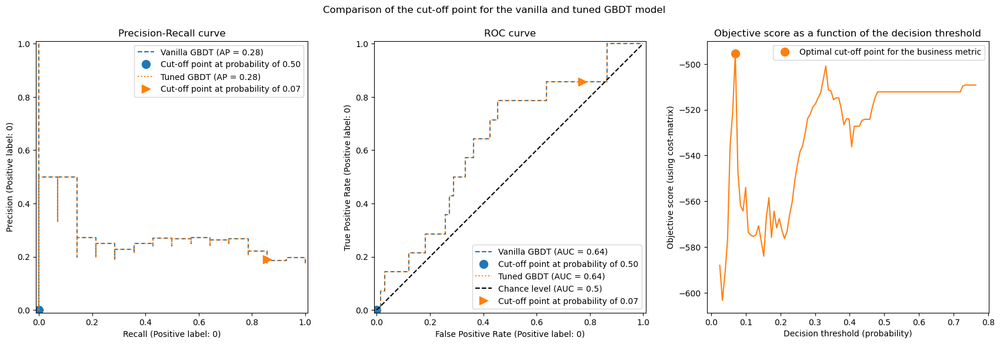

In [4576]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_2v345TT2, tuned_model_2v345TT2, title=title)

In [4577]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_2v345TT2, X_test_2v345TT2, y_test_2v345TT2)}")

[[15 51]
 [ 2 12]]
Business defined metric: -887


In [4505]:
sum(y_test_2v345TT2==0)

14

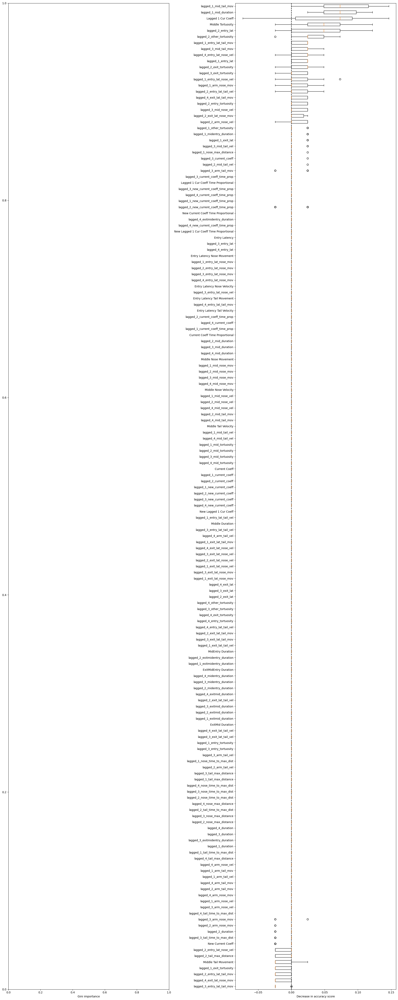

In [4506]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_35TT2, X_test_35TT2, y_test_35TT2, x_main_35,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
grouped_lagged_added_stats_ri_3 = grouped_lagged_added_stats_ri.iloc[:,:][grouped_lagged_added_stats_ri['Choice Output']==3]

In [ ]:
grouped_lagged_added_stats_ri_3['Binary']=0

In [ ]:
grouped_lagged_added_stats_ri_45 = grouped_lagged_added_stats_ri.iloc[:,:][(grouped_lagged_added_stats_ri['Choice Output']==5)|(grouped_lagged_added_stats_ri['Choice Output']==4)]

In [ ]:
grouped_lagged_added_stats_ri_45['Binary']=1

In [ ]:
grouped_lagged_binary3v45 = pd.concat([grouped_lagged_added_stats_ri_3, grouped_lagged_added_stats_ri_45])

In [ ]:
grouped_lagged_binary3v45_ri = grouped_lagged_binary3v45.reset_index(drop=True)

In [ ]:
x_main_3v45= grouped_lagged_binary3v45_ri.drop(columns = ['Choice Output', 'Duration', 'Exit Latency', 
        'Nose Max Distance', 'Nose Time to Max Dist', 'Tail Base Max Distance', 'Tail Base Time to Max Dist', 'Entry Tortuosity', 'Exit Tortuosity',
        'Other Tortuosity', 'Arm Nose Movement', 'Arm Nose Velocity', 'Arm Tail Movement', 'Arm Tail Velocity',
       
        'lagged_1_lagged_1_cur_coeff',
       'lagged_2_lagged_1_cur_coeff', 'lagged_3_lagged_1_cur_coeff',
       'lagged_4_lagged_1_cur_coeff',
       'lagged_1_lagged_2_cur_coeff', 'lagged_2_lagged_2_cur_coeff',
       'lagged_3_lagged_2_cur_coeff', 'lagged_4_lagged_2_cur_coeff',
       'lagged_1_lagged_3_cur_coeff',
       'lagged_2_lagged_3_cur_coeff', 'lagged_3_lagged_3_cur_coeff',
       'lagged_4_lagged_3_cur_coeff', 
       'lagged_1_lagged_4_cur_coeff', 'lagged_2_lagged_4_cur_coeff',
       'lagged_3_lagged_4_cur_coeff', 'lagged_4_lagged_4_cur_coeff',
       
       
       'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop',
       'lagged_3_lagged_1_cur_coeff_time_prop',
       'lagged_4_lagged_1_cur_coeff_time_prop',
       
       'lagged_1_lagged_2_cur_coeff_time_prop',
       'lagged_2_lagged_2_cur_coeff_time_prop',
       'lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop',
       
       'lagged_1_lagged_3_cur_coeff_time_prop',
       'lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop',
       'lagged_4_lagged_3_cur_coeff_time_prop',
       
       'lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop',
       'lagged_3_lagged_4_cur_coeff_time_prop',
       'lagged_4_lagged_4_cur_coeff_time_prop',
                                                                                                             
                                                                                                             
        'lagged_1_lagged_1_cur_coeff_time_prop',
       'lagged_2_lagged_1_cur_coeff_time_prop','lagged_3_lagged_1_cur_coeff_time_prop','lagged_4_lagged_1_cur_coeff_time_prop',
       'lagged_1_lagged_2_cur_coeff_time_prop','lagged_2_lagged_2_cur_coeff_time_prop','lagged_3_lagged_2_cur_coeff_time_prop',
       'lagged_4_lagged_2_cur_coeff_time_prop','lagged_1_lagged_3_cur_coeff_time_prop','lagged_2_lagged_3_cur_coeff_time_prop',
       'lagged_3_lagged_3_cur_coeff_time_prop','lagged_4_lagged_3_cur_coeff_time_prop','lagged_1_lagged_4_cur_coeff_time_prop',
       'lagged_2_lagged_4_cur_coeff_time_prop','lagged_3_lagged_4_cur_coeff_time_prop','lagged_4_lagged_4_cur_coeff_time_prop', 
        'Turn', 'lagged_1_turn_ago', 'lagged_2_turn_ago', 'lagged_3_turn_ago', 'lagged_4_turn_ago', 
        '2_cur_arm_duration', '3_cur_arm_duration', '4_cur_arm_duration',
       '5_cur_arm_duration', 'mean_2_cur_arm_duration',
       'mean_3_cur_arm_duration', 'mean_4_cur_arm_duration',
       'mean_5_cur_arm_duration', '2_past_arm_duration', '3_past_arm_duration',
       '4_past_arm_duration', 'mean_2_past_arm_duration',
       'mean_3_past_arm_duration', 'mean_4_past_arm_duration',
       '2_past_mid_duration', '3_past_mid_duration', '4_past_mid_duration',
       '5_past_mid_duration', 'mean_2_past_mid_duration',
       'mean_3_past_mid_duration', 'mean_4_past_mid_duration',
       'mean_5_past_mid_duration', '2_past_exitmid_duration',
       '3_past_exitmid_duration', '4_past_exitmid_duration',
       '5_past_exitmid_duration', 'mean_2_past_exitmid_duration',
       'mean_3_past_exitmid_duration', 'mean_4_past_exitmid_duration',
       'mean_5_past_exitmid_duration', '2_past_midentry_duration',
       '3_past_midentry_duration', '4_past_midentry_duration',
       '5_past_midentry_duration', 'mean_2_past_midentry_duration',
       'mean_3_past_midentry_duration', 'mean_4_past_midentry_duration',
       'mean_5_past_midentry_duration', '2_past_exitmidentry_duration',
       '3_past_exitmidentry_duration', '4_past_exitmidentry_duration',
       '5_past_exitmidentry_duration', 'mean_2_past_exitmidentry_duration',
       'mean_3_past_exitmidentry_duration',
       'mean_4_past_exitmidentry_duration',
       'mean_5_past_exitmidentry_duration',
                                                                                                               
        'lagged_1_choice_ago', 'lagged_2_choice_ago', 'lagged_3_choice_ago',
       'lagged_4_choice_ago',
        'lagged_1_new_lagged_1_cur_coeff',
        'lagged_2_new_lagged_1_cur_coeff', 
        'lagged_3_new_lagged_1_cur_coeff','lagged_4_new_lagged_1_cur_coeff','lagged_1_new_lagged_2_cur_coeff', 'lagged_2_new_lagged_2_cur_coeff', 
        'lagged_3_new_lagged_2_cur_coeff', 'lagged_4_new_lagged_2_cur_coeff','lagged_1_new_lagged_3_cur_coeff','lagged_2_new_lagged_3_cur_coeff', 
        'lagged_3_new_lagged_3_cur_coeff','lagged_4_new_lagged_3_cur_coeff','lagged_1_new_lagged_4_cur_coeff', 'lagged_2_new_lagged_4_cur_coeff',
        'lagged_3_new_lagged_4_cur_coeff', 'lagged_4_new_lagged_4_cur_coeff','lagged_1_new_lagged_1_cur_coeff_time_prop',
       'lagged_2_new_lagged_1_cur_coeff_time_prop','lagged_3_new_lagged_1_cur_coeff_time_prop','lagged_4_new_lagged_1_cur_coeff_time_prop',
       'lagged_1_new_lagged_2_cur_coeff_time_prop','lagged_2_new_lagged_2_cur_coeff_time_prop','lagged_3_new_lagged_2_cur_coeff_time_prop',
       'lagged_4_new_lagged_2_cur_coeff_time_prop','lagged_1_new_lagged_3_cur_coeff_time_prop','lagged_2_new_lagged_3_cur_coeff_time_prop',
       'lagged_3_new_lagged_3_cur_coeff_time_prop','lagged_4_new_lagged_3_cur_coeff_time_prop','lagged_1_new_lagged_4_cur_coeff_time_prop',
       'lagged_2_new_lagged_4_cur_coeff_time_prop','lagged_3_new_lagged_4_cur_coeff_time_prop','lagged_4_new_lagged_4_cur_coeff_time_prop',
        'Exit Latency Nose Movement', 'Exit Latency Nose Velocity', 'Exit Latency Tail Movement', 'Exit Latency Tail Velocity',
       'Lagged 4 Cur Coeff', 
        'New Lagged 4 Cur Coeff',                                          
                                               
         'Lagged 4 Cur Coeff Time Proportional',
          'New Lagged 4 Cur Coeff Time Proportional',                                            
          'Binary',
       'Lagged 2 Cur Coeff',  'New Lagged 2 Cur Coeff', 'Lagged 2 Cur Coeff Time Proportional', 'New Lagged 2 Cur Coeff Time Proportional',                                            
       'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional'                                                
                                                        ])


# 'Lagged 3 Cur Coeff','New Lagged 3 Cur Coeff','Lagged 3 Cur Coeff Time Proportional', 'New Lagged 3 Cur Coeff Time Proportional',


In [ ]:
x_main_3v45.columns[:100]

In [ ]:
x_3v45 = x_main_3v45.values

In [ ]:
y_3v45 = grouped_lagged_binary3v45_ri['Binary'].values

In [ ]:
X_train_3v45, X_test_3v45, y_train_3v45, y_test_3v45 = train_test_split(x_3v45, y_3v45, test_size=0.2, random_state=4)

In [ ]:
mod_3v45 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.015, validation_fraction=0.1, n_iter_no_change=500, random_state=59)
mod_3v45.fit(X_train_3v45, y_train_3v45)
y_pred_3v45=mod_3v45.predict(X_test_3v45)

In [ ]:
mod_3v45.n_estimators_

In [ ]:
target_names = ['0', '1']

In [ ]:
f1_sc_3v45 = f1_score(y_test_3v45, y_pred_3v45, average = 'weighted')
f1_sc_3v45

In [ ]:
p_sc_3v45 = precision_score(y_test_3v45, y_pred_3v45, average = 'weighted')
p_sc_3v45

In [ ]:
cf_matrix_3v45 = confusion_matrix(y_test_3v45, y_pred_3v45)
cf_matrix_3v45

In [ ]:
print(classification_report(y_test_3v45, y_pred_3v45, target_names=target_names))

In [ ]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(mod_3v45, X_test_3v45, y_test_3v45, x_main_3v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')

In [ ]:
# try tuning part2

In [ ]:
X_train_3v45TT2, X_test_3v45TT2, y_train_3v45TT2, y_test_3v45TT2 = train_test_split(x_3v45, y_3v45, stratify=y_3v45, random_state=54)

In [ ]:
pos_label, neg_label = 0,1 # dont want to misclassify lows as highs

In [ ]:
def fpr_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    tn, fp, _, _ = cm.ravel()
    tnr = tn / (tn + fp)
    return 1 - tnr

In [ ]:
from sklearn.metrics import make_scorer, precision_score, recall_score

In [ ]:
tpr_score = recall_score  # TPR and recall are the same metric
scoring = {
    "precision": make_scorer(precision_score, pos_label=pos_label),
    "recall": make_scorer(recall_score, pos_label=pos_label),
    "fpr": make_scorer(fpr_score, neg_label=neg_label, pos_label=pos_label),
    "tpr": make_scorer(tpr_score, pos_label=pos_label),
}

In [ ]:
def credit_gain_score(y, y_pred, neg_label, pos_label):
    cm = confusion_matrix(y, y_pred, labels=[neg_label, pos_label])
    print(cm)
    gain_matrix = np.array(
        [
            [0, -14],  # -1 gain for false positives (when a high is classified as low)
            [-7, 0],  # -5 gain for false negatives (when a low is classified as high)
        ]
    )
    return np.sum(cm * gain_matrix)


scoring["credit_gain"] = make_scorer(
    credit_gain_score, neg_label=neg_label, pos_label=pos_label
)

In [ ]:
mod_3v45TT2 =  GradientBoostingClassifier(n_estimators=1000, learning_rate = 0.00715, validation_fraction=0.1, n_iter_no_change=500, random_state=59)

In [ ]:
mod_3v45TT2.fit(X_train_3v45TT2, y_train_3v45TT2)

In [ ]:
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

PrecisionRecallDisplay.from_estimator(
    mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2, pos_label=pos_label, ax=axs[0], name="GBDT"
)
axs[0].plot(
    scoring["recall"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    scoring["precision"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[0].set_title("Precision-Recall curve")
axs[0].legend()

RocCurveDisplay.from_estimator(
    mod_3v455TT2,
    X_test_3v45TT2,
    y_test_3v45TT2,
    pos_label=pos_label,
    ax=axs[1],
    name="GBDT",
    plot_chance_level=True,
)
axs[1].plot(
    scoring["fpr"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    scoring["tpr"](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2),
    marker="o",
    markersize=10,
    color="tab:blue",
    label="Default cut-off point at a probability of 0.5",
)
axs[1].set_title("ROC curve")
axs[1].legend()
_ = fig.suptitle("Evaluation of the vanilla GBDT model")

In [ ]:
sum(y_test_3v45TT2==1)

In [ ]:
print(f"Business defined metric: {scoring['credit_gain'](mod_3v45TT2, X_test_3v45TT2, y_test_3v45TT2)}")

In [ ]:
from sklearn.model_selection import TunedThresholdClassifierCV

In [ ]:
tuned_model_3v45TT2 = TunedThresholdClassifierCV(
    estimator=mod_3v45TT2,
    scoring=scoring["credit_gain"],
    store_cv_results=True,  # necessary to inspect all results
)
tuned_model_3v45TT2.fit(X_train_3v45TT2, y_train_3v45TT2)
print(f"{tuned_model_3v45TT2.best_threshold_=:0.2f}")

In [ ]:
def plot_roc_pr_curves(vanilla_model, tuned_model, *, title):
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(21, 6))

    linestyles = ("dashed", "dotted")
    markerstyles = ("o", ">")
    colors = ("tab:blue", "tab:orange")
    names = ("Vanilla GBDT", "Tuned GBDT")
    for idx, (est, linestyle, marker, color, name) in enumerate(
        zip((vanilla_model, tuned_model), linestyles, markerstyles, colors, names)
    ):
        decision_threshold = getattr(est, "best_threshold_", 0.5)
        PrecisionRecallDisplay.from_estimator(
            est,
            X_test_3v45TT2,
            y_test_3v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[0],
            name=name,
        )
        axs[0].plot(
            scoring["recall"](est, X_test_3v45TT2, y_test_3v45TT2),
            scoring["precision"](est, X_test_3v45TT2, y_test_3v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )
        RocCurveDisplay.from_estimator(
            est,
            X_test_3v45TT2,
            y_test_3v45TT2,
            pos_label=pos_label,
            linestyle=linestyle,
            color=color,
            ax=axs[1],
            name=name,
            plot_chance_level=idx == 1,
        )
        axs[1].plot(
            scoring["fpr"](est, X_test_3v45TT2, y_test_3v45TT2),
            scoring["tpr"](est, X_test_3v45TT2, y_test_3v45TT2),
            marker,
            markersize=10,
            color=color,
            label=f"Cut-off point at probability of {decision_threshold:.2f}",
        )

    axs[0].set_title("Precision-Recall curve")
    axs[0].legend()
    axs[1].set_title("ROC curve")
    axs[1].legend()

    axs[2].plot(
        tuned_model.cv_results_["thresholds"],
        tuned_model.cv_results_["scores"],
        color="tab:orange",
    )
    axs[2].plot(
        tuned_model.best_threshold_,
        tuned_model.best_score_,
        "o",
        markersize=10,
        color="tab:orange",
        label="Optimal cut-off point for the business metric",
    )
    axs[2].legend()
    axs[2].set_xlabel("Decision threshold (probability)")
    axs[2].set_ylabel("Objective score (using cost-matrix)")
    axs[2].set_title("Objective score as a function of the decision threshold")
    fig.suptitle(title)

In [ ]:
title = "Comparison of the cut-off point for the vanilla and tuned GBDT model"
plot_roc_pr_curves(mod_3v45TT2, tuned_model_3v45TT2, title=title)

In [ ]:
print(f"Business defined metric: {scoring['credit_gain'](tuned_model_3v45TT2, X_test_3v45TT2, y_test_3v45TT2)}")

In [ ]:
sum(y_test_3v45TT2==0)

In [ ]:
#mdi_importances_bin= pd.Series(mod_bin.feature_importances_, index=x_binary_main.columns)
#tree_importance_sorted_idx_bin = np.argsort(mod_bin.feature_importances_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 50))
#mdi_importances_bin.sort_values().plot.barh(ax=ax1)
ax1.set_xlabel("Gini importance")
plot_permutation_importance(tuned_model_3v45TT2, X_test_3v45TT2, y_test_3v45TT2, x_main_3v45,ax2)
ax2.set_xlabel("Decrease in accuracy score")
#fig.suptitle(
#    "Impurity-based vs. permutation importances on multicollinear features (train set)"
#)
_ = fig.tight_layout()


#plt.savefig('Impurity-based_vs_permutation importances.png')